In [5]:
import sys
sys.path.insert(0, '../src')

In [6]:
from classify_attention_patterns import load_model
from argparse import Namespace
from run_glue import load_and_cache_examples, set_seed
from model_bert import BertForSequenceClassification, BertForMaskedLM
from config_bert import BertConfig
from torch.utils.data import DataLoader, RandomSampler, SequentialSampler, TensorDataset
from transformers import BertTokenizer
import numpy as np
import torch
import random
from collections import Counter

def set_seed(seed):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)

In [7]:
head_classifier_model, label2id, min_max_size = load_model("../models/head_classifier/classify_attention_patters.tar")
head_classifier_model = head_classifier_model.eval().cuda()
id2label = {idx:label for label, idx in label2id.items()}

In [8]:
import numpy as np
import pathlib
import matplotlib.pyplot as plt
import time
import torch
import pathlib
import numpy as np
import pathlib
import json
import numpy as np
import time
import matplotlib.pyplot as plt

def plot_matrix(mean_matrix, x_labels, y_labels, save_path, x_title='', y_title='', colour_map=plt.cm.OrRd):
    fig, ax = plt.subplots(figsize=(9,8))
    ax.set_xlabel(x_title, labelpad=20)
    ax.set_ylabel(y_title)
    ax.xaxis.set_ticks_position('top')
    ax.xaxis.set_label_position('top')
    ax.set_xticks(range(len(x_labels)))
    ax.set_yticks(range(len(y_labels)))
    ax.set_xticklabels(x_labels)
    ax.set_yticklabels(y_labels)
    ax.imshow(mean_matrix, cmap=colour_map)
    plt.tight_layout()
    for i in range(len(mean_matrix)):
        for j in range(len(mean_matrix[0])):
            mean = mean_matrix[i, j]
            ax.text(j, i, f"{mean:.2f}", va='center', ha='center')
    if save_path:
        fig.savefig(save_path, bbox_inches='tight')
    plt.show()


CoLA seed_1337 layer 0 head 0
Original Attention Across heads meaned


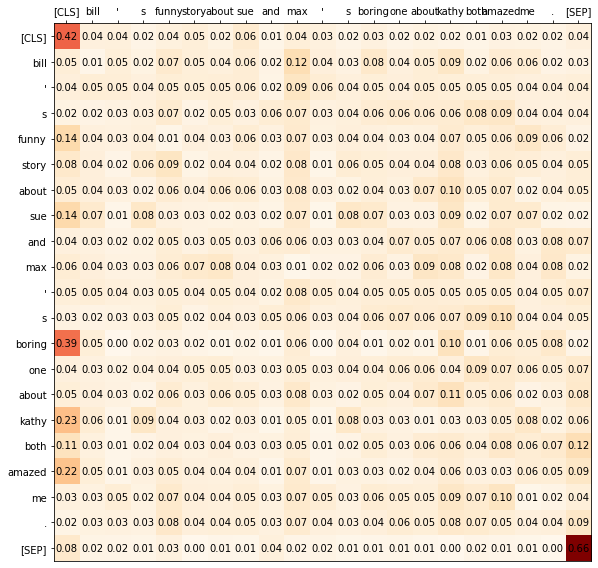

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_1337 layer 0 head 1
Original Attention Across heads meaned


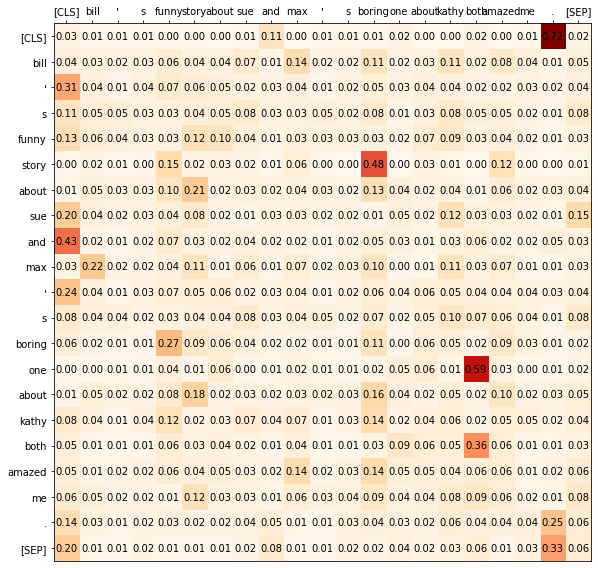

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_1337 layer 0 head 2
Original Attention Across heads meaned


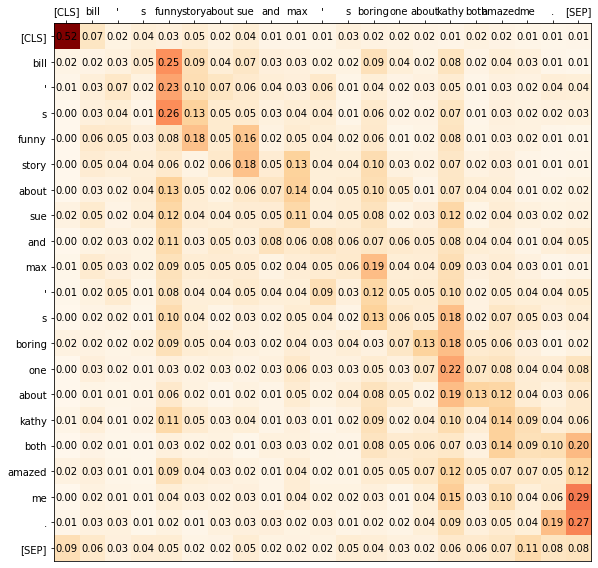

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_1337 layer 0 head 3
Original Attention Across heads meaned


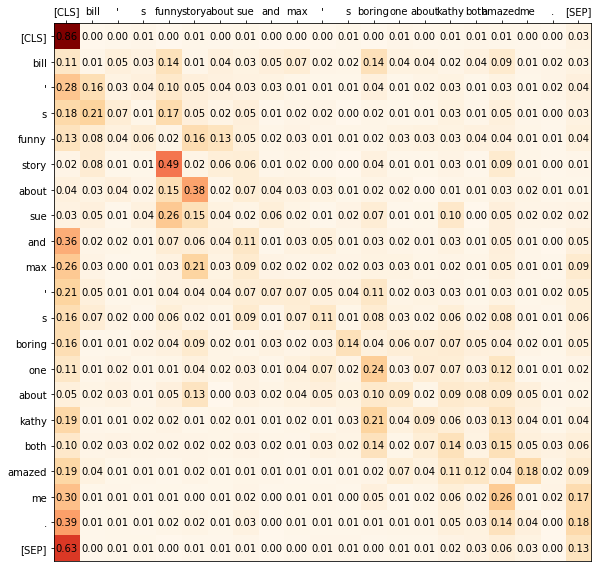

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 1 head 0
Original Attention Across heads meaned


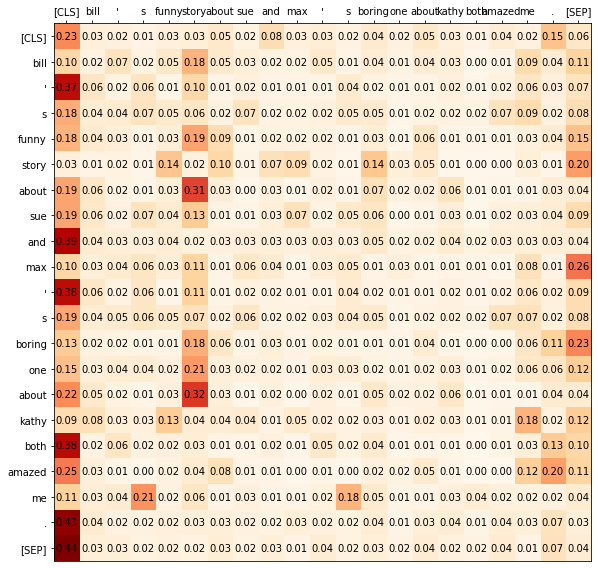

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_1337 layer 1 head 1
Original Attention Across heads meaned


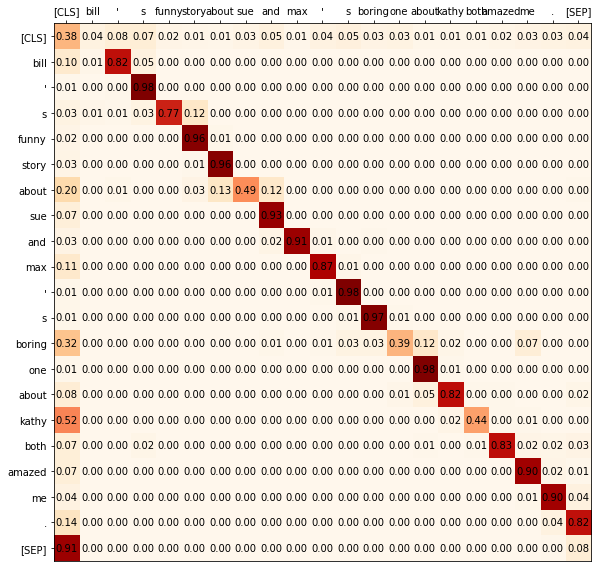

torch.Size([1, 1, 36, 36])
['diagonal']
CoLA seed_1337 layer 1 head 2
Original Attention Across heads meaned


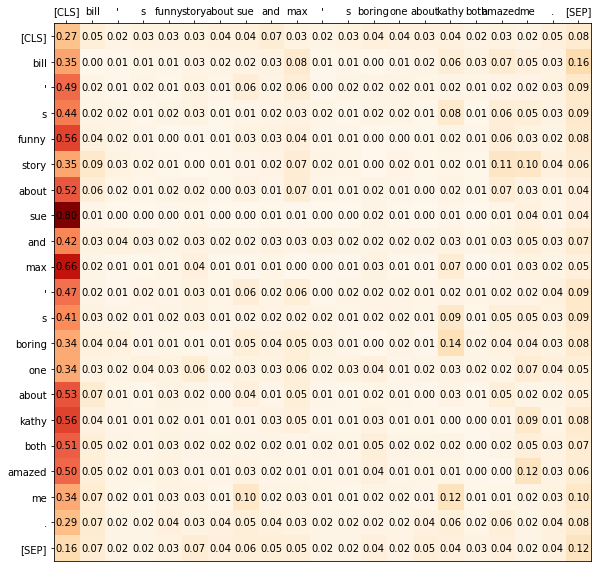

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_1337 layer 1 head 3
Original Attention Across heads meaned


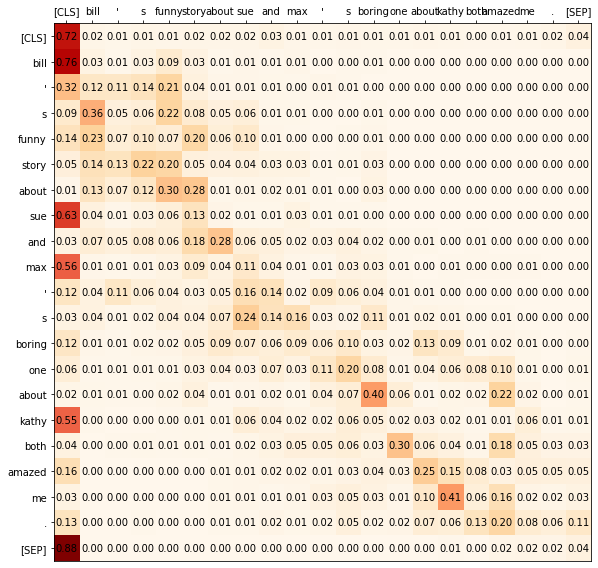

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 1 head 4
Original Attention Across heads meaned


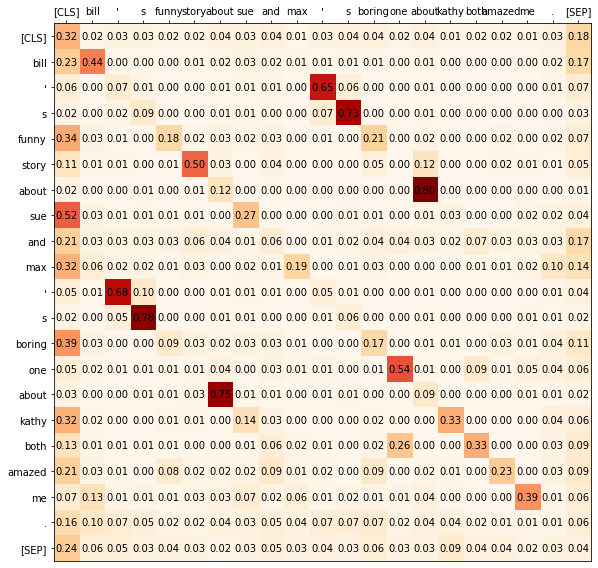

torch.Size([1, 1, 36, 36])
['block']
CoLA seed_1337 layer 2 head 0
Original Attention Across heads meaned


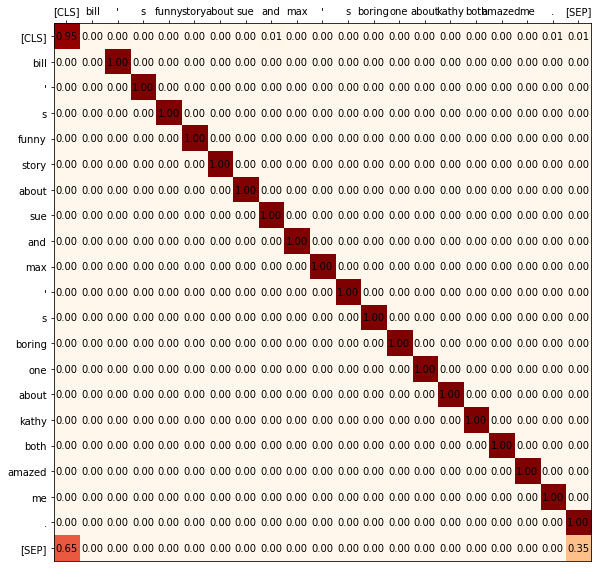

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 2 head 1
Original Attention Across heads meaned


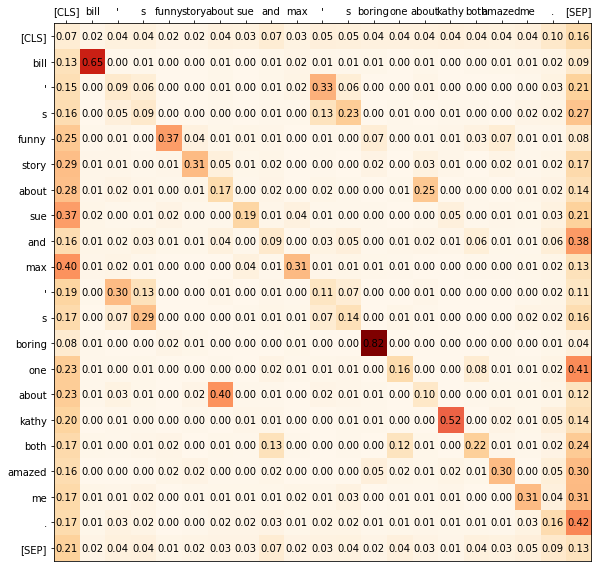

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 3 head 0
Original Attention Across heads meaned


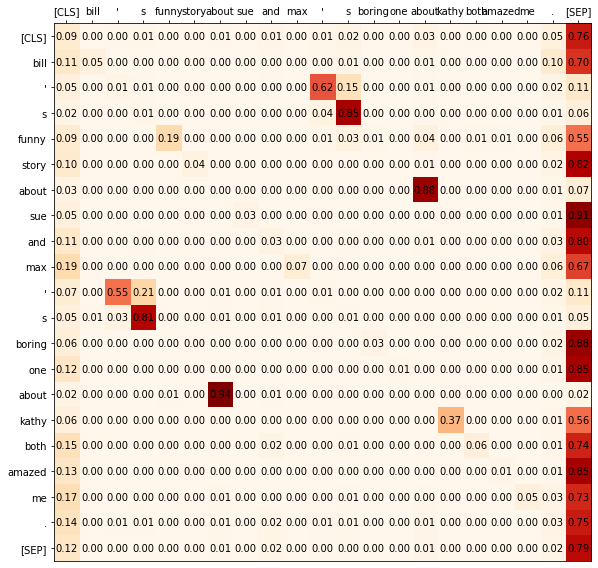

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_1337 layer 3 head 1
Original Attention Across heads meaned


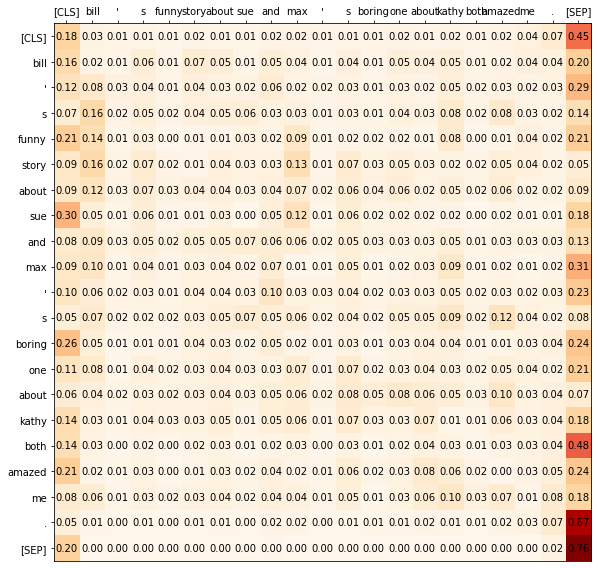

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 3 head 2
Original Attention Across heads meaned


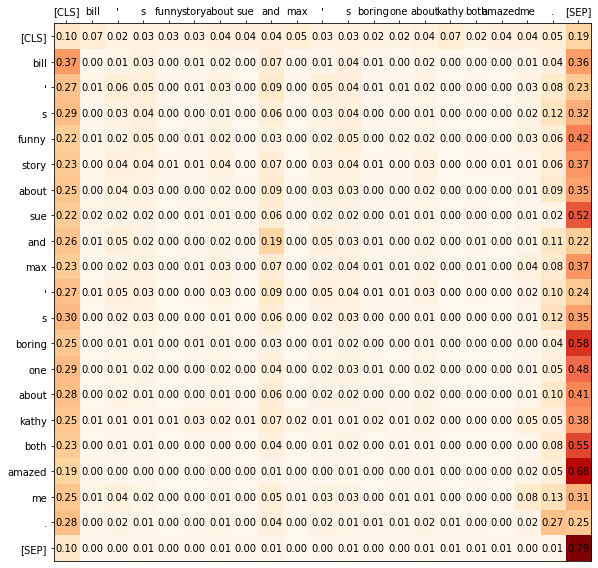

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_1337 layer 3 head 3
Original Attention Across heads meaned


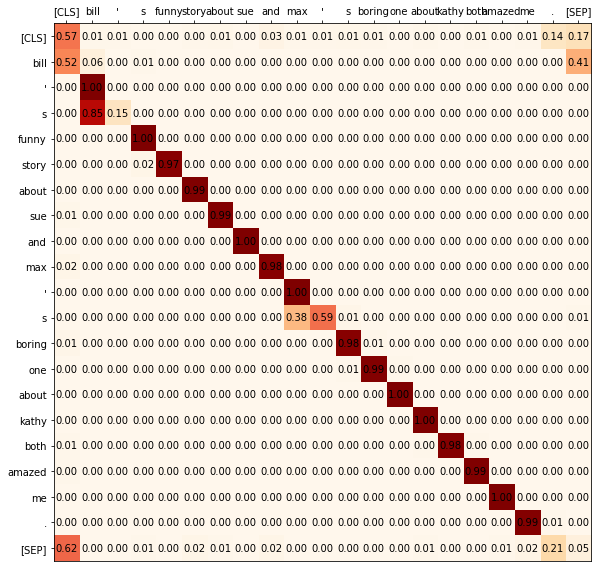

torch.Size([1, 1, 36, 36])
['diagonal']
CoLA seed_1337 layer 3 head 4
Original Attention Across heads meaned


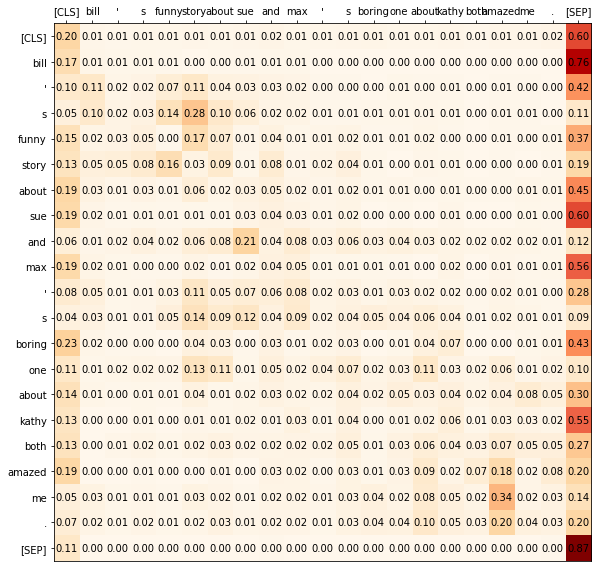

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 4 head 0
Original Attention Across heads meaned


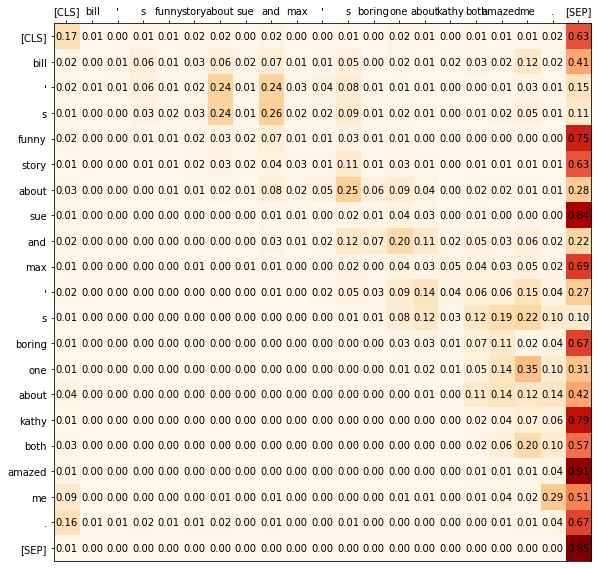

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_1337 layer 4 head 1
Original Attention Across heads meaned


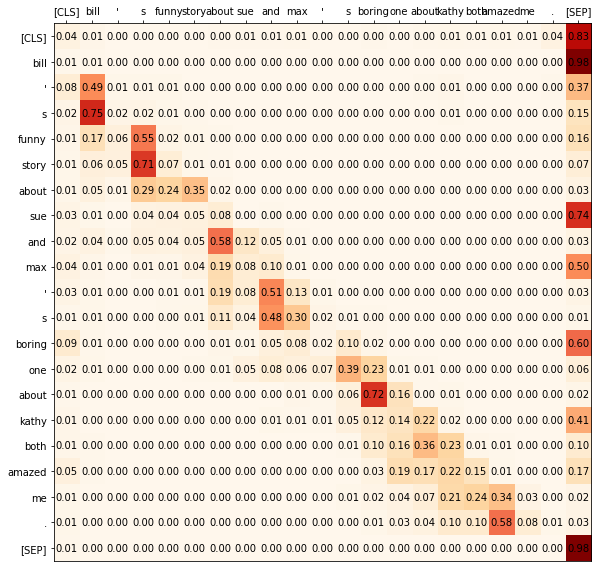

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 5 head 0
Original Attention Across heads meaned


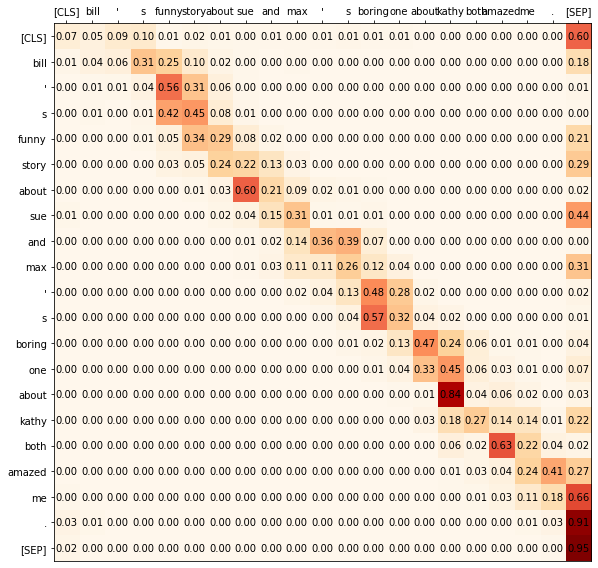

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 5 head 1
Original Attention Across heads meaned


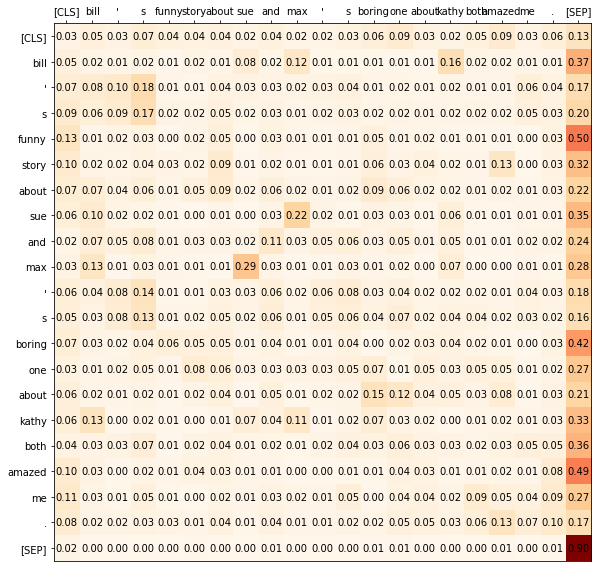

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 5 head 2
Original Attention Across heads meaned


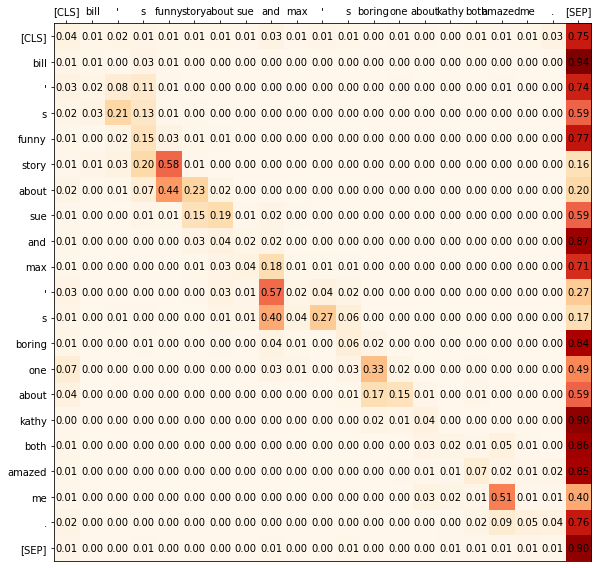

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_1337 layer 5 head 3
Original Attention Across heads meaned


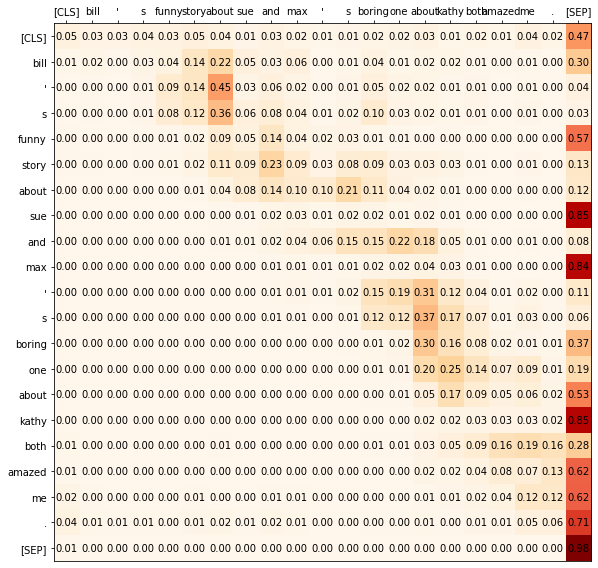

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 5 head 4
Original Attention Across heads meaned


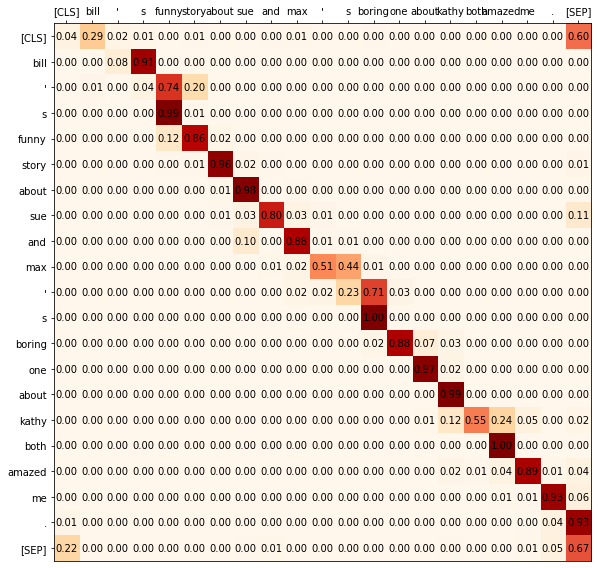

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 6 head 0
Original Attention Across heads meaned


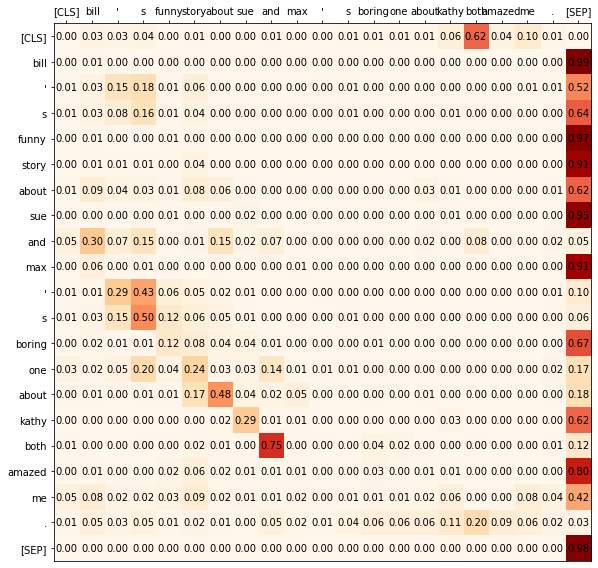

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 6 head 1
Original Attention Across heads meaned


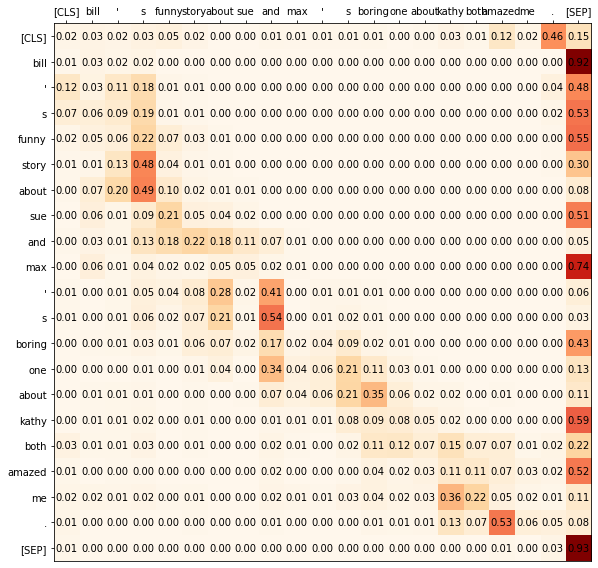

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 6 head 2
Original Attention Across heads meaned


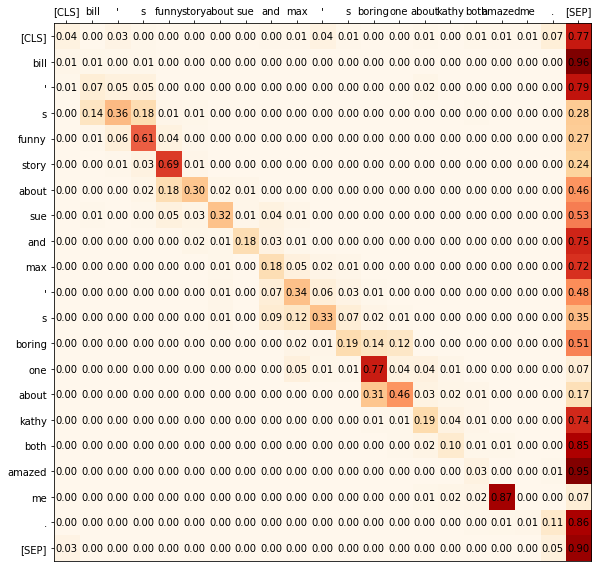

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 6 head 3
Original Attention Across heads meaned


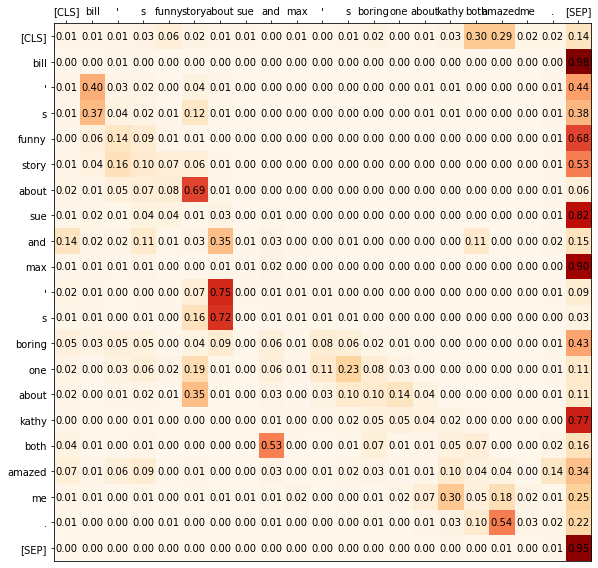

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 7 head 0
Original Attention Across heads meaned


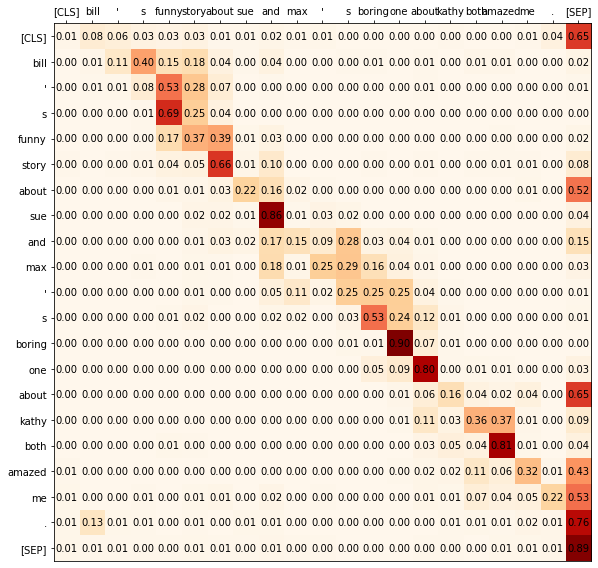

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 7 head 1
Original Attention Across heads meaned


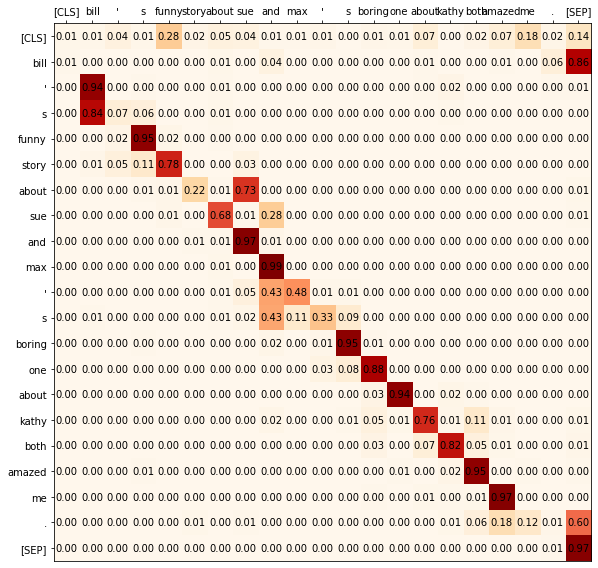

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 7 head 2
Original Attention Across heads meaned


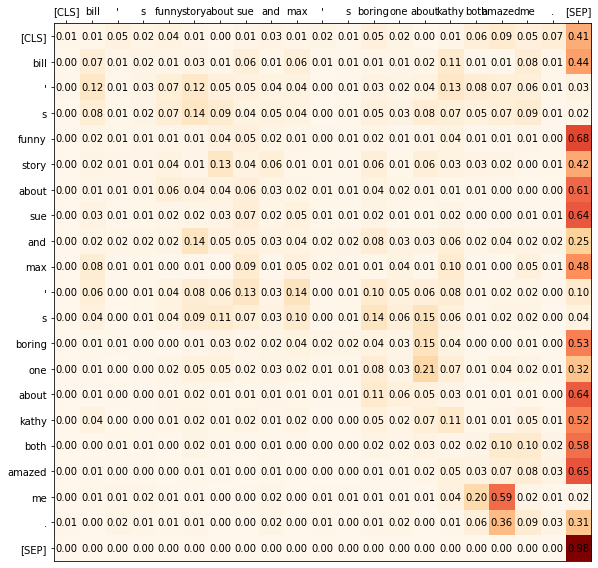

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 7 head 3
Original Attention Across heads meaned


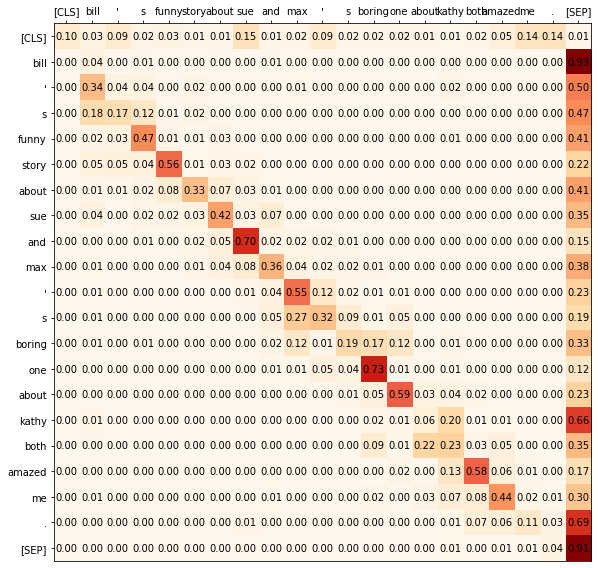

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 8 head 0
Original Attention Across heads meaned


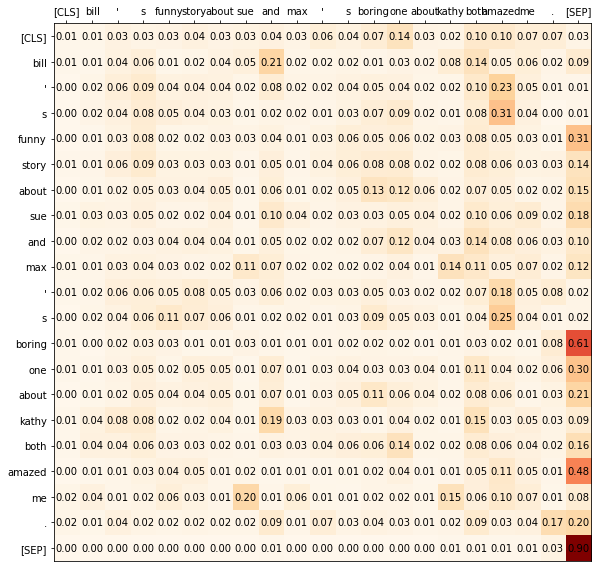

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_1337 layer 10 head 0
Original Attention Across heads meaned


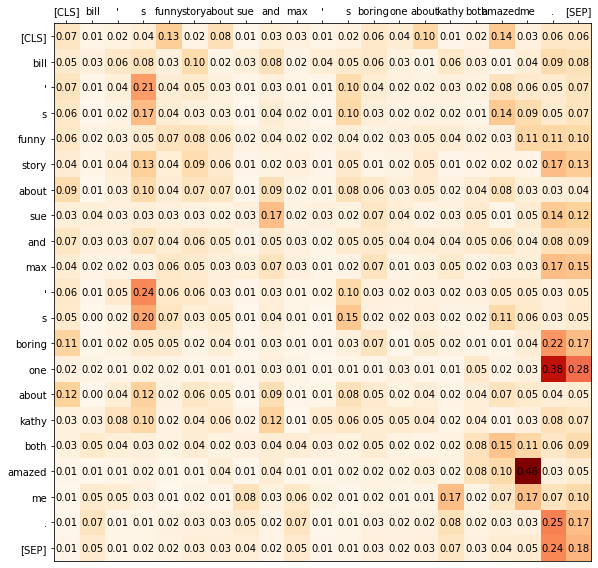

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_1337 layer 10 head 1
Original Attention Across heads meaned


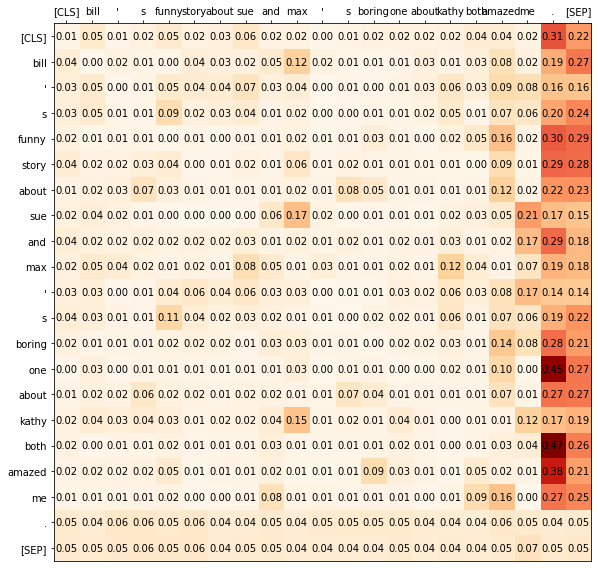

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_42 layer 0 head 0
Original Attention Across heads meaned


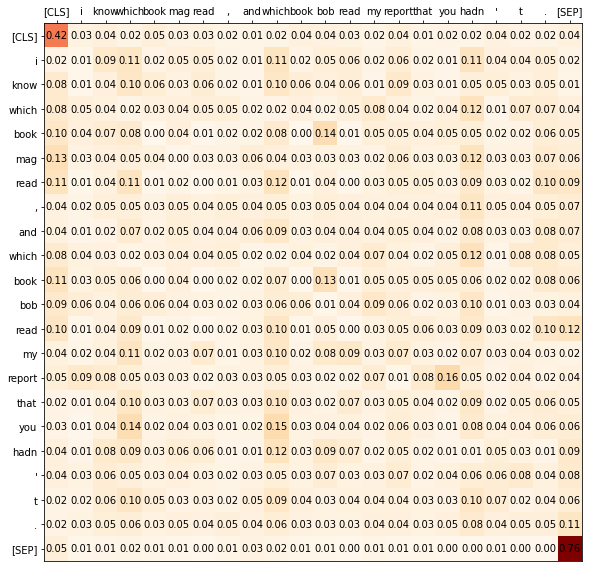

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_42 layer 0 head 1
Original Attention Across heads meaned


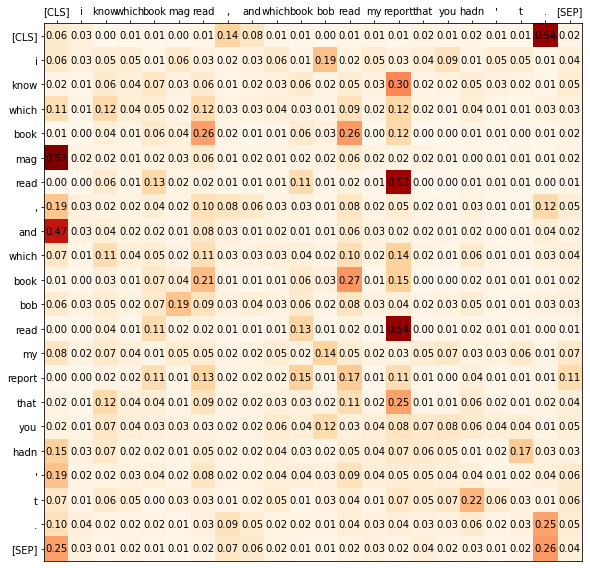

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_42 layer 0 head 2
Original Attention Across heads meaned


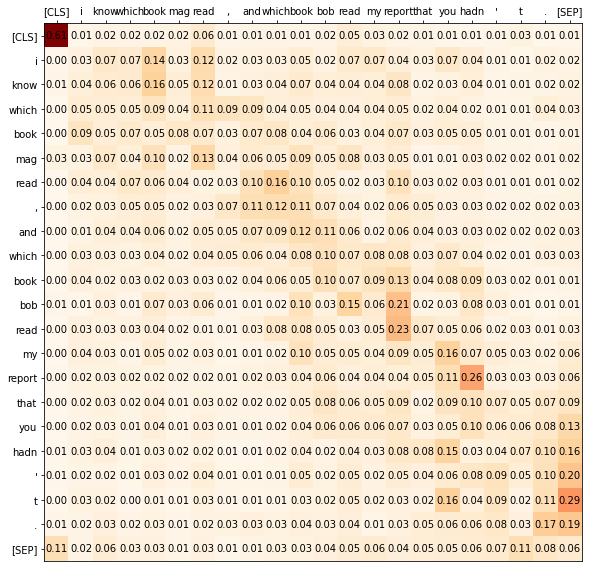

torch.Size([1, 1, 36, 36])
['block']
CoLA seed_42 layer 0 head 3
Original Attention Across heads meaned


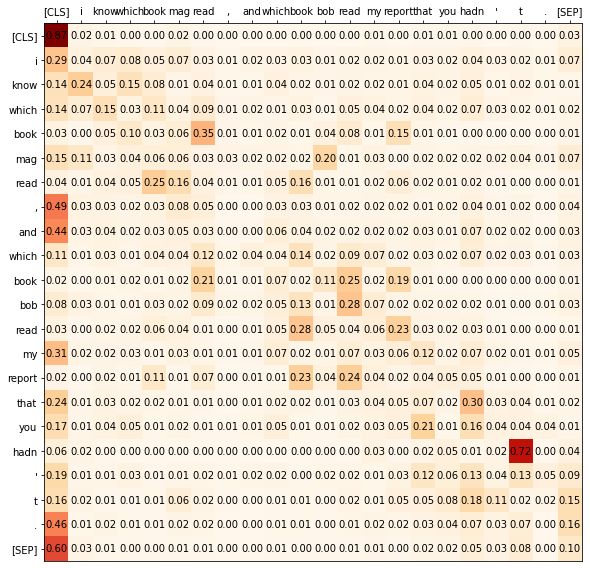

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_42 layer 1 head 0
Original Attention Across heads meaned


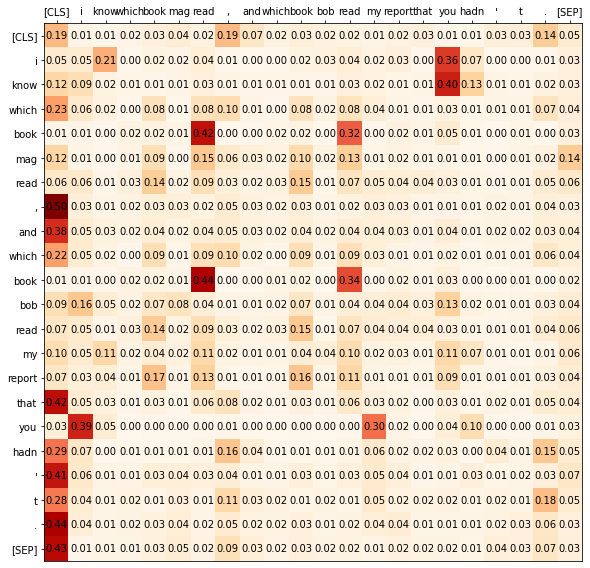

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_42 layer 1 head 1
Original Attention Across heads meaned


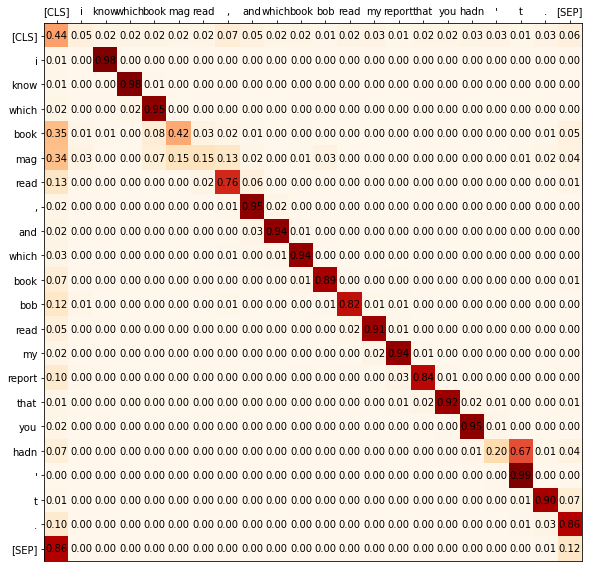

torch.Size([1, 1, 36, 36])
['diagonal']
CoLA seed_42 layer 1 head 2
Original Attention Across heads meaned


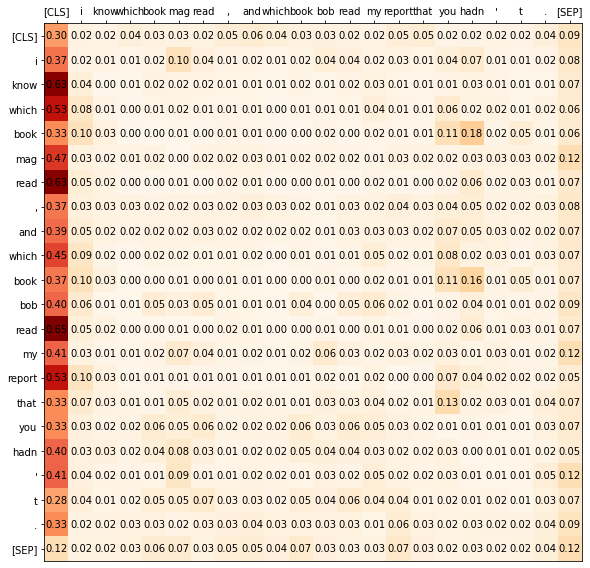

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_42 layer 1 head 3
Original Attention Across heads meaned


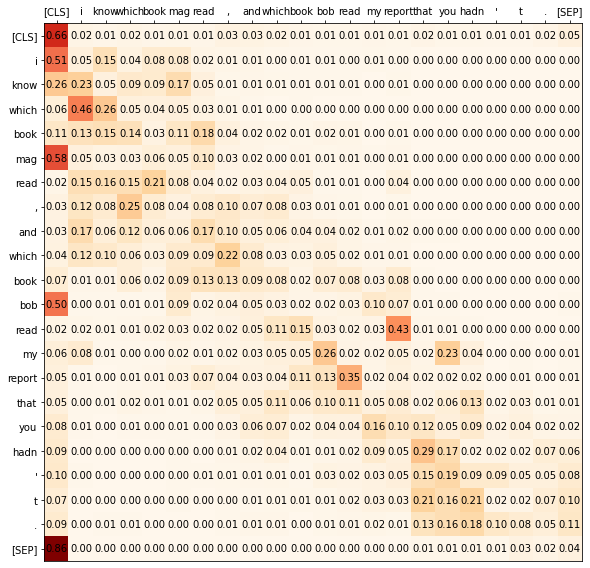

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_42 layer 1 head 4
Original Attention Across heads meaned


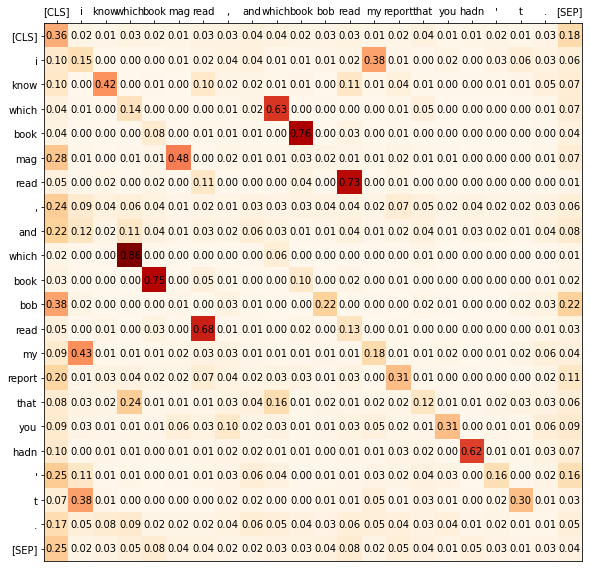

torch.Size([1, 1, 36, 36])
['block']
CoLA seed_42 layer 2 head 0
Original Attention Across heads meaned


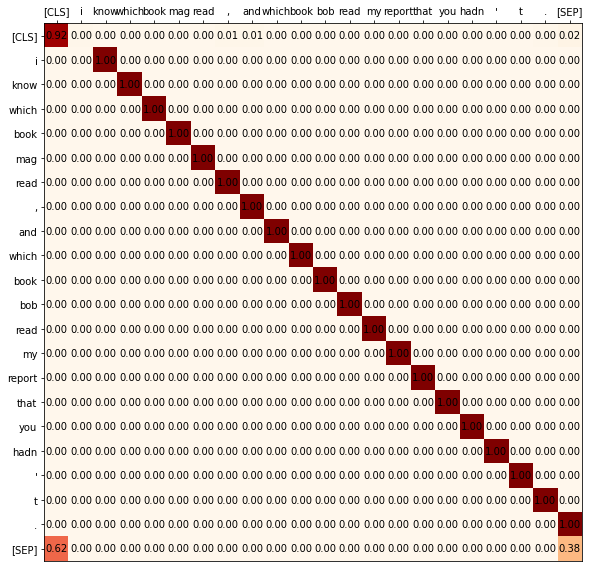

torch.Size([1, 1, 36, 36])
['diagonal']
CoLA seed_42 layer 2 head 1
Original Attention Across heads meaned


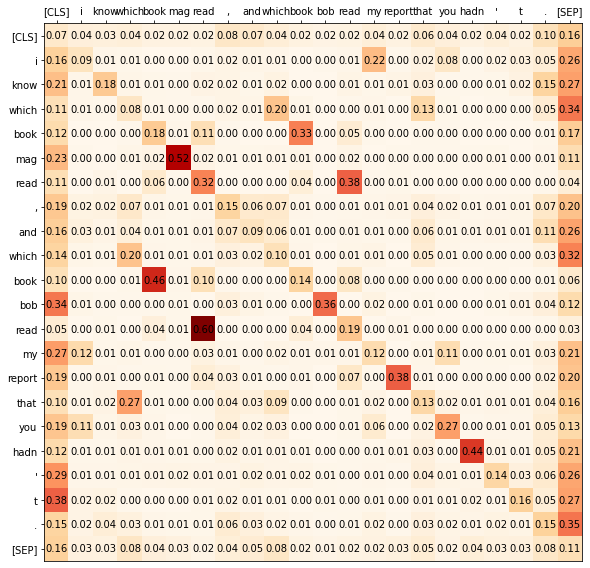

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_42 layer 3 head 0
Original Attention Across heads meaned


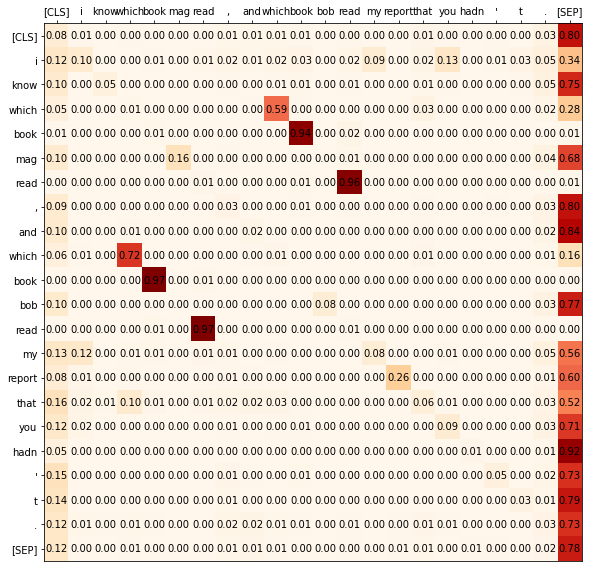

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_42 layer 3 head 1
Original Attention Across heads meaned


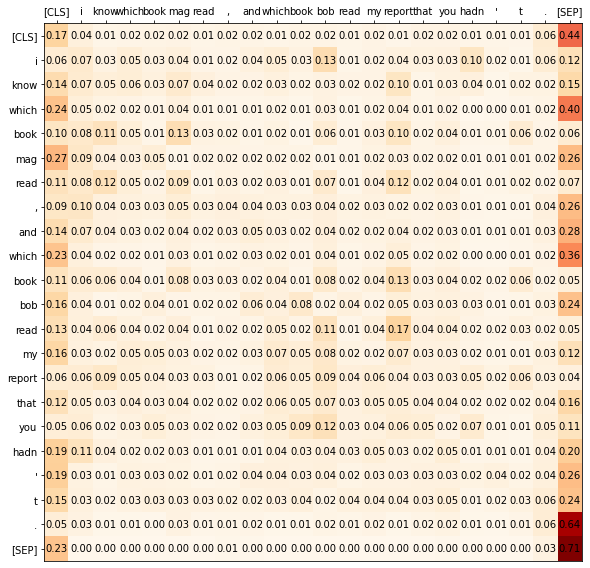

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_42 layer 3 head 2
Original Attention Across heads meaned


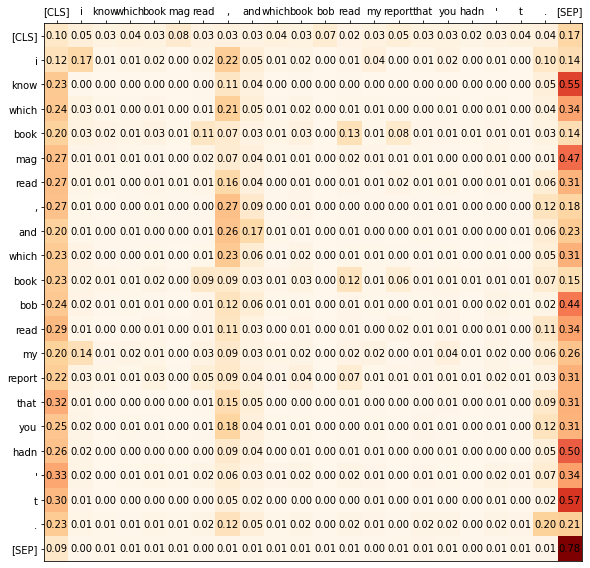

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_42 layer 3 head 3
Original Attention Across heads meaned


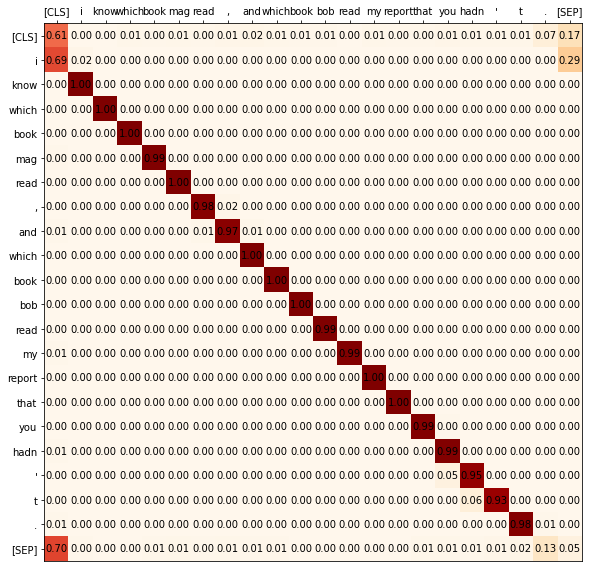

torch.Size([1, 1, 36, 36])
['diagonal']
CoLA seed_42 layer 3 head 4
Original Attention Across heads meaned


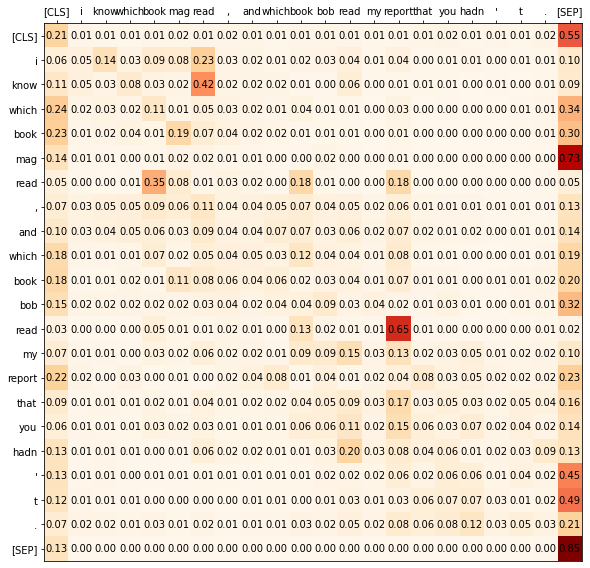

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_42 layer 4 head 0
Original Attention Across heads meaned


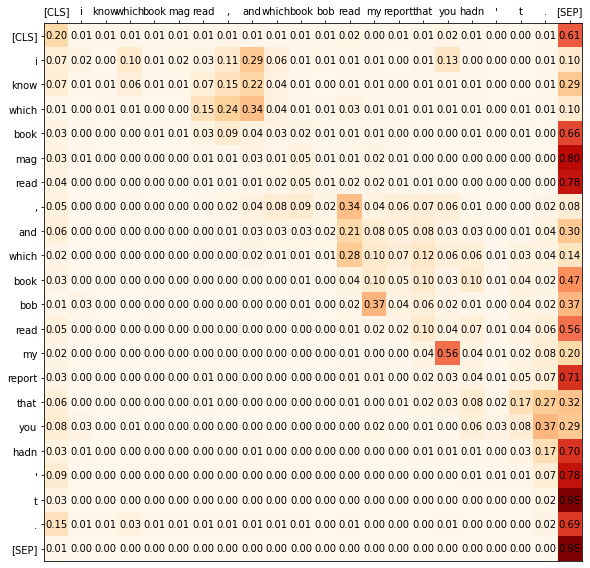

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_42 layer 4 head 1
Original Attention Across heads meaned


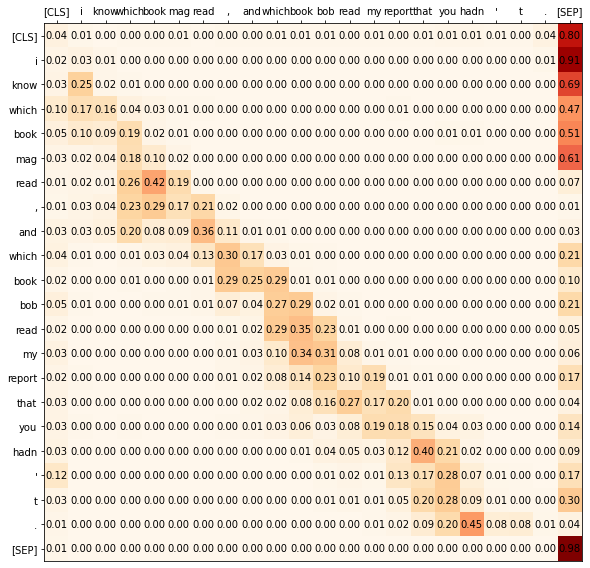

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_42 layer 5 head 0
Original Attention Across heads meaned


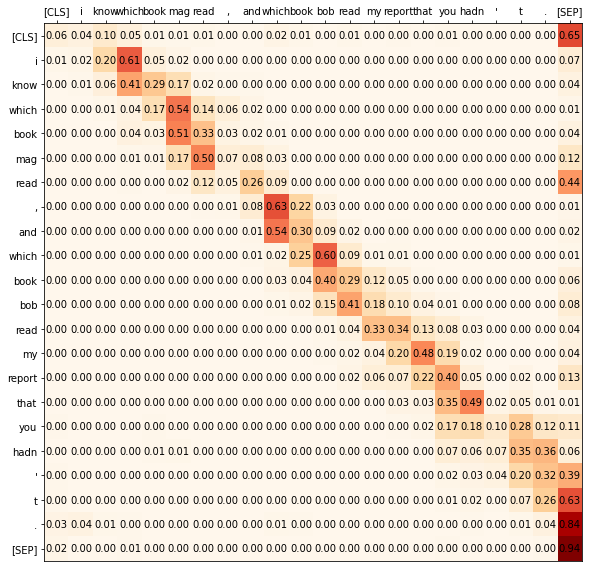

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_42 layer 5 head 1
Original Attention Across heads meaned


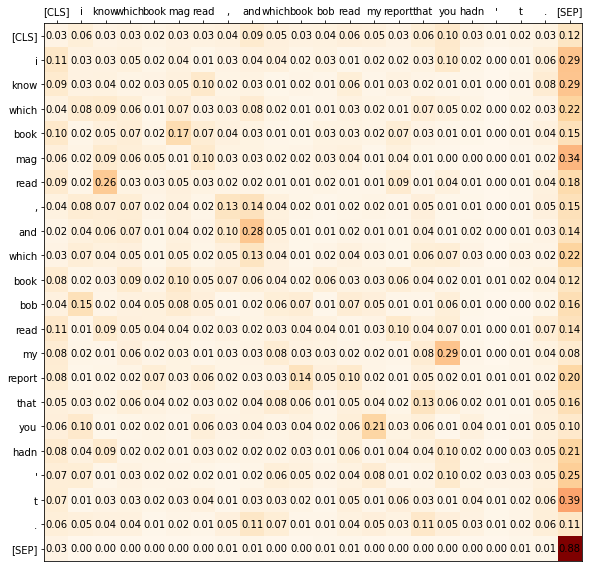

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_42 layer 5 head 2
Original Attention Across heads meaned


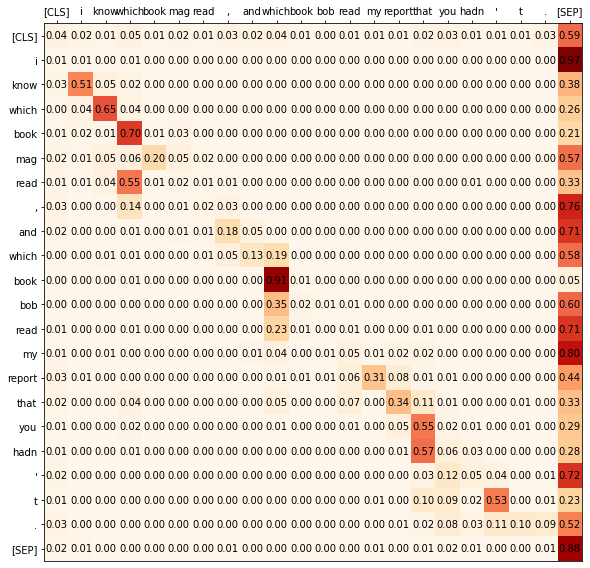

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_42 layer 5 head 3
Original Attention Across heads meaned


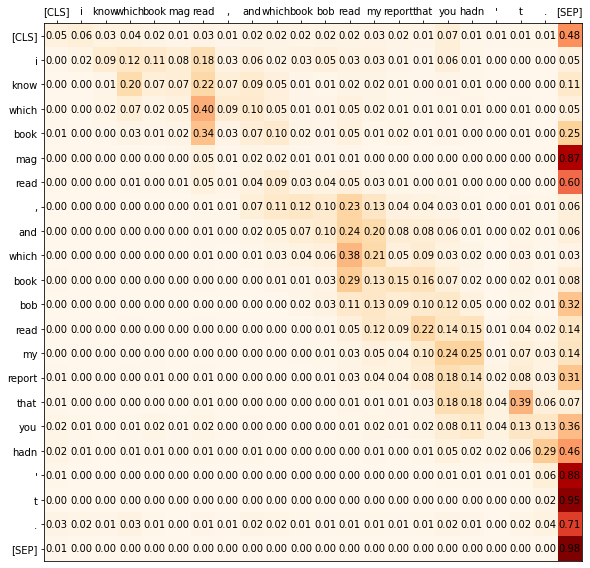

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_42 layer 5 head 4
Original Attention Across heads meaned


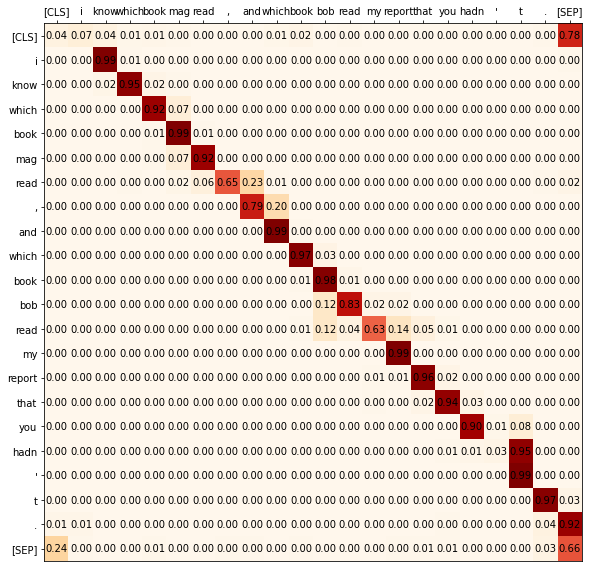

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_42 layer 6 head 0
Original Attention Across heads meaned


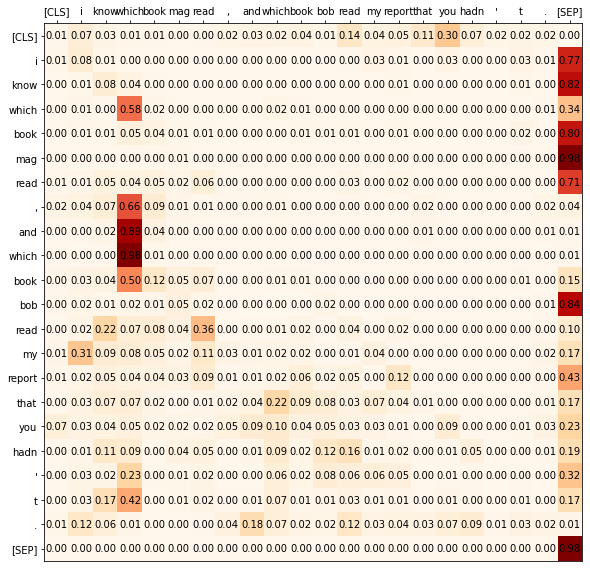

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_42 layer 6 head 1
Original Attention Across heads meaned


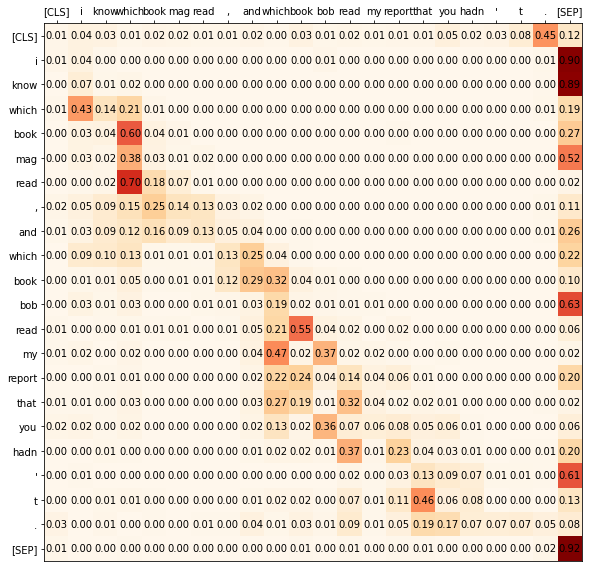

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_42 layer 6 head 2
Original Attention Across heads meaned


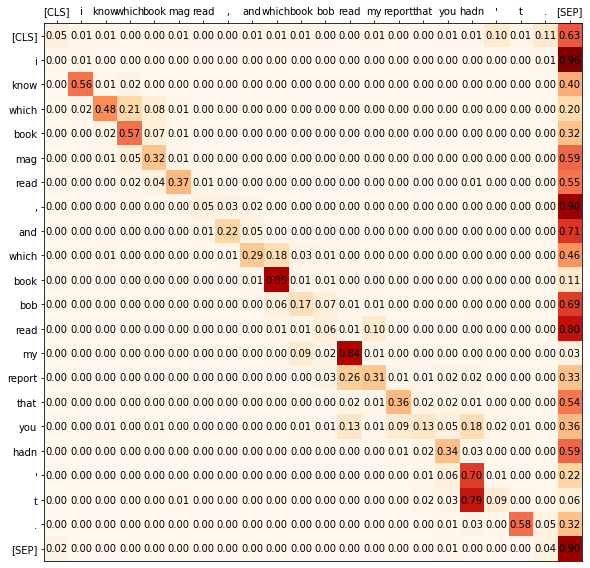

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_42 layer 6 head 3
Original Attention Across heads meaned


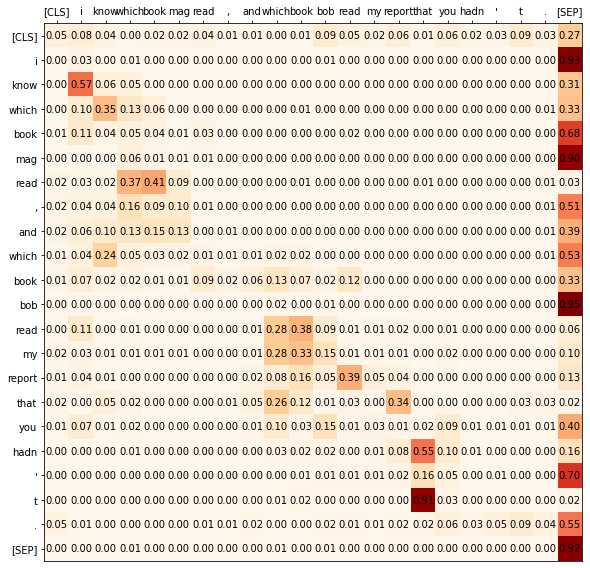

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_42 layer 7 head 0
Original Attention Across heads meaned


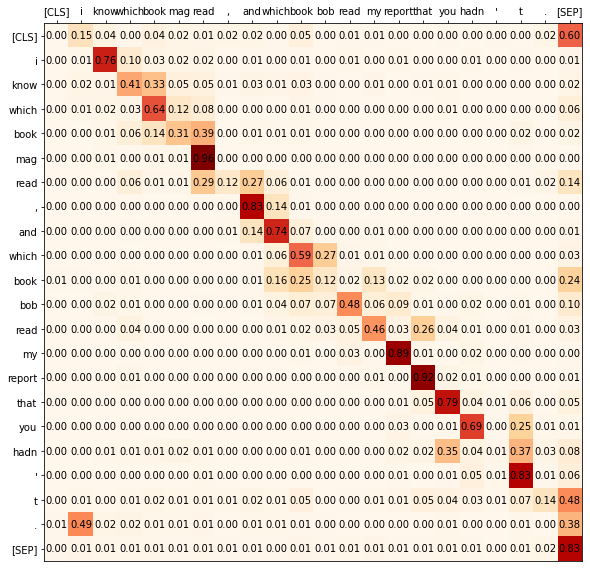

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_42 layer 7 head 1
Original Attention Across heads meaned


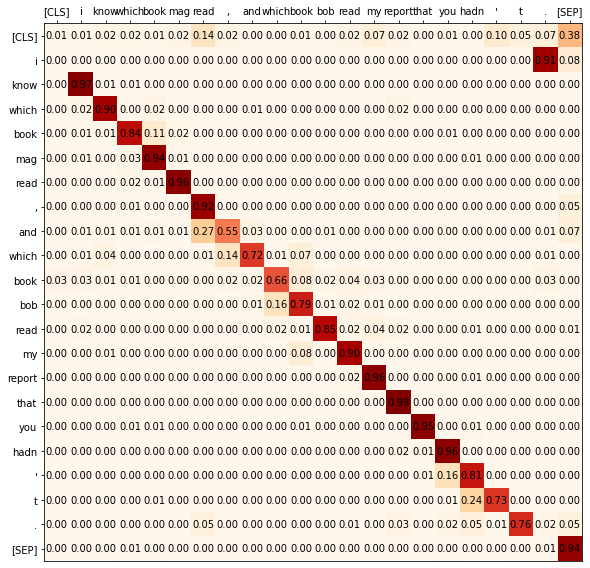

torch.Size([1, 1, 36, 36])
['diagonal']
CoLA seed_42 layer 7 head 2
Original Attention Across heads meaned


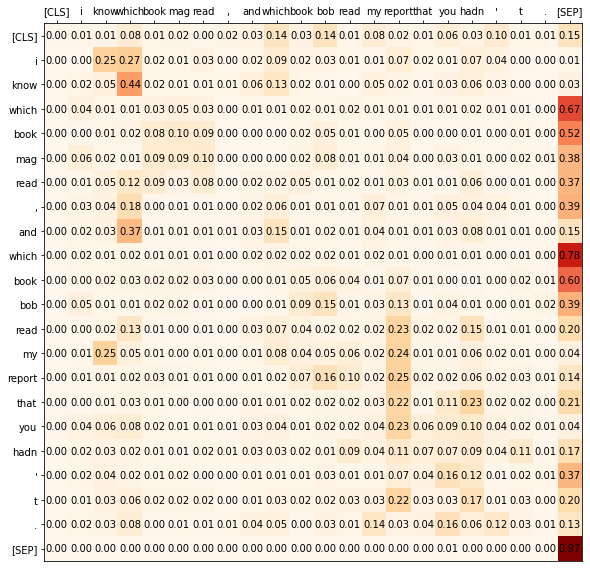

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_42 layer 7 head 3
Original Attention Across heads meaned


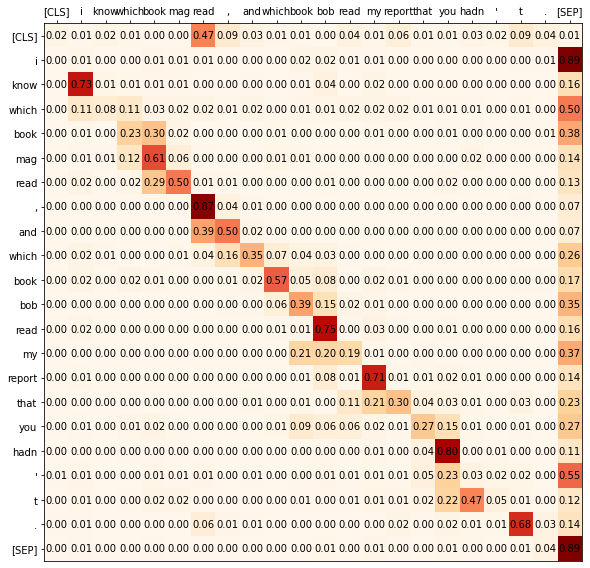

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_42 layer 8 head 0
Original Attention Across heads meaned


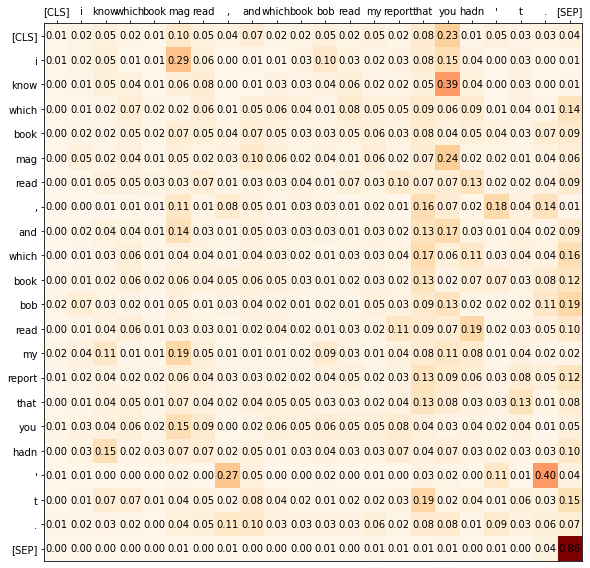

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_42 layer 10 head 0
Original Attention Across heads meaned


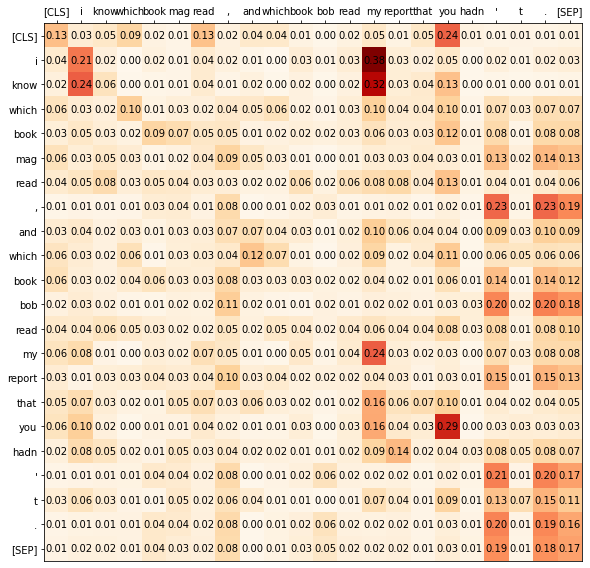

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_42 layer 10 head 1
Original Attention Across heads meaned


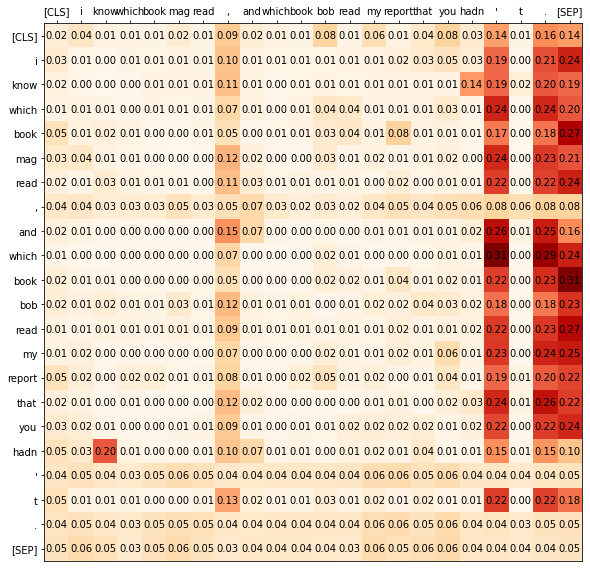

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_86 layer 0 head 0
Original Attention Across heads meaned


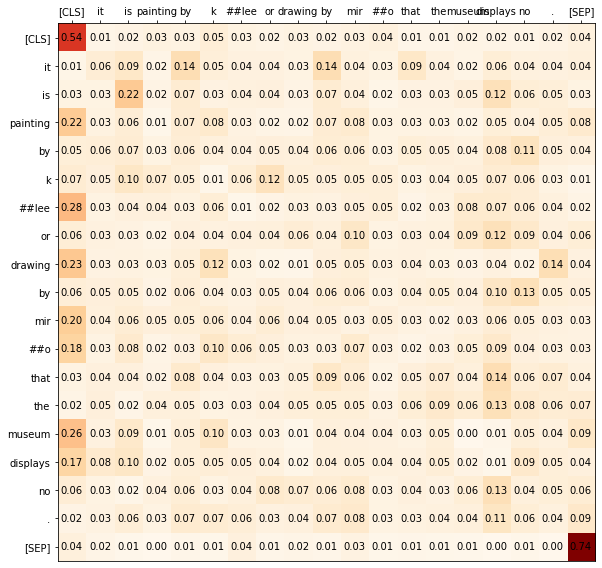

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_86 layer 0 head 1
Original Attention Across heads meaned


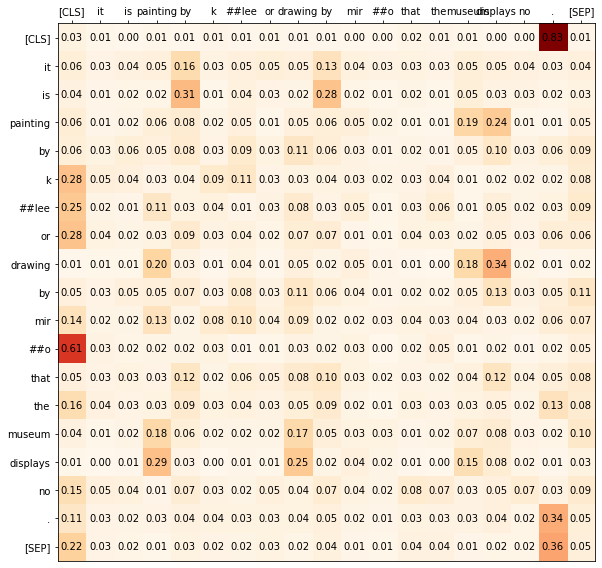

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_86 layer 0 head 2
Original Attention Across heads meaned


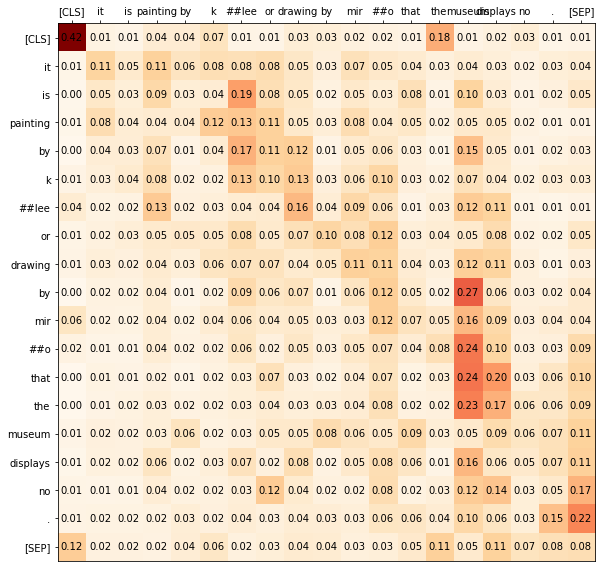

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_86 layer 0 head 3
Original Attention Across heads meaned


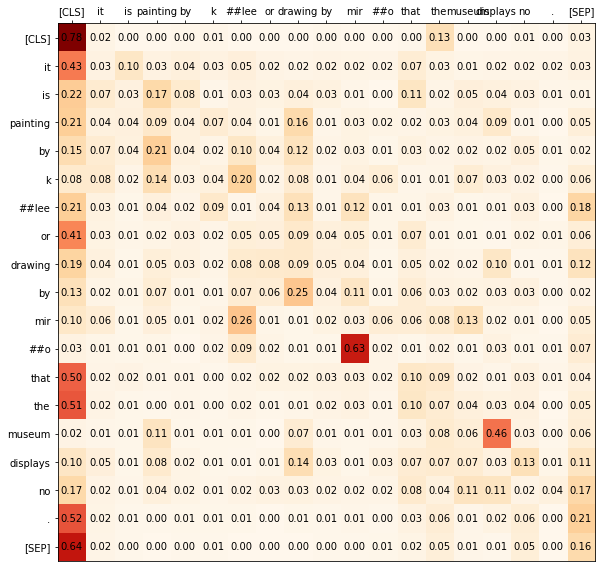

torch.Size([1, 1, 36, 36])
['block']
CoLA seed_86 layer 1 head 0
Original Attention Across heads meaned


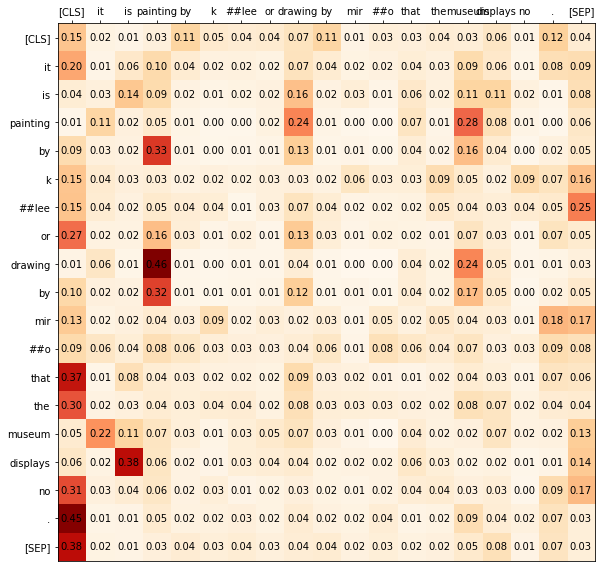

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_86 layer 1 head 1
Original Attention Across heads meaned


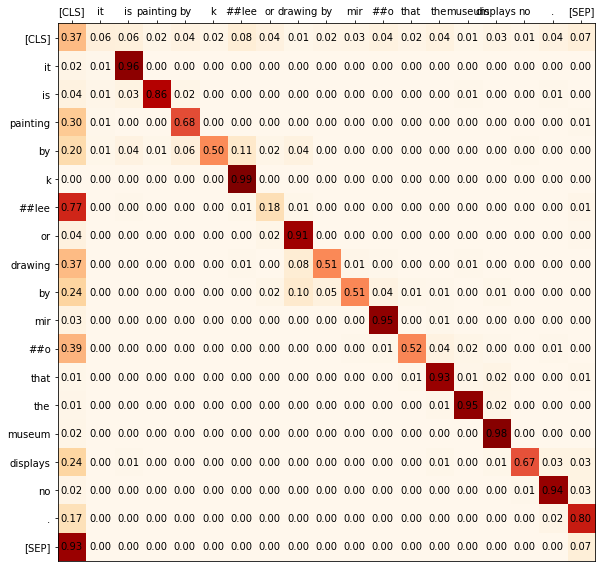

torch.Size([1, 1, 36, 36])
['diagonal']
CoLA seed_86 layer 1 head 2
Original Attention Across heads meaned


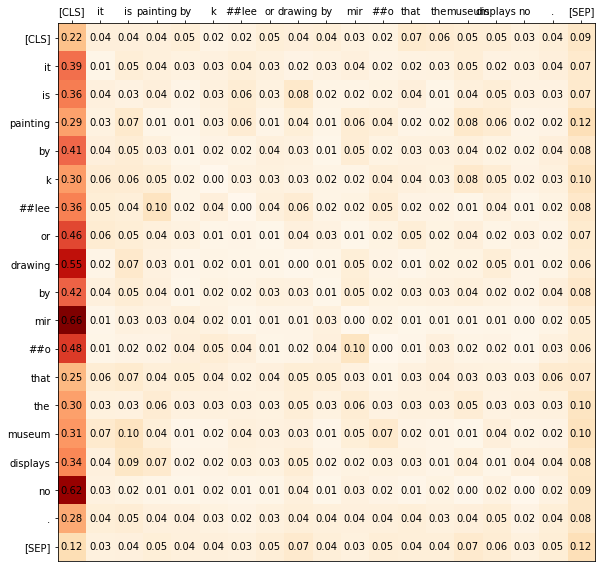

torch.Size([1, 1, 36, 36])
['block']
CoLA seed_86 layer 1 head 3
Original Attention Across heads meaned


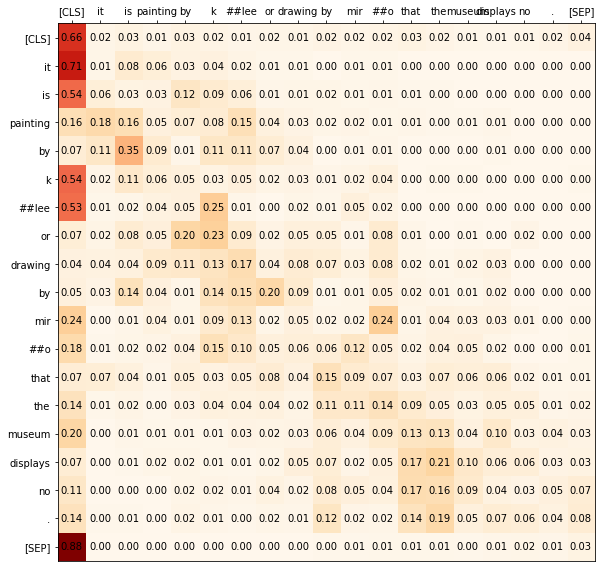

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_86 layer 1 head 4
Original Attention Across heads meaned


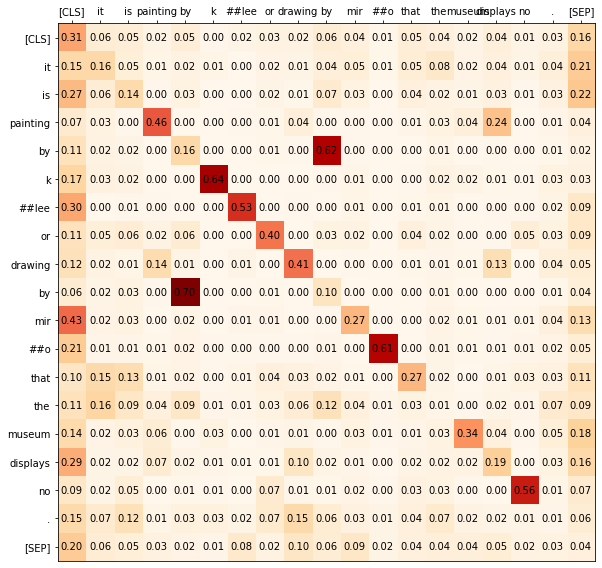

torch.Size([1, 1, 36, 36])
['block']
CoLA seed_86 layer 2 head 0
Original Attention Across heads meaned


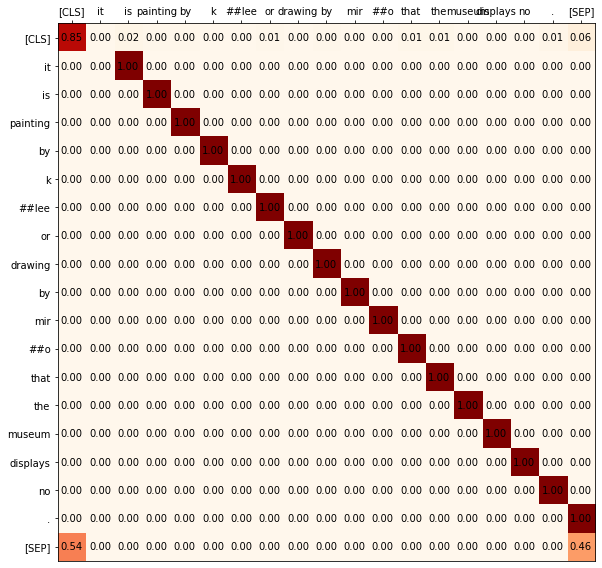

torch.Size([1, 1, 36, 36])
['diagonal']
CoLA seed_86 layer 2 head 1
Original Attention Across heads meaned


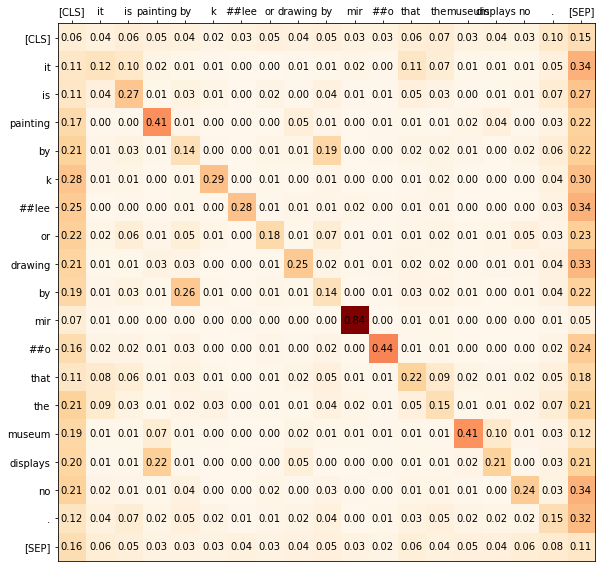

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_86 layer 3 head 0
Original Attention Across heads meaned


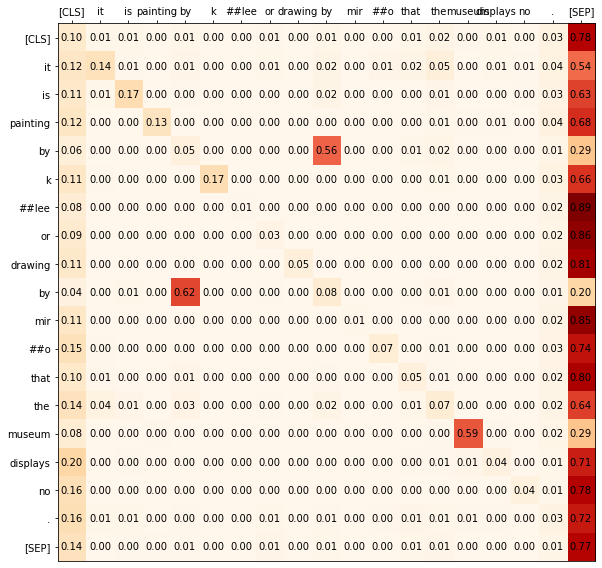

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_86 layer 3 head 1
Original Attention Across heads meaned


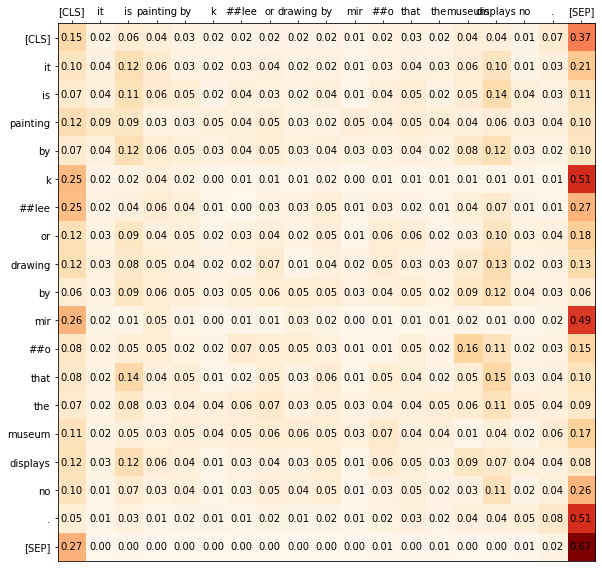

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_86 layer 3 head 2
Original Attention Across heads meaned


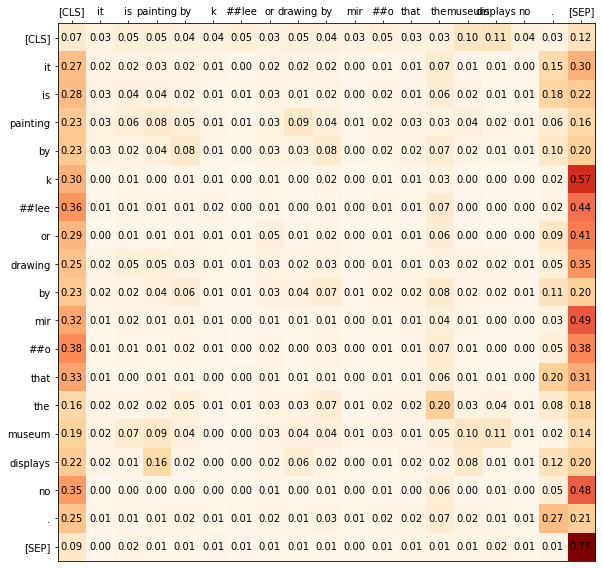

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_86 layer 3 head 3
Original Attention Across heads meaned


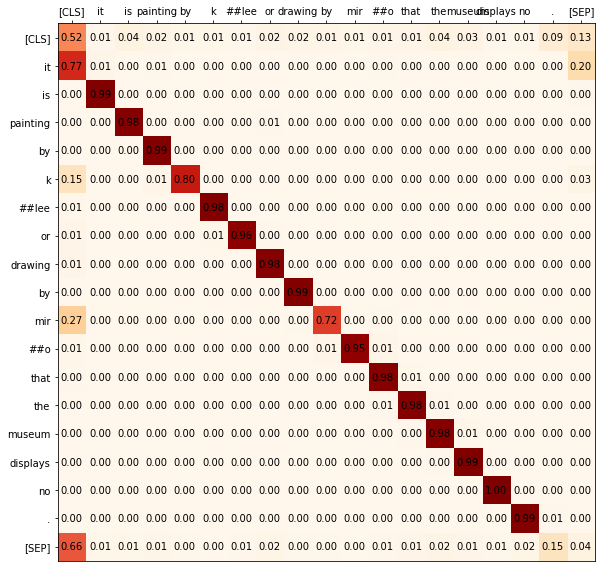

torch.Size([1, 1, 36, 36])
['diagonal']
CoLA seed_86 layer 3 head 4
Original Attention Across heads meaned


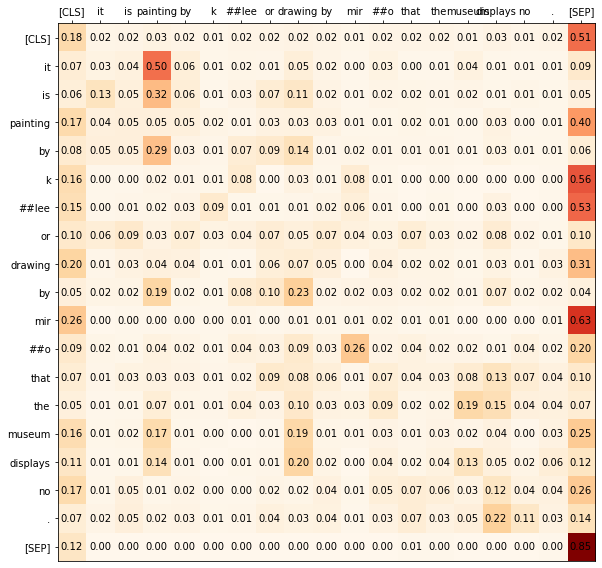

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_86 layer 4 head 0
Original Attention Across heads meaned


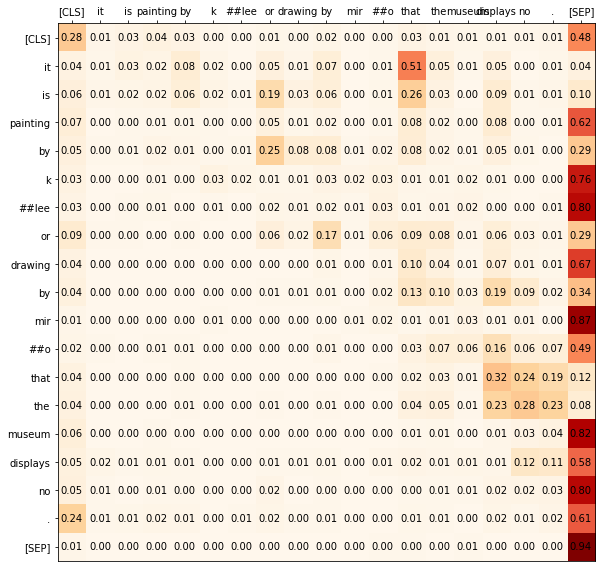

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_86 layer 4 head 1
Original Attention Across heads meaned


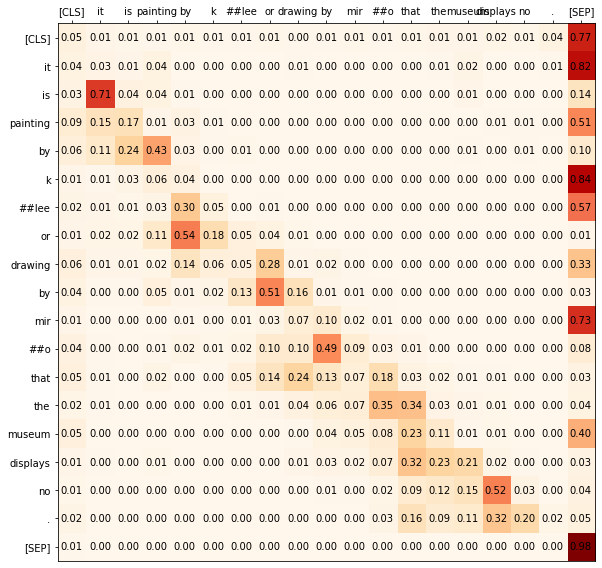

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_86 layer 5 head 0
Original Attention Across heads meaned


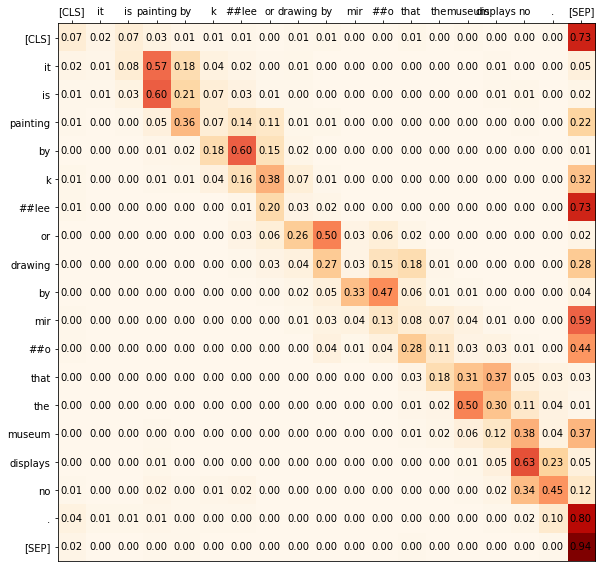

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_86 layer 5 head 1
Original Attention Across heads meaned


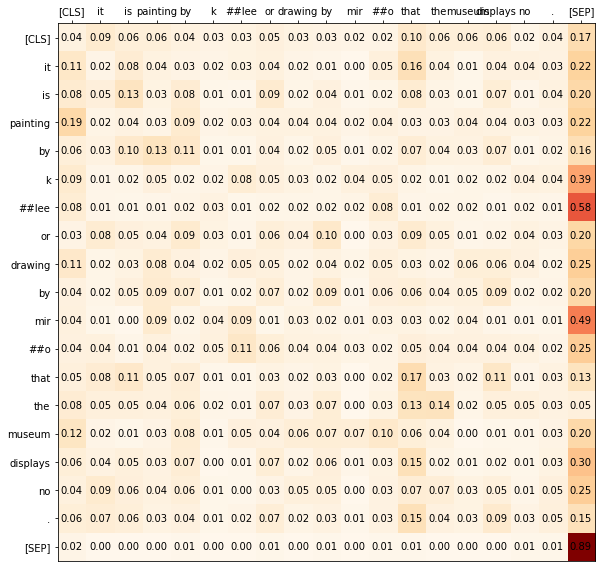

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_86 layer 5 head 2
Original Attention Across heads meaned


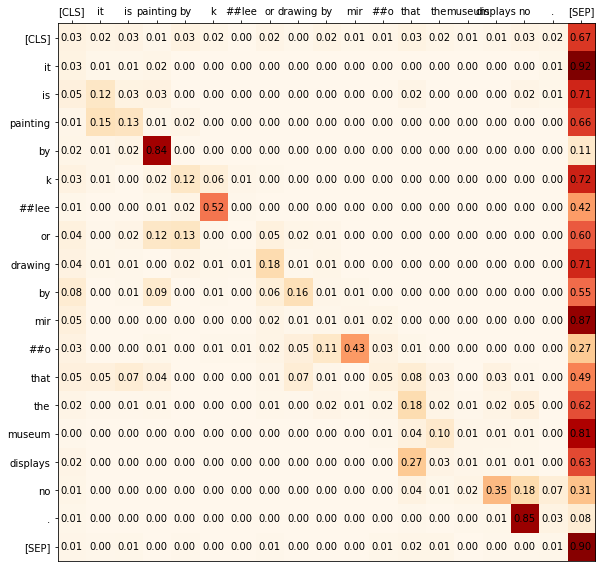

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_86 layer 5 head 3
Original Attention Across heads meaned


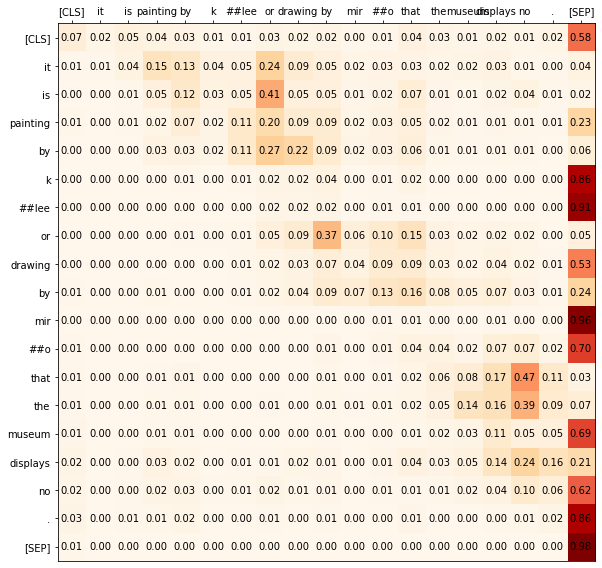

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_86 layer 5 head 4
Original Attention Across heads meaned


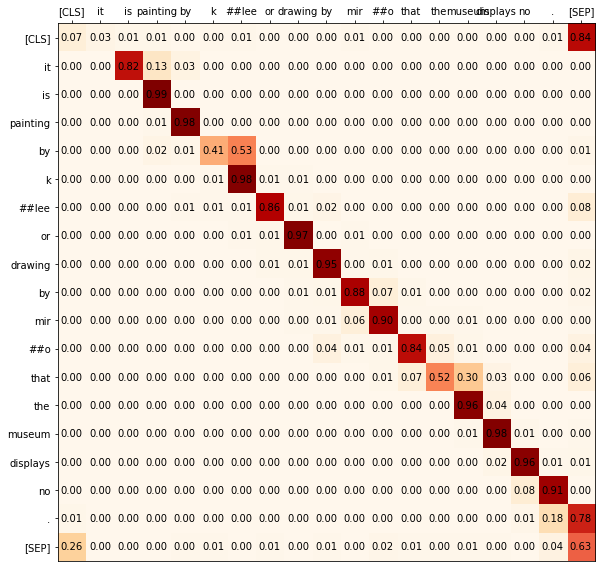

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_86 layer 6 head 0
Original Attention Across heads meaned


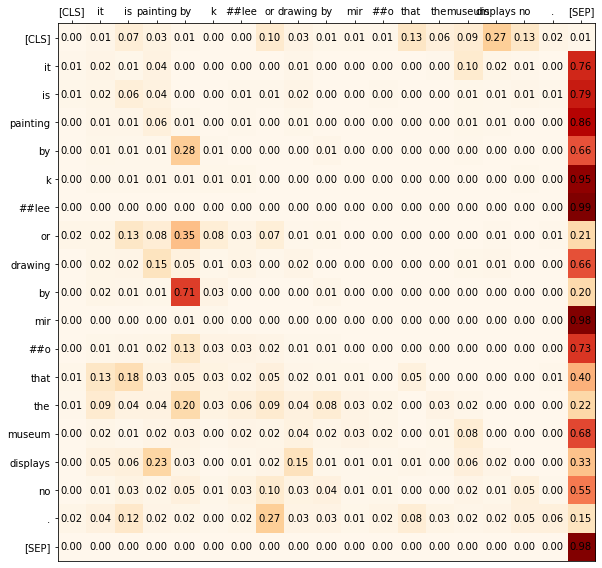

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_86 layer 6 head 1
Original Attention Across heads meaned


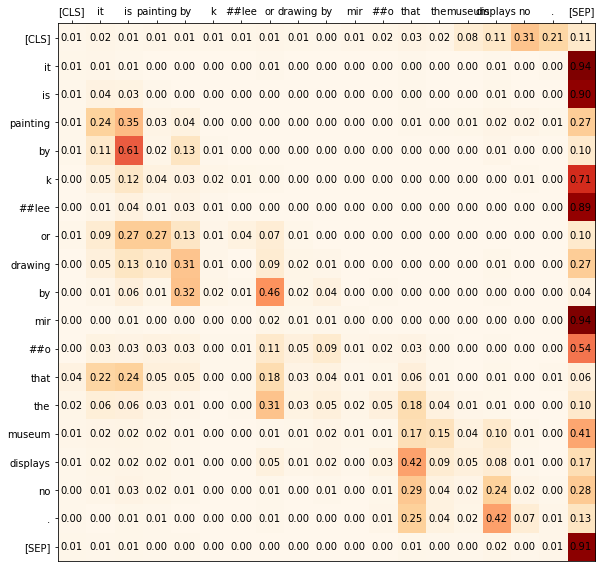

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_86 layer 6 head 2
Original Attention Across heads meaned


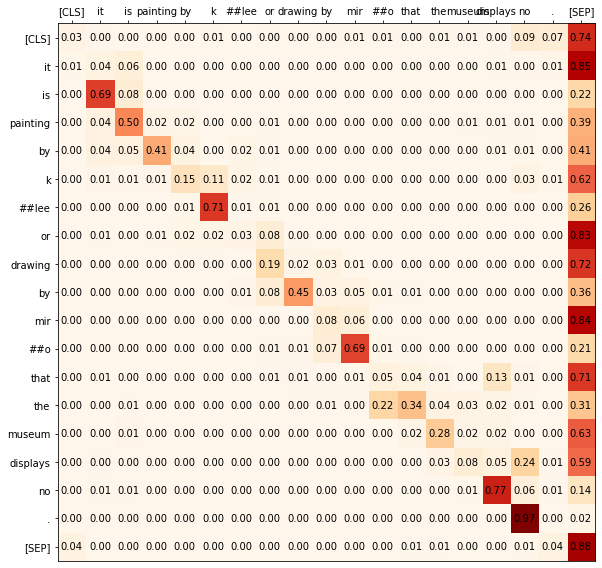

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_86 layer 6 head 3
Original Attention Across heads meaned


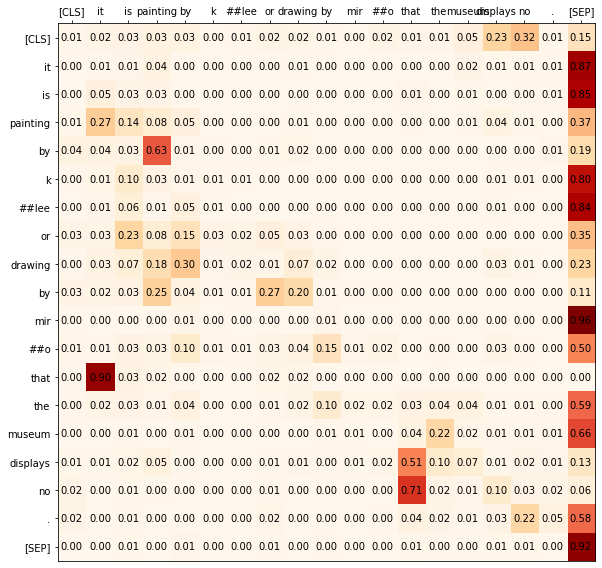

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_86 layer 7 head 0
Original Attention Across heads meaned


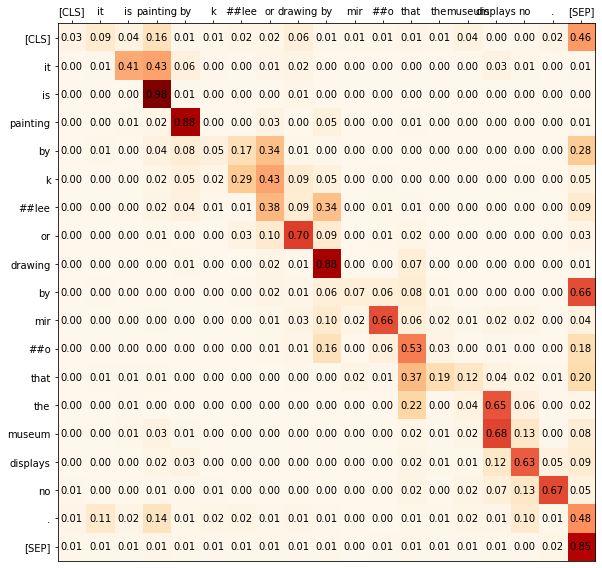

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_86 layer 7 head 1
Original Attention Across heads meaned


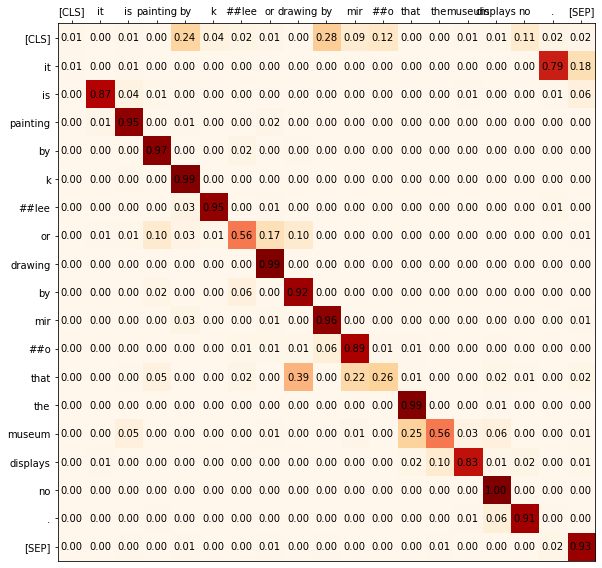

torch.Size([1, 1, 36, 36])
['diagonal']
CoLA seed_86 layer 7 head 2
Original Attention Across heads meaned


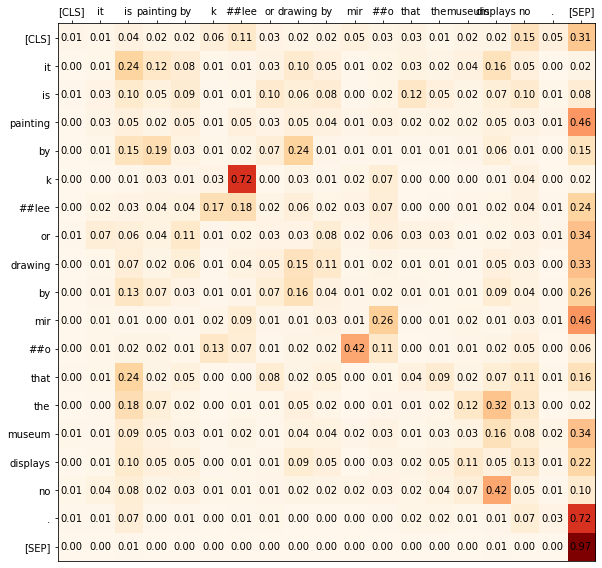

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_86 layer 7 head 3
Original Attention Across heads meaned


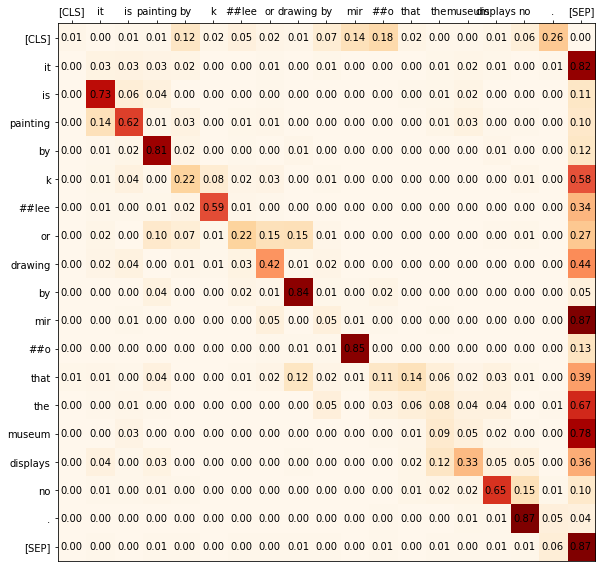

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_86 layer 8 head 0
Original Attention Across heads meaned


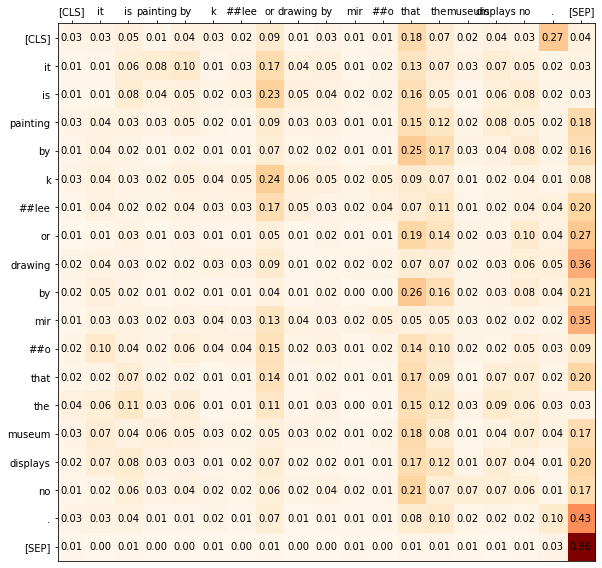

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_86 layer 10 head 0
Original Attention Across heads meaned


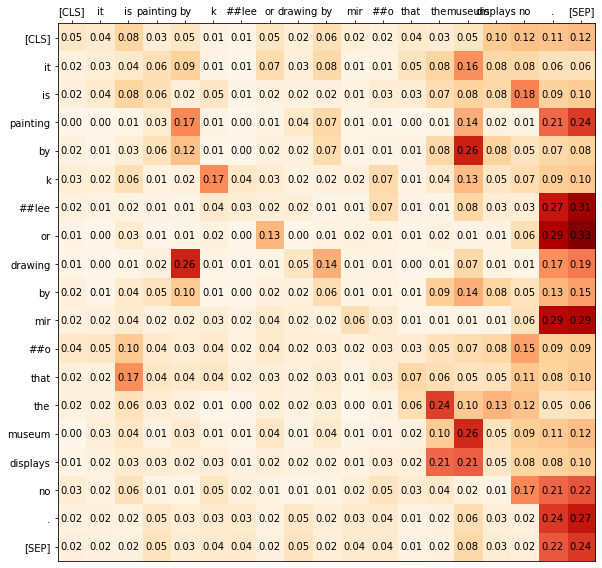

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_86 layer 10 head 1
Original Attention Across heads meaned


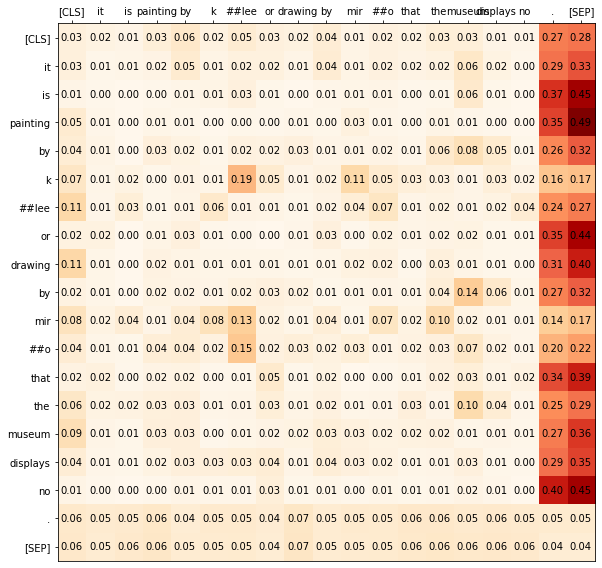

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_71 layer 0 head 0
Original Attention Across heads meaned


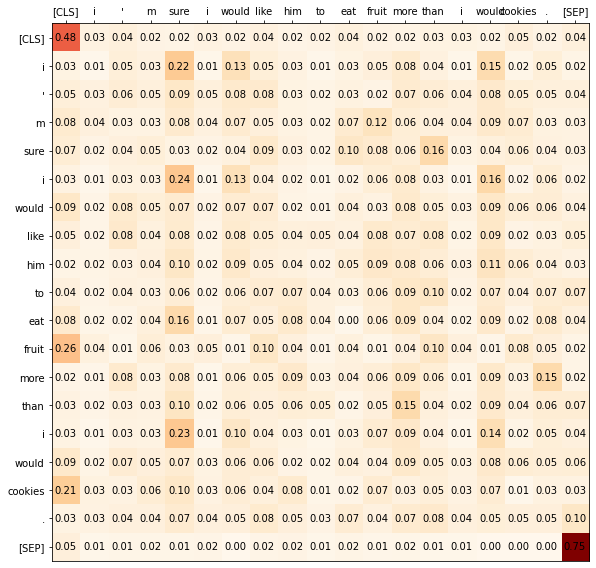

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_71 layer 0 head 1
Original Attention Across heads meaned


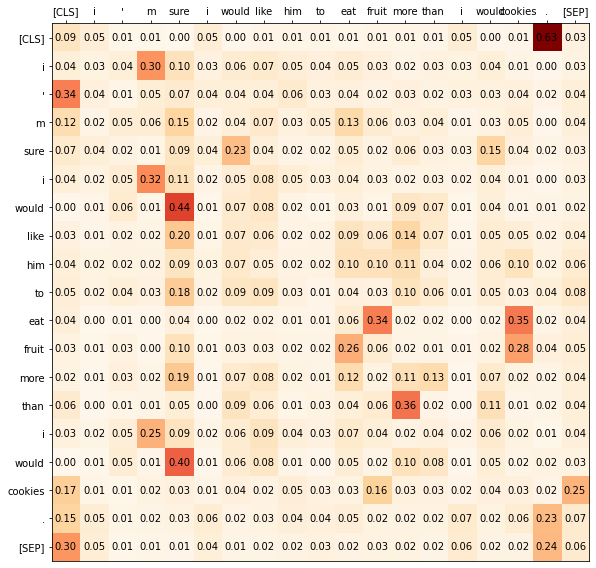

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_71 layer 0 head 2
Original Attention Across heads meaned


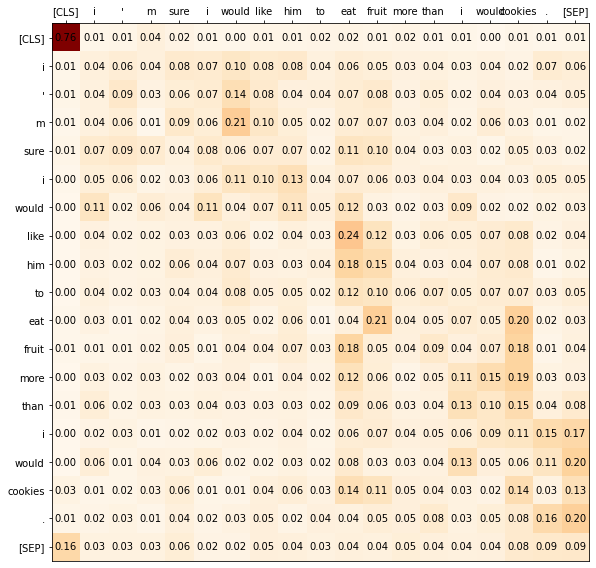

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_71 layer 0 head 3
Original Attention Across heads meaned


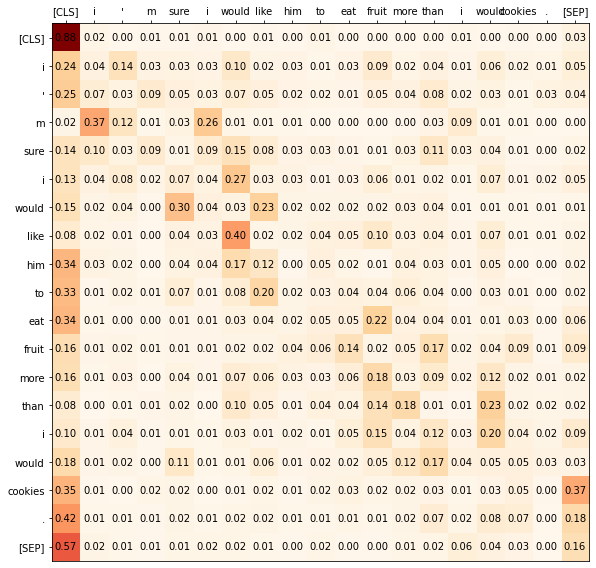

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_71 layer 1 head 0
Original Attention Across heads meaned


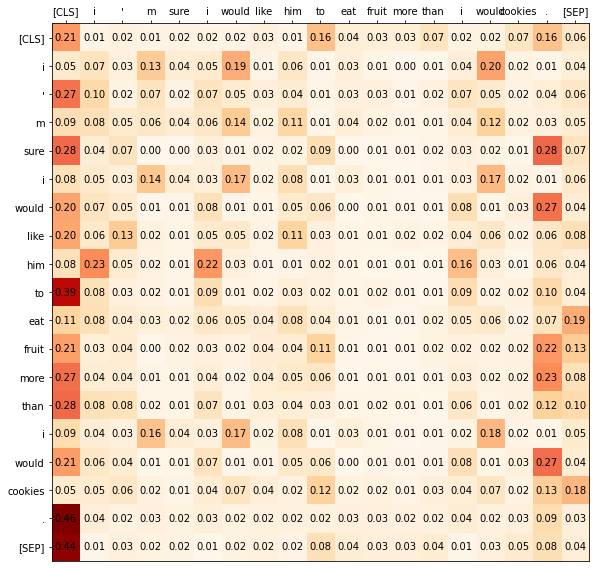

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_71 layer 1 head 1
Original Attention Across heads meaned


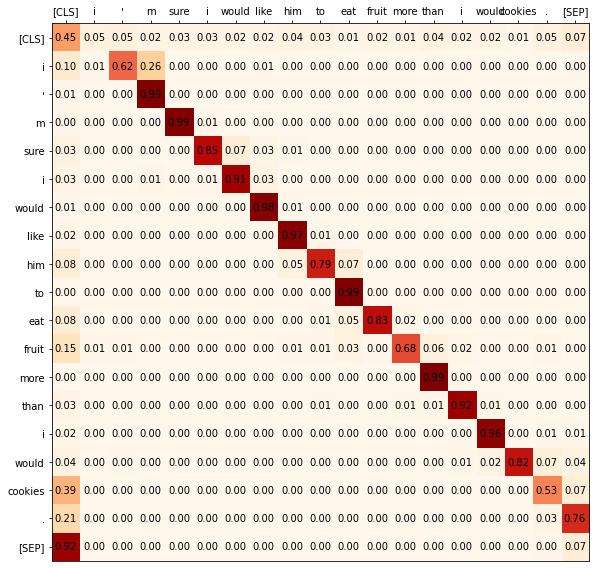

torch.Size([1, 1, 36, 36])
['diagonal']
CoLA seed_71 layer 1 head 2
Original Attention Across heads meaned


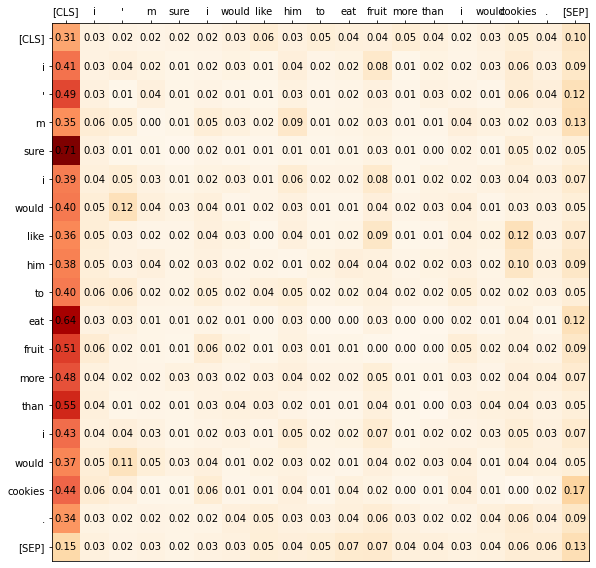

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_71 layer 1 head 3
Original Attention Across heads meaned


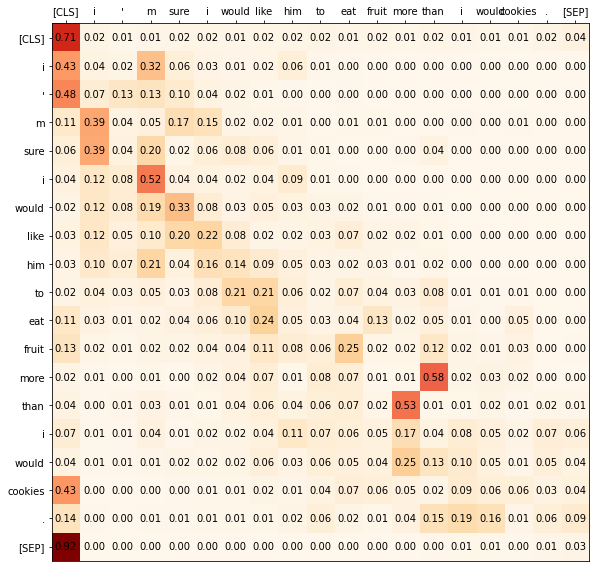

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_71 layer 1 head 4
Original Attention Across heads meaned


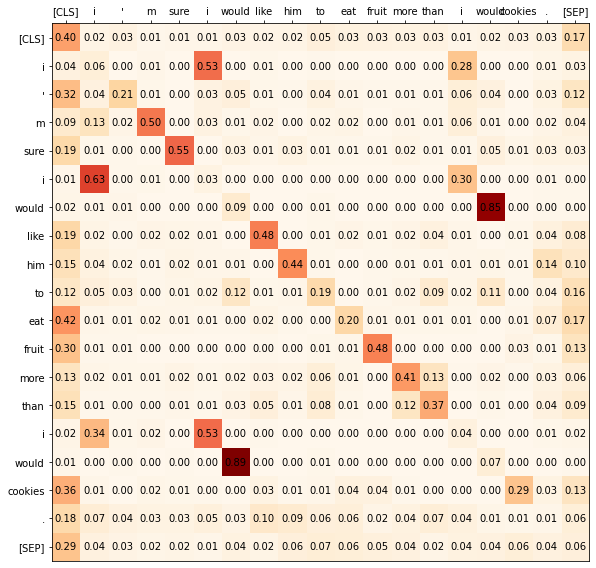

torch.Size([1, 1, 36, 36])
['block']
CoLA seed_71 layer 2 head 0
Original Attention Across heads meaned


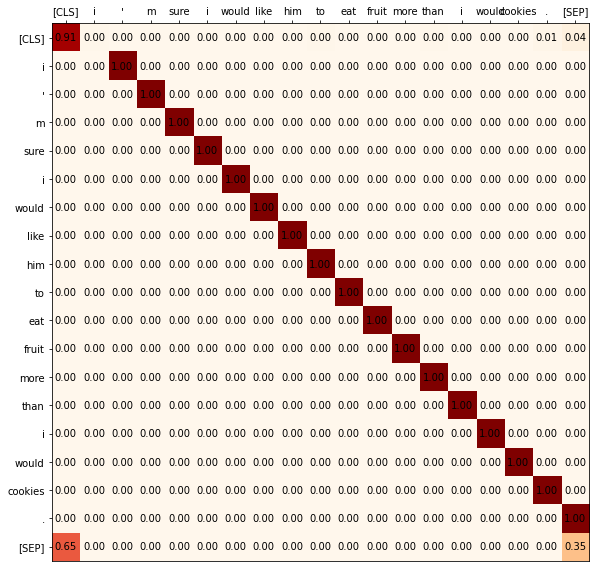

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_71 layer 2 head 1
Original Attention Across heads meaned


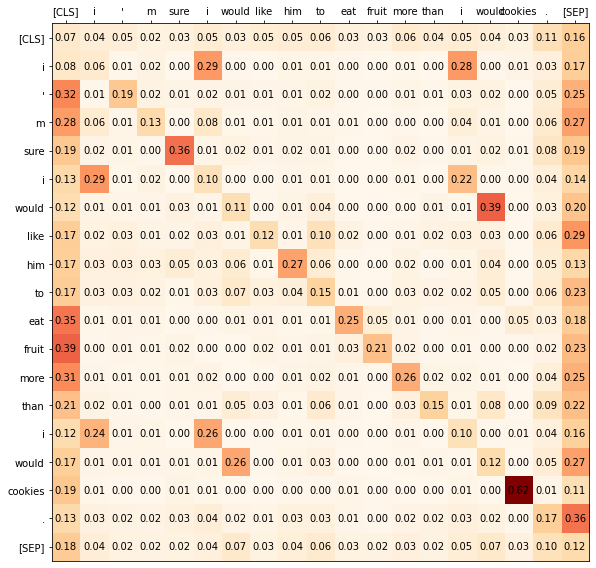

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_71 layer 3 head 0
Original Attention Across heads meaned


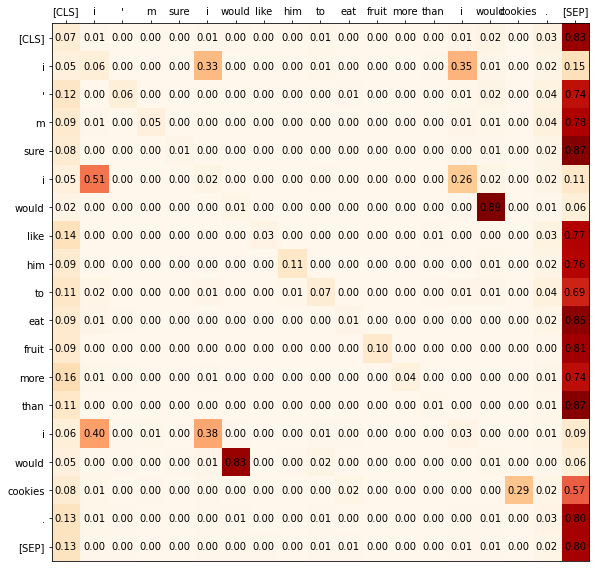

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_71 layer 3 head 1
Original Attention Across heads meaned


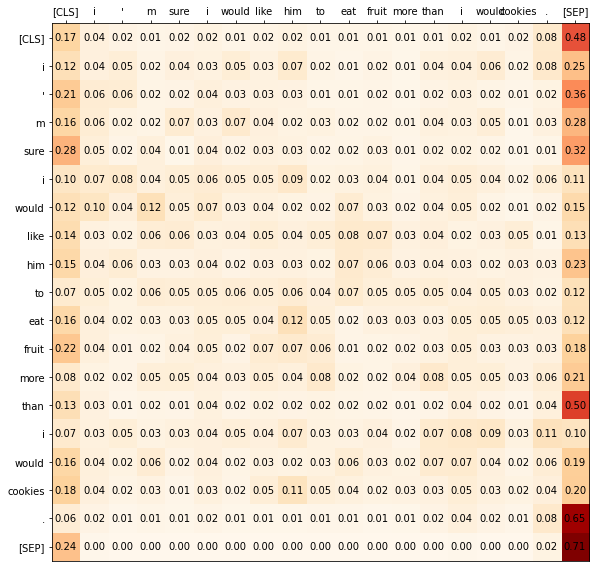

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_71 layer 3 head 2
Original Attention Across heads meaned


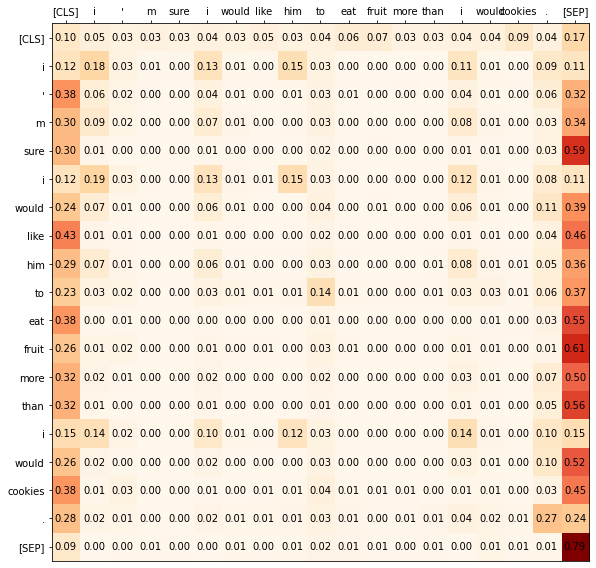

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_71 layer 3 head 3
Original Attention Across heads meaned


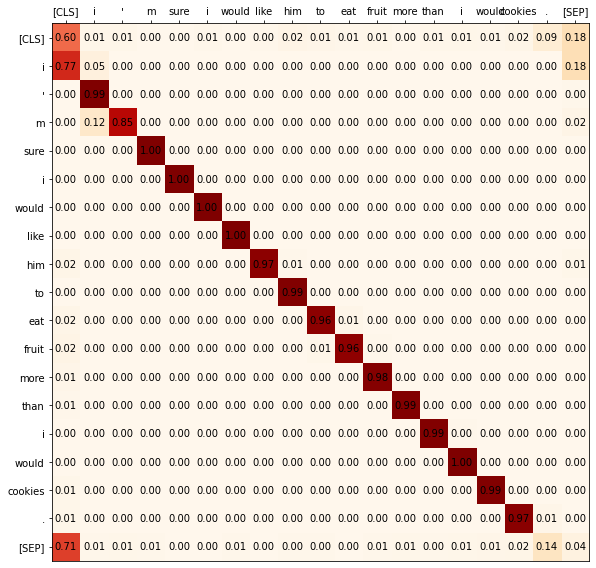

torch.Size([1, 1, 36, 36])
['diagonal']
CoLA seed_71 layer 3 head 4
Original Attention Across heads meaned


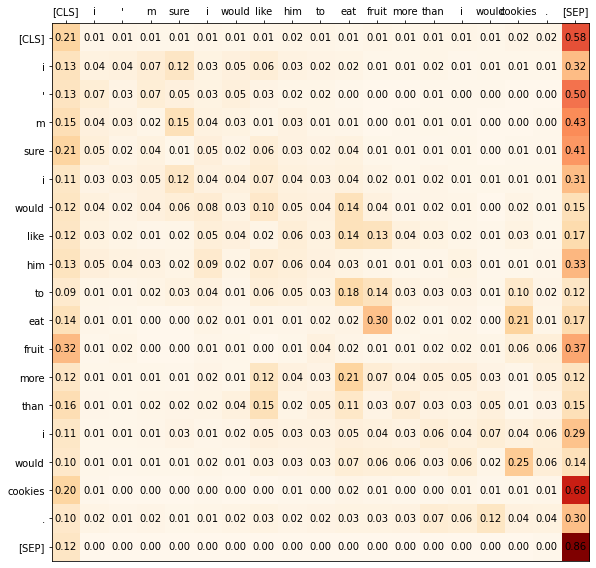

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_71 layer 4 head 0
Original Attention Across heads meaned


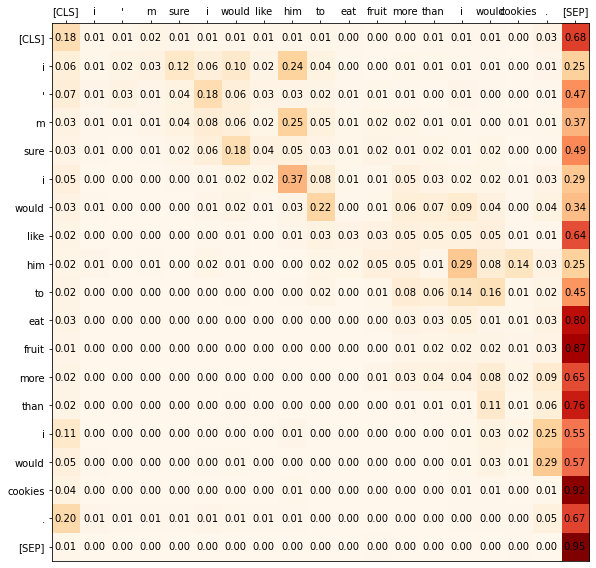

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_71 layer 4 head 1
Original Attention Across heads meaned


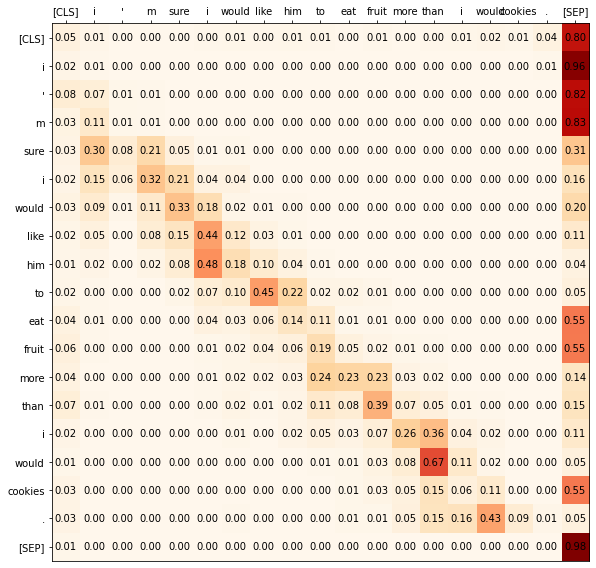

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_71 layer 5 head 0
Original Attention Across heads meaned


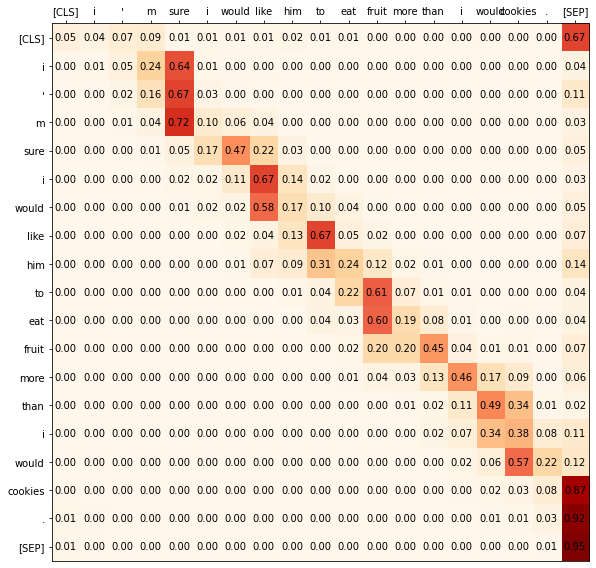

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_71 layer 5 head 1
Original Attention Across heads meaned


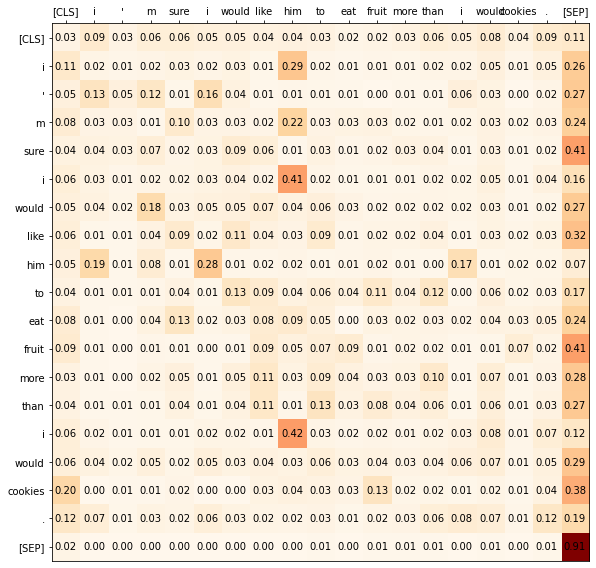

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_71 layer 5 head 2
Original Attention Across heads meaned


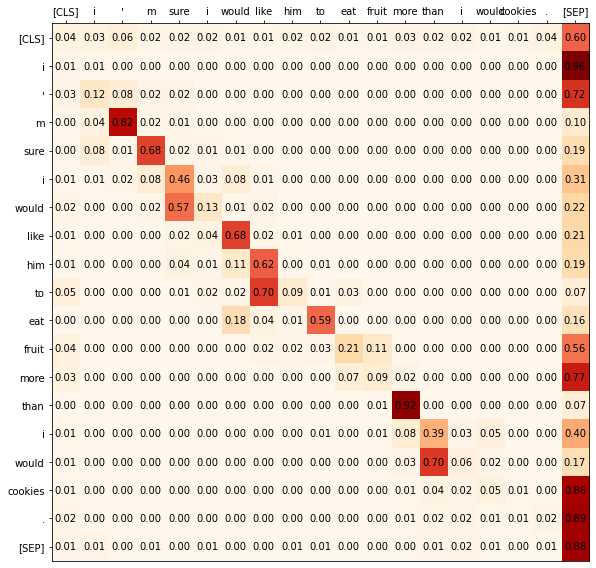

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_71 layer 5 head 3
Original Attention Across heads meaned


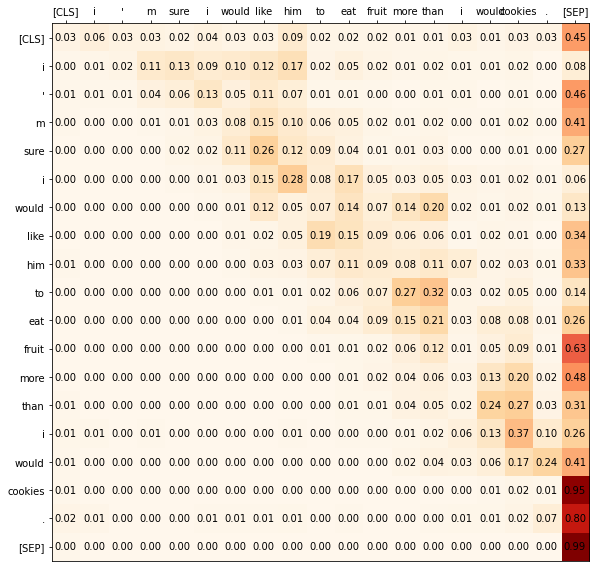

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_71 layer 5 head 4
Original Attention Across heads meaned


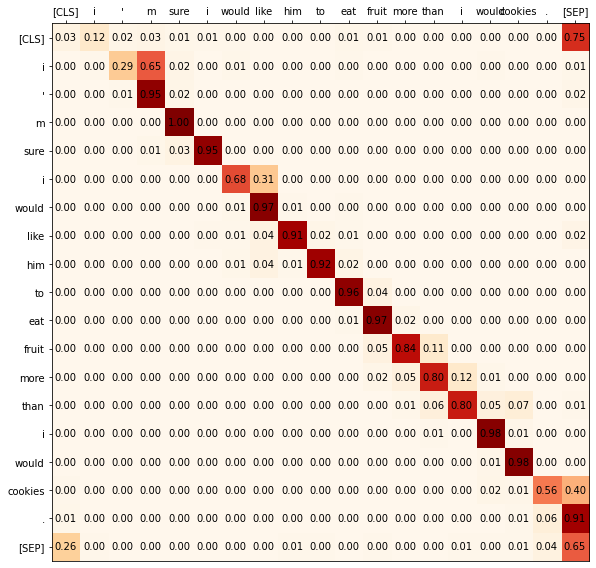

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_71 layer 6 head 0
Original Attention Across heads meaned


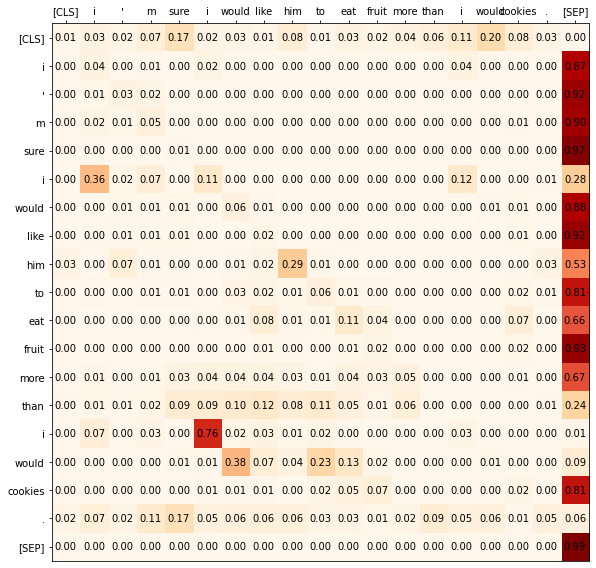

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_71 layer 6 head 1
Original Attention Across heads meaned


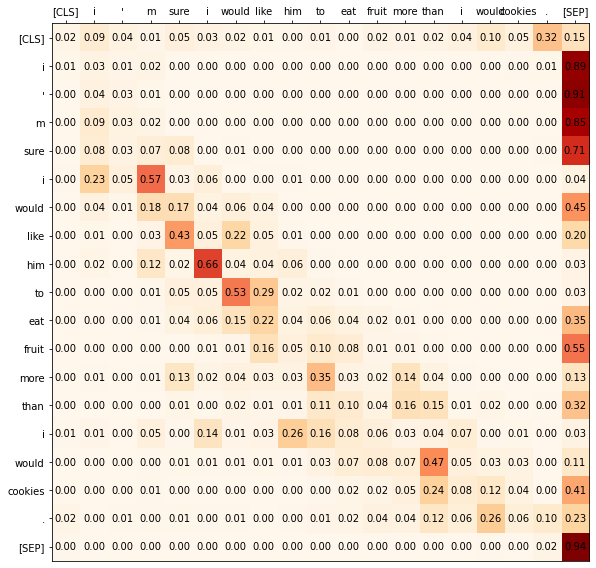

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_71 layer 6 head 2
Original Attention Across heads meaned


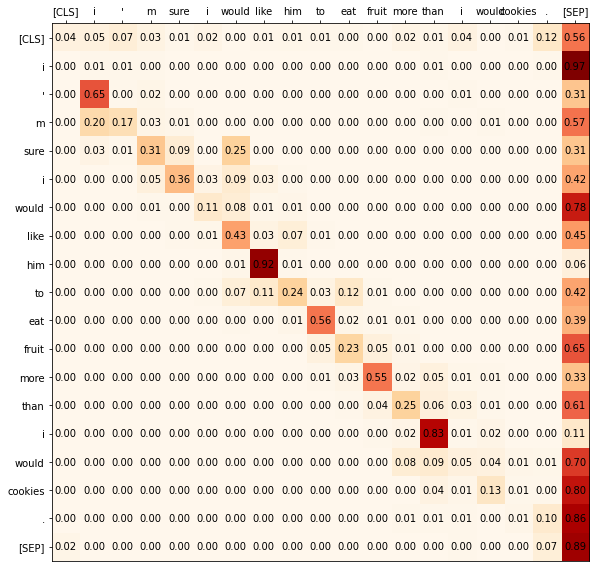

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_71 layer 6 head 3
Original Attention Across heads meaned


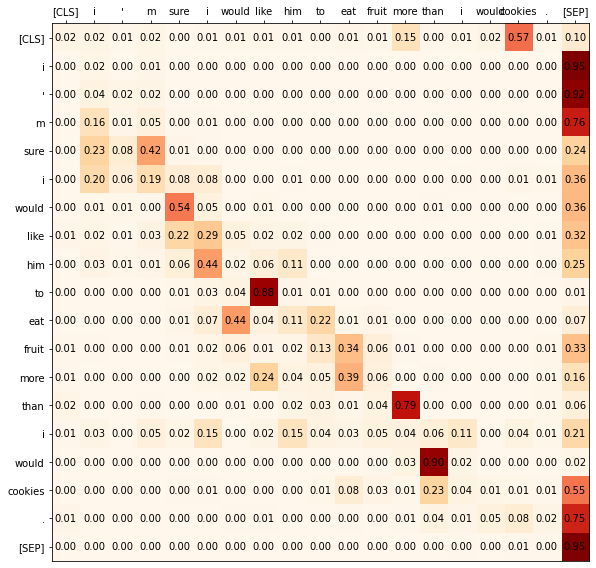

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_71 layer 7 head 0
Original Attention Across heads meaned


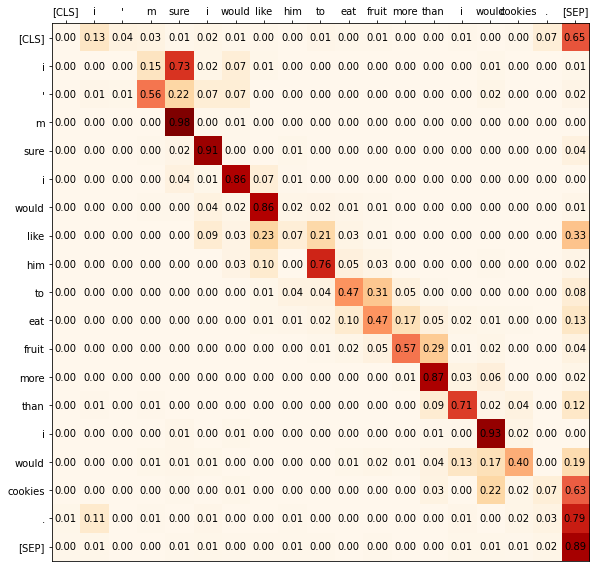

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_71 layer 7 head 1
Original Attention Across heads meaned


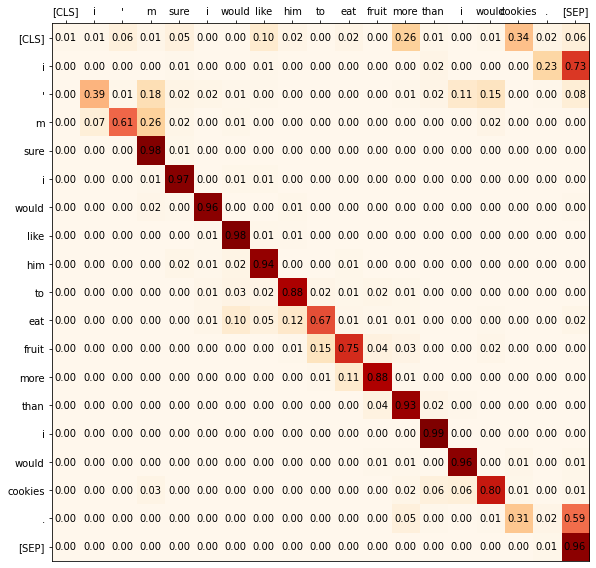

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_71 layer 7 head 2
Original Attention Across heads meaned


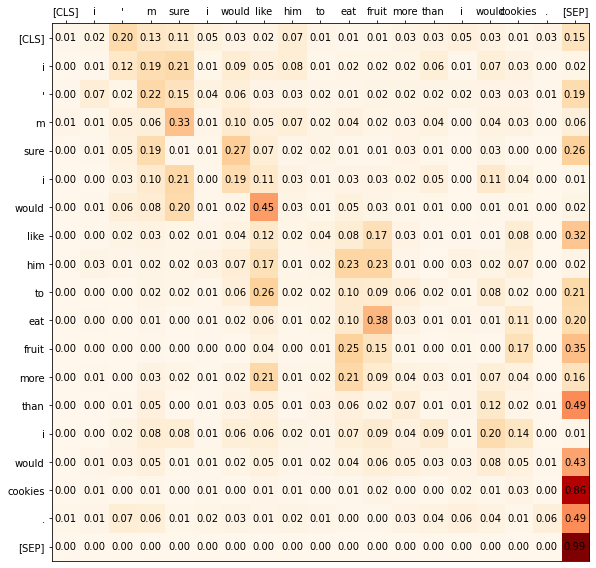

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_71 layer 7 head 3
Original Attention Across heads meaned


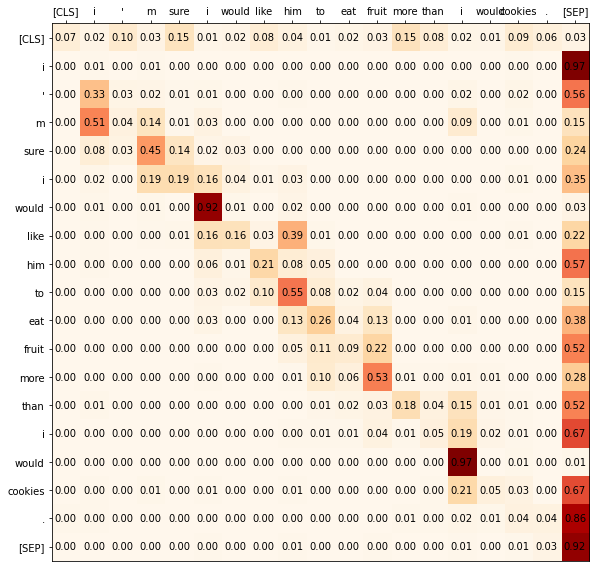

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_71 layer 8 head 0
Original Attention Across heads meaned


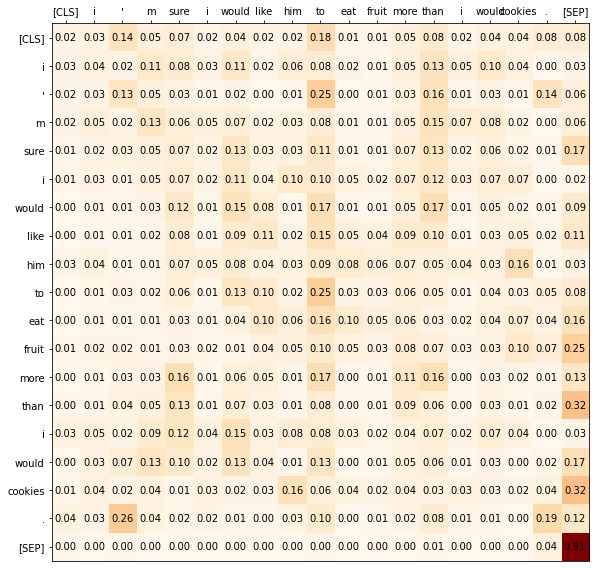

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_71 layer 10 head 0
Original Attention Across heads meaned


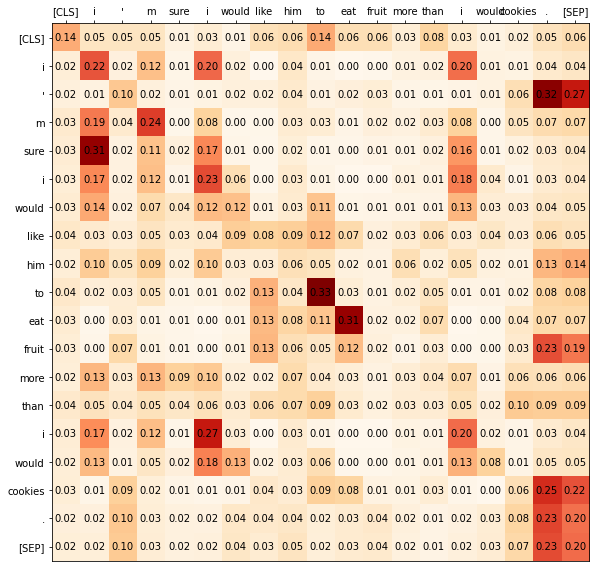

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_71 layer 10 head 1
Original Attention Across heads meaned


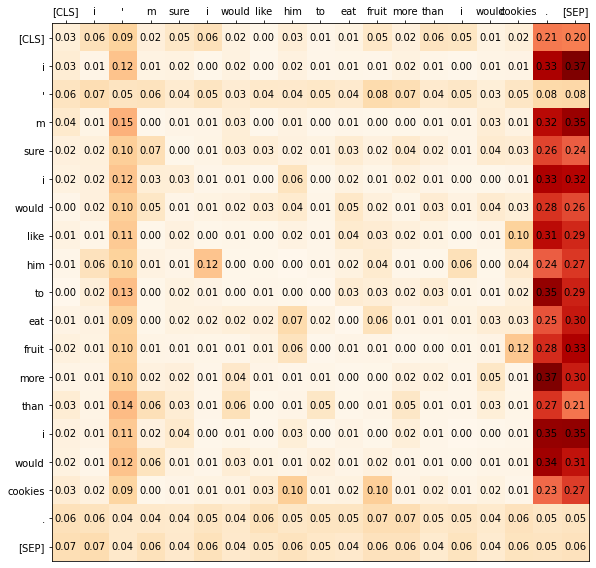

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_166 layer 0 head 0
Original Attention Across heads meaned


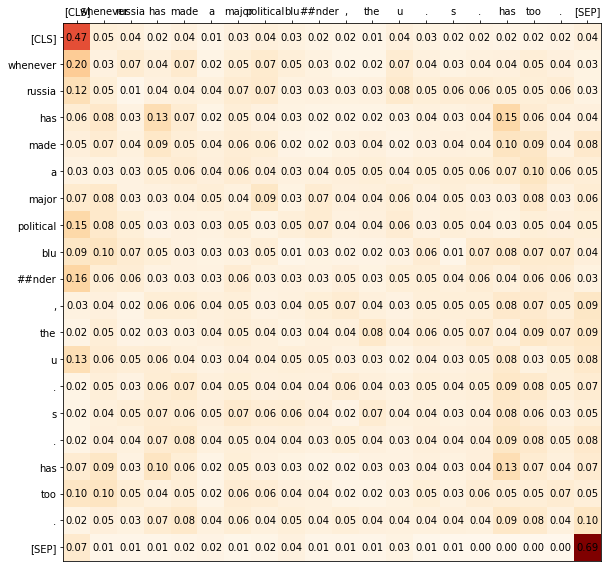

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_166 layer 0 head 1
Original Attention Across heads meaned


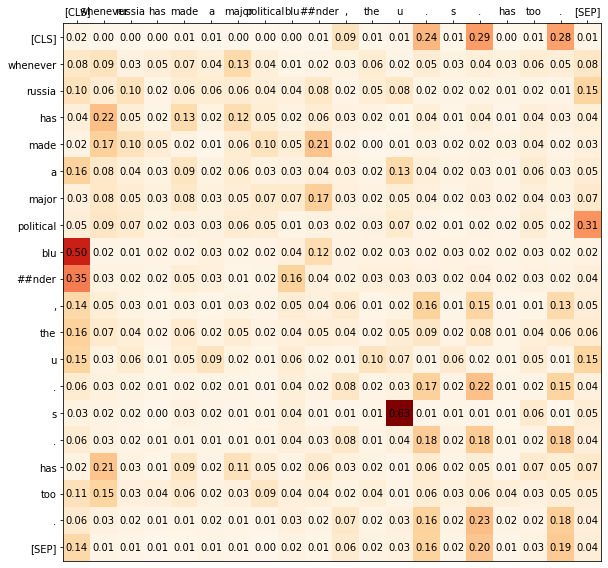

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_166 layer 0 head 2
Original Attention Across heads meaned


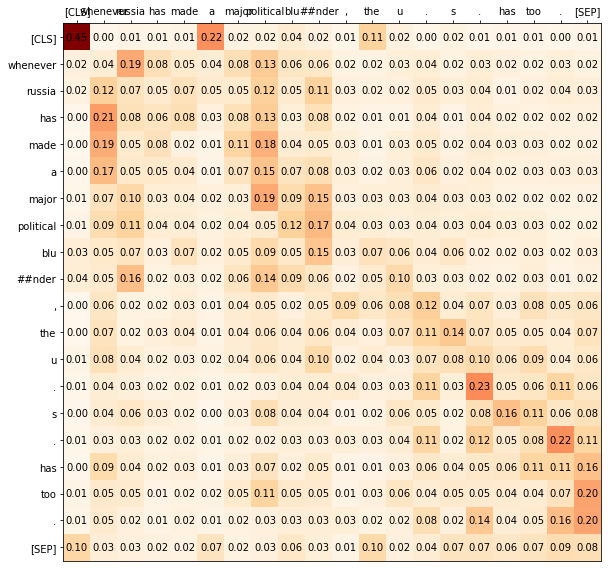

torch.Size([1, 1, 36, 36])
['block']
CoLA seed_166 layer 0 head 3
Original Attention Across heads meaned


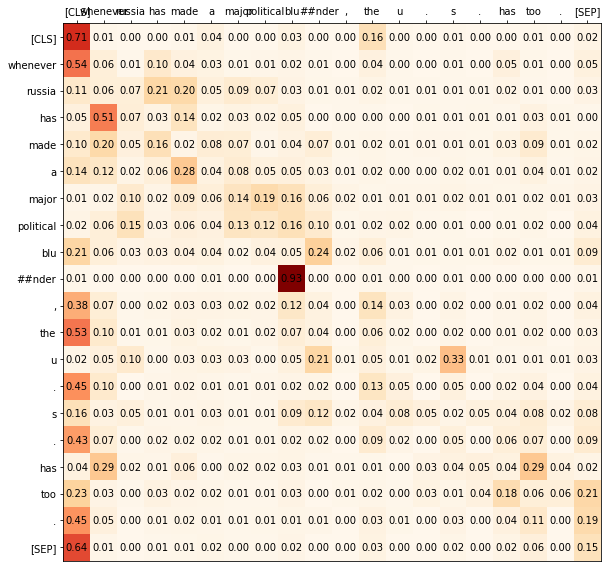

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_166 layer 1 head 0
Original Attention Across heads meaned


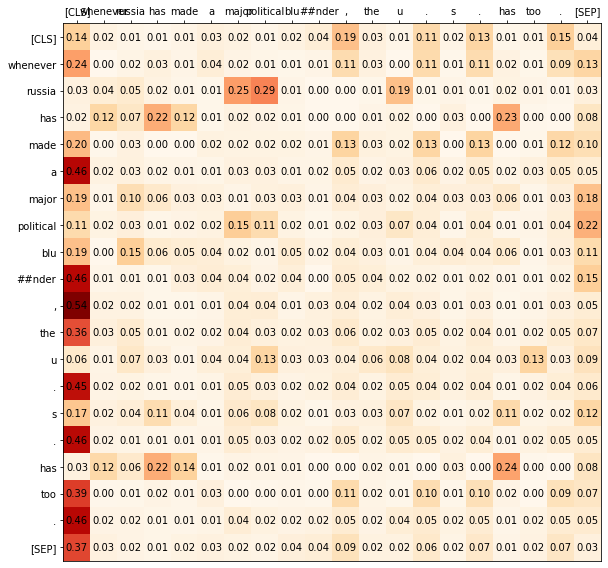

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_166 layer 1 head 1
Original Attention Across heads meaned


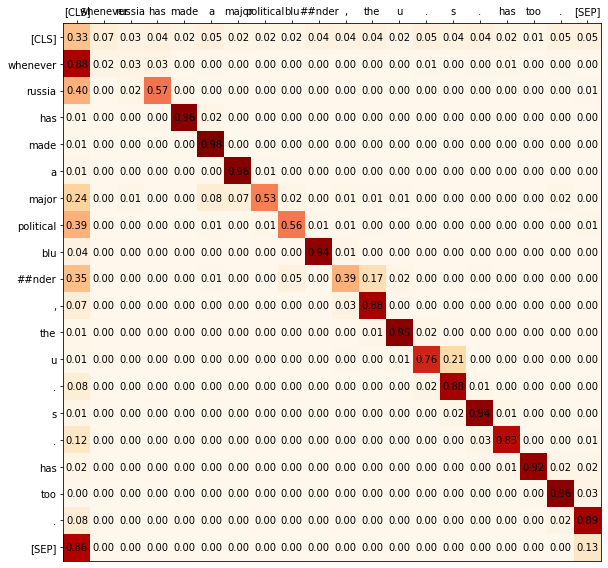

torch.Size([1, 1, 36, 36])
['diagonal']
CoLA seed_166 layer 1 head 2
Original Attention Across heads meaned


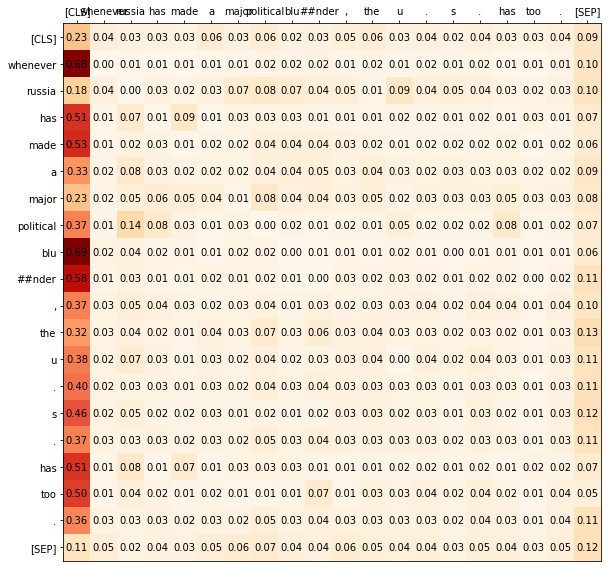

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_166 layer 1 head 3
Original Attention Across heads meaned


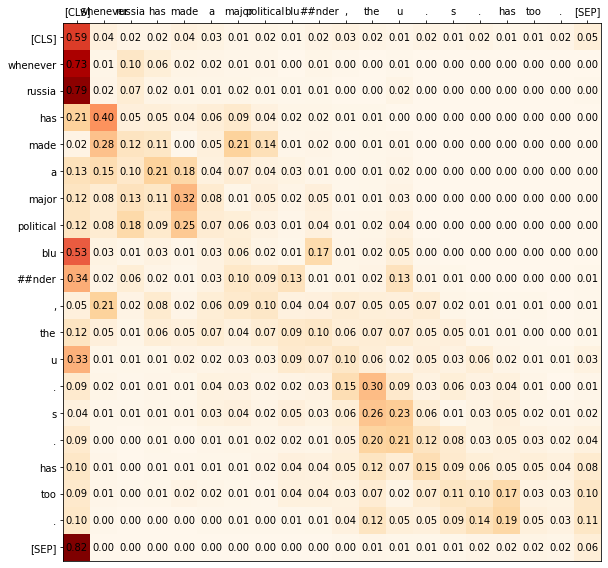

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_166 layer 1 head 4
Original Attention Across heads meaned


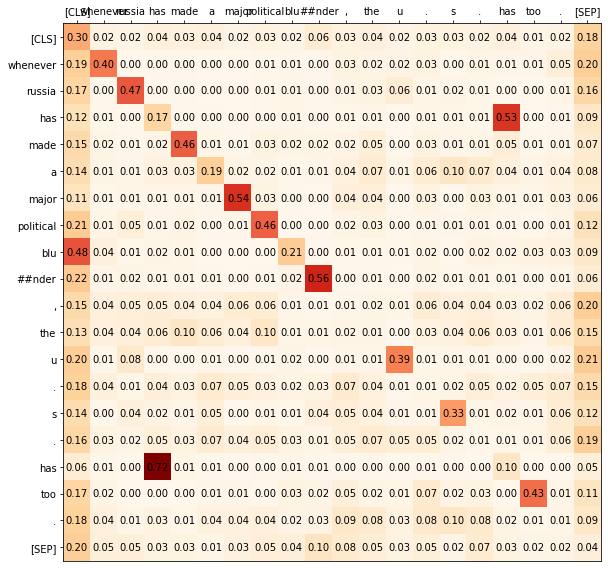

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_166 layer 2 head 0
Original Attention Across heads meaned


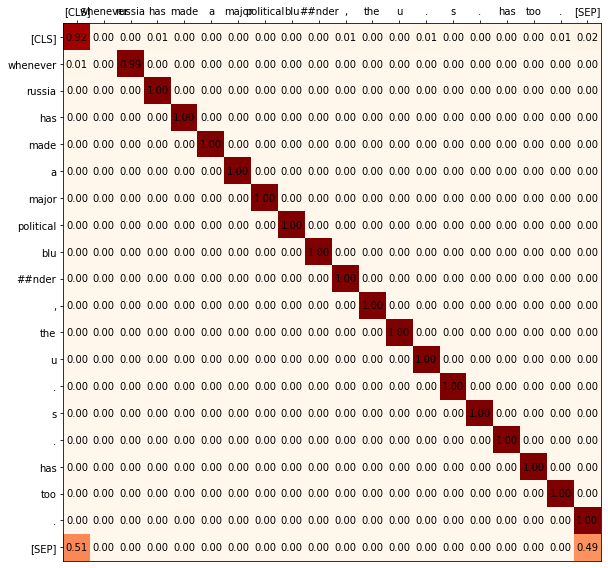

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_166 layer 2 head 1
Original Attention Across heads meaned


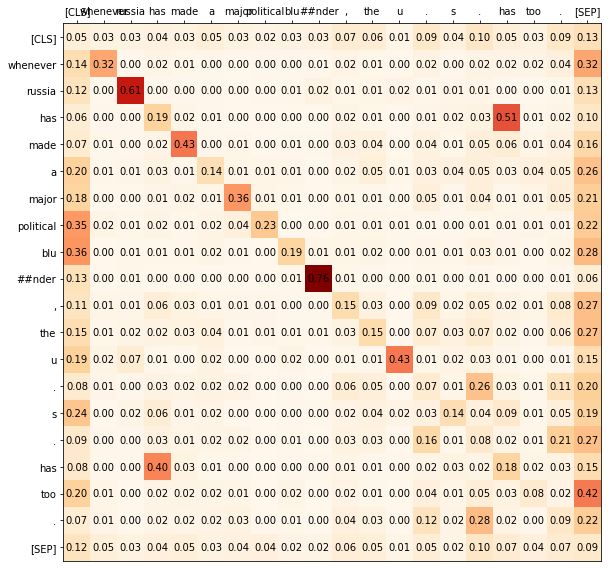

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_166 layer 3 head 0
Original Attention Across heads meaned


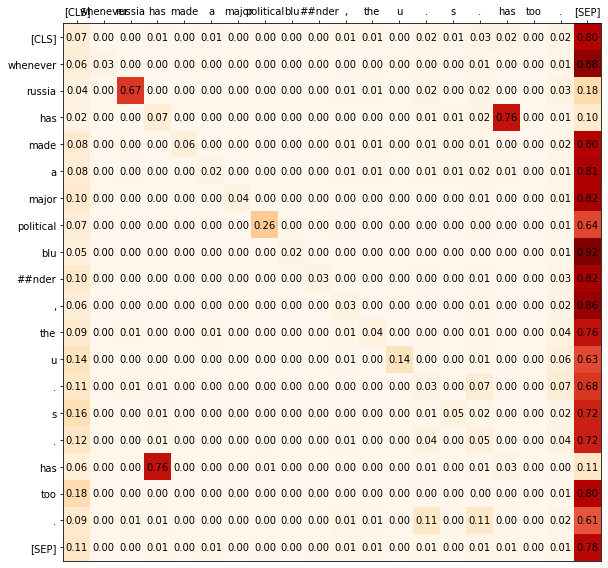

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_166 layer 3 head 1
Original Attention Across heads meaned


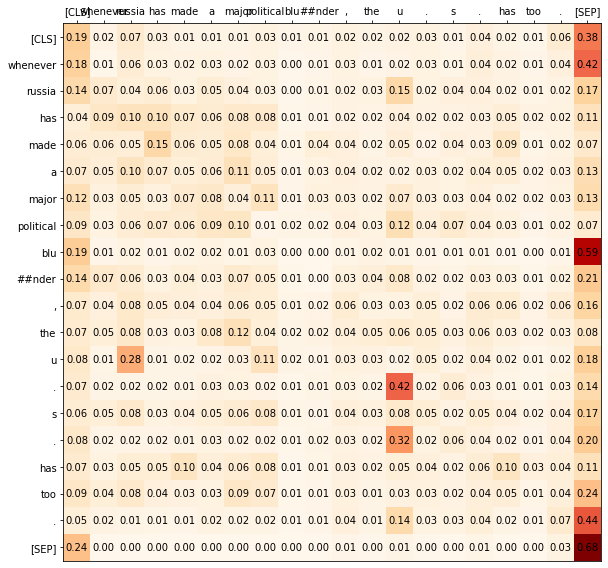

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_166 layer 3 head 2
Original Attention Across heads meaned


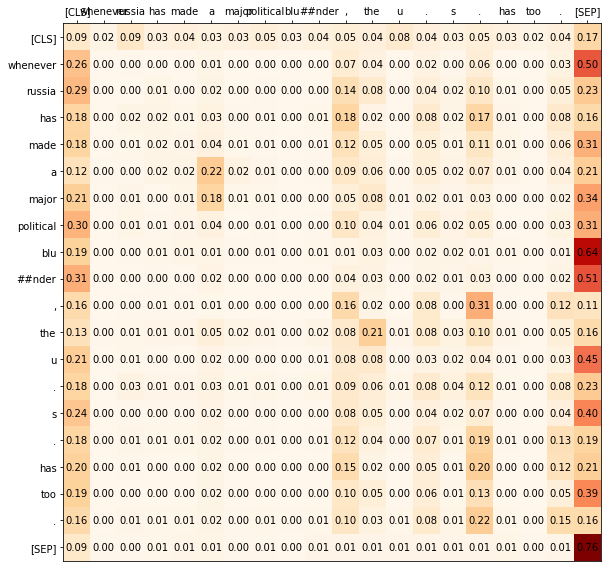

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_166 layer 3 head 3
Original Attention Across heads meaned


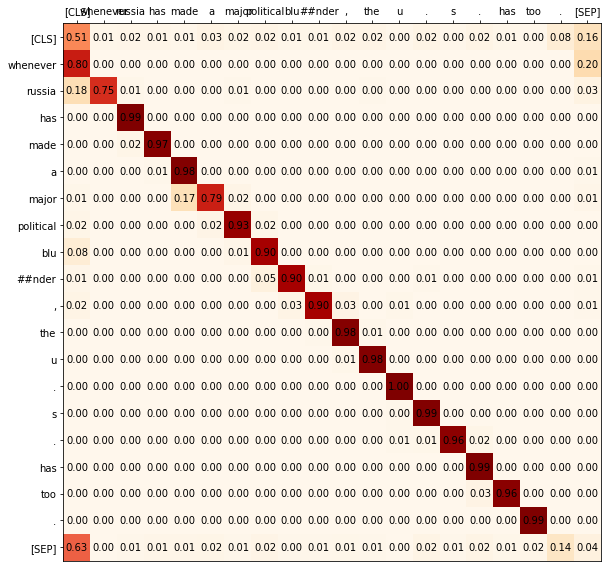

torch.Size([1, 1, 36, 36])
['diagonal']
CoLA seed_166 layer 3 head 4
Original Attention Across heads meaned


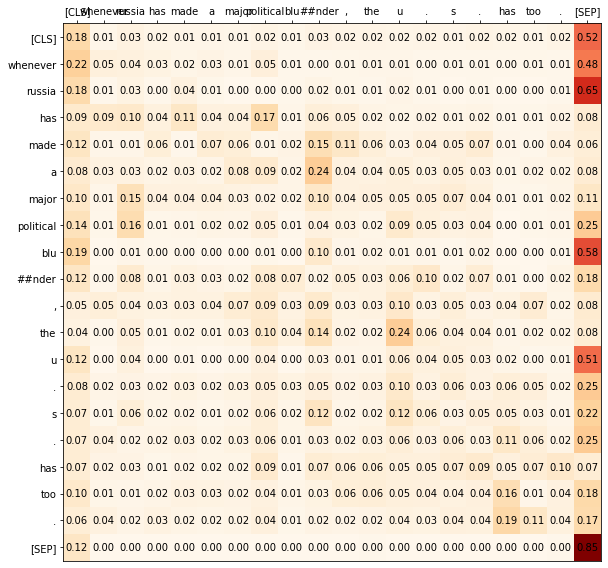

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_166 layer 4 head 0
Original Attention Across heads meaned


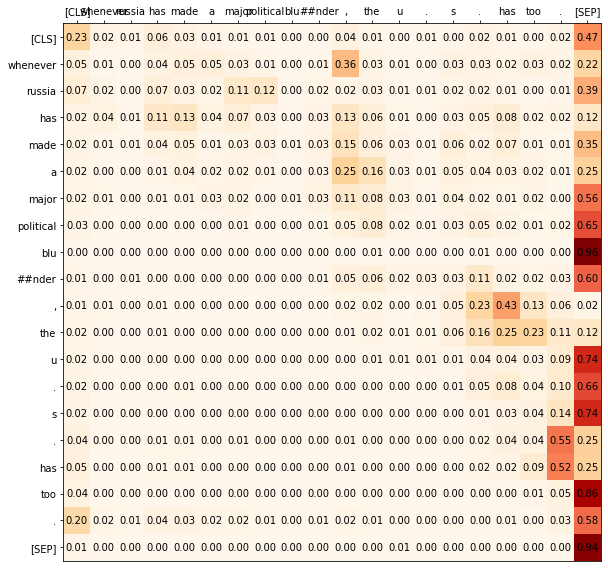

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_166 layer 4 head 1
Original Attention Across heads meaned


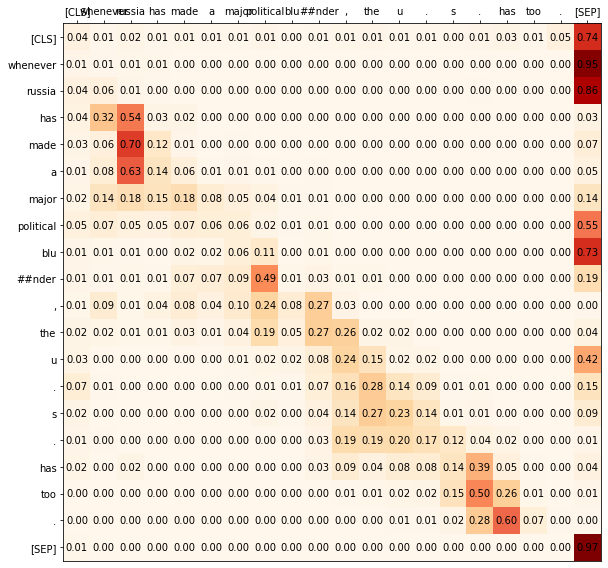

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_166 layer 5 head 0
Original Attention Across heads meaned


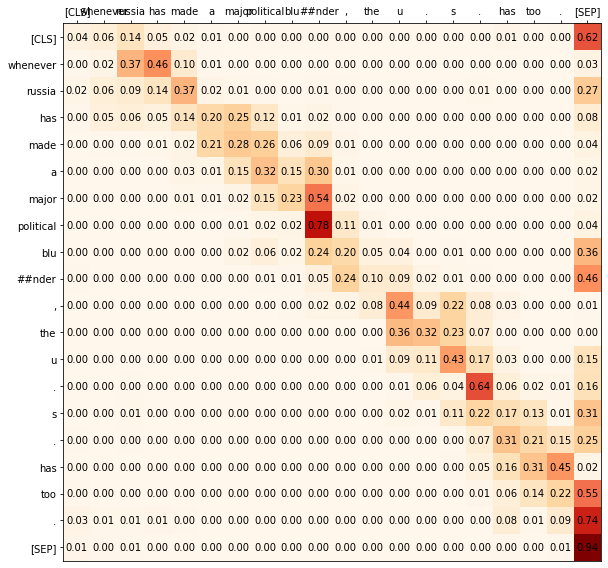

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_166 layer 5 head 1
Original Attention Across heads meaned


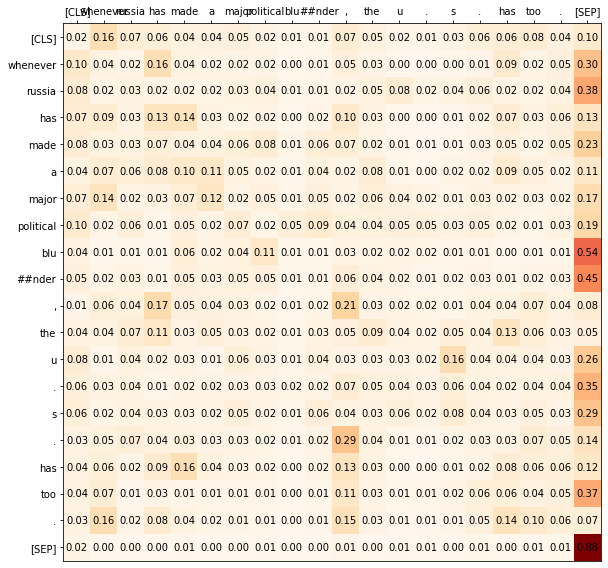

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_166 layer 5 head 2
Original Attention Across heads meaned


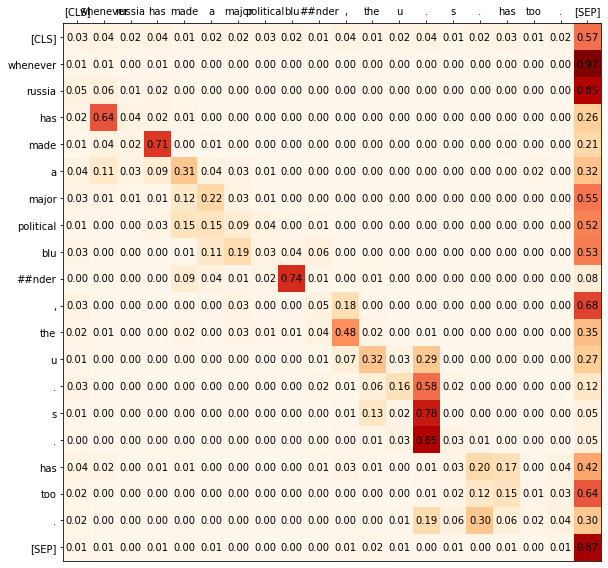

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_166 layer 5 head 3
Original Attention Across heads meaned


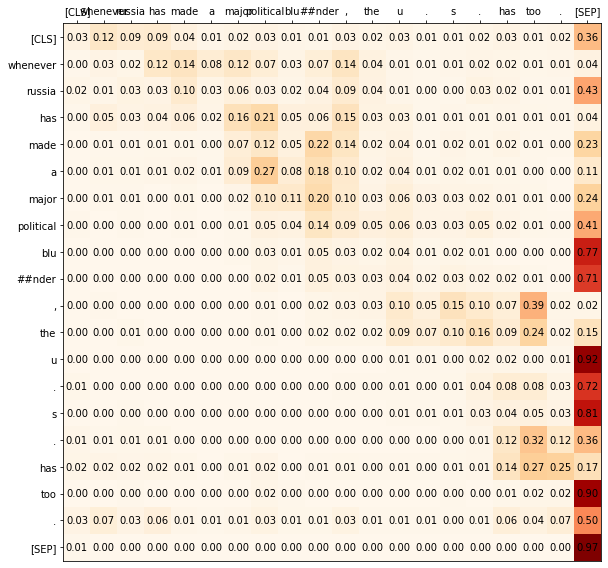

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_166 layer 5 head 4
Original Attention Across heads meaned


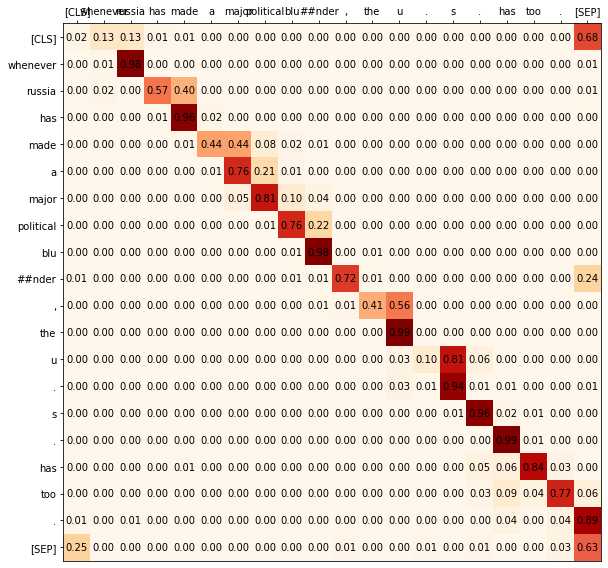

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_166 layer 6 head 0
Original Attention Across heads meaned


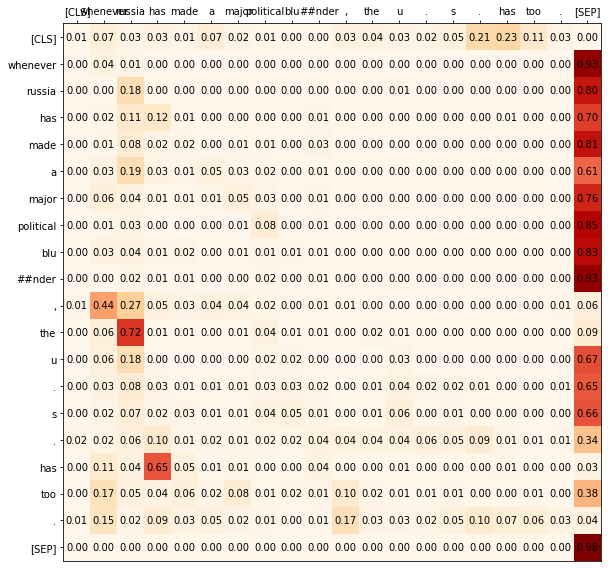

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_166 layer 6 head 1
Original Attention Across heads meaned


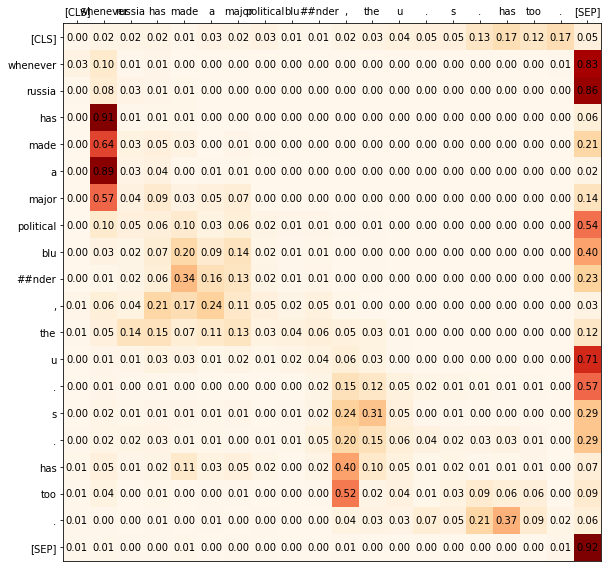

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_166 layer 6 head 2
Original Attention Across heads meaned


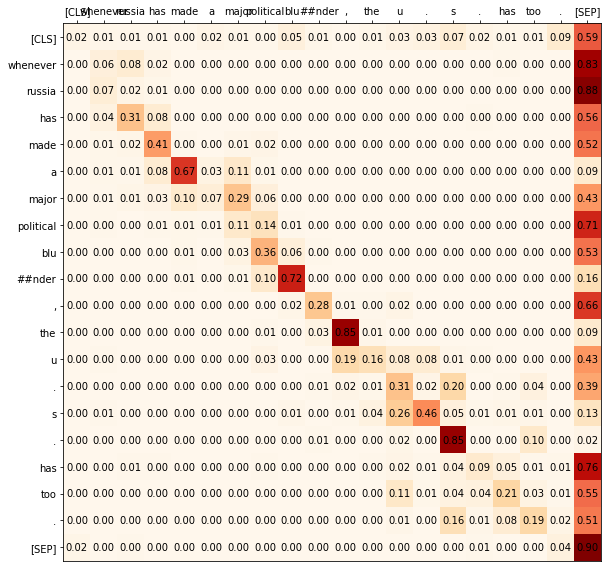

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_166 layer 6 head 3
Original Attention Across heads meaned


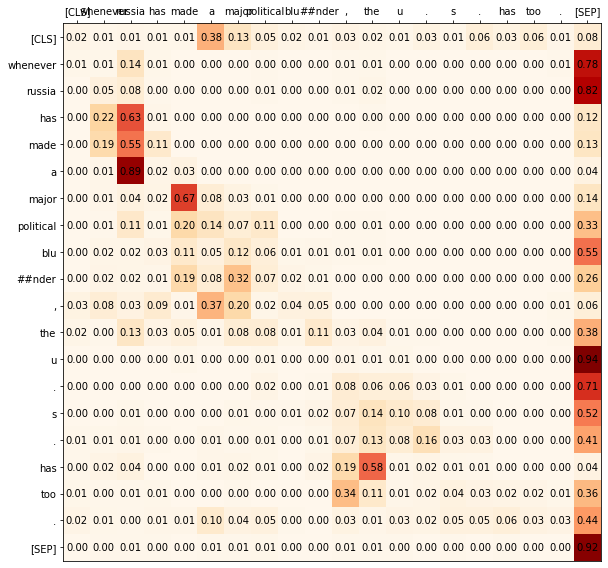

torch.Size([1, 1, 36, 36])
['vertical']
CoLA seed_166 layer 7 head 0
Original Attention Across heads meaned


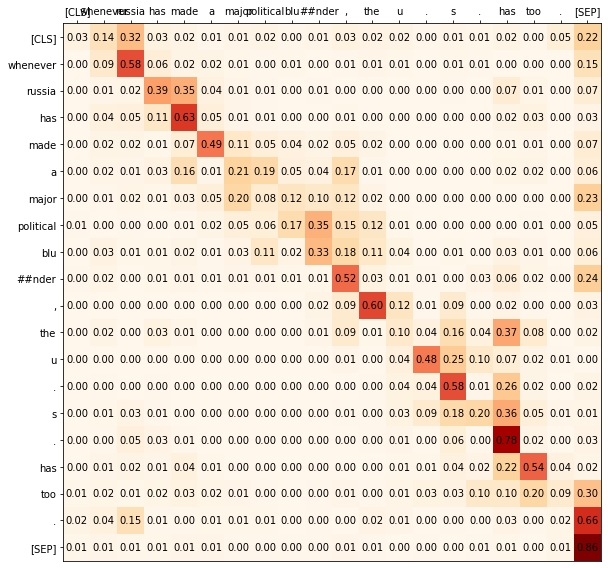

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_166 layer 7 head 1
Original Attention Across heads meaned


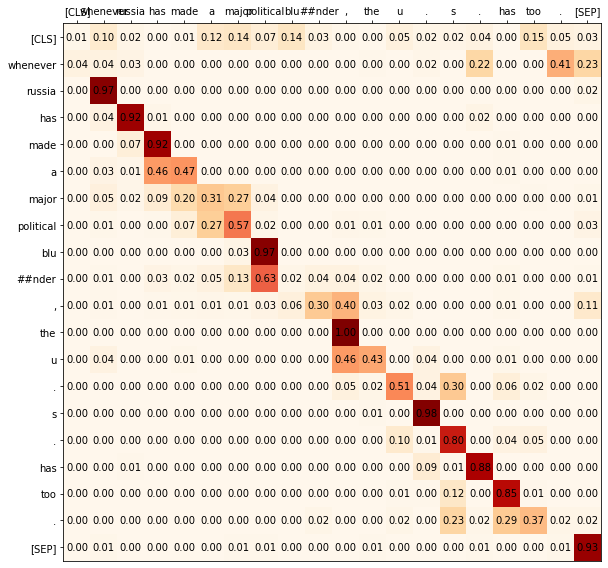

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_166 layer 7 head 2
Original Attention Across heads meaned


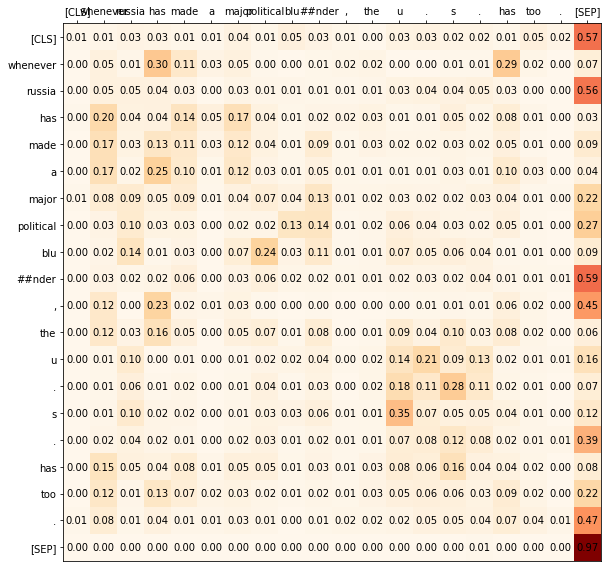

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_166 layer 7 head 3
Original Attention Across heads meaned


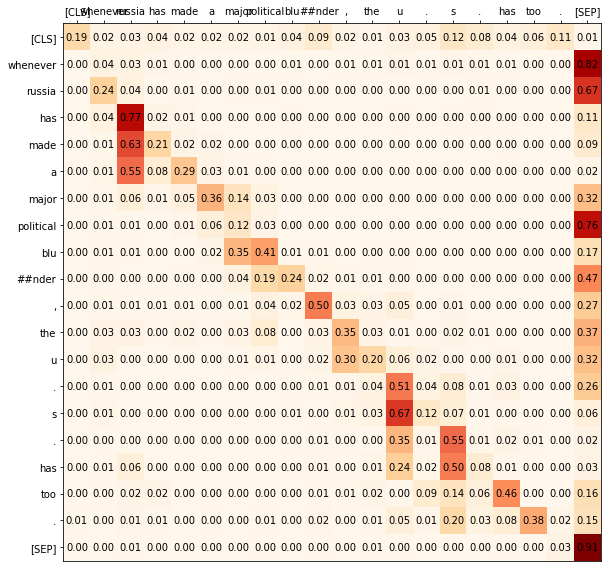

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_166 layer 8 head 0
Original Attention Across heads meaned


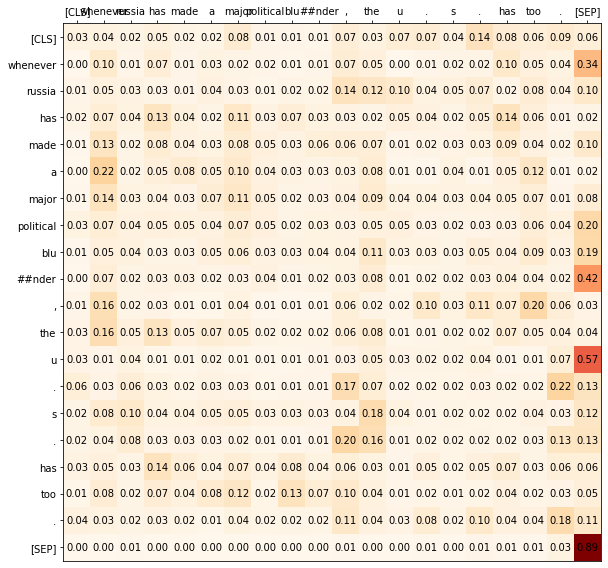

torch.Size([1, 1, 36, 36])
['mix']
CoLA seed_166 layer 10 head 0
Original Attention Across heads meaned


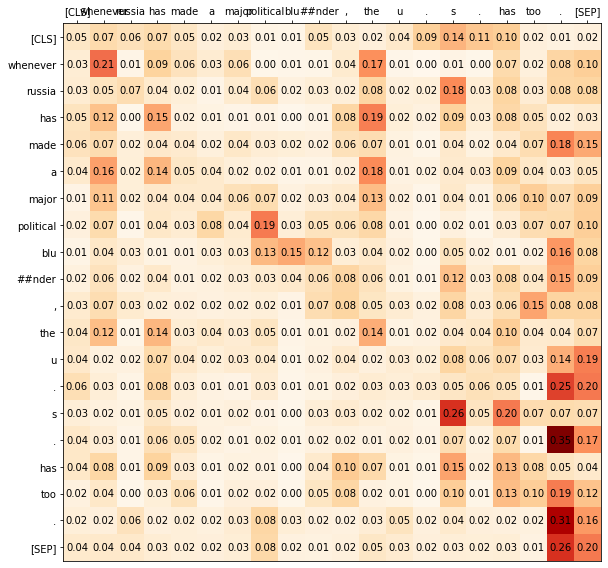

torch.Size([1, 1, 36, 36])
['other']
CoLA seed_166 layer 10 head 1
Original Attention Across heads meaned


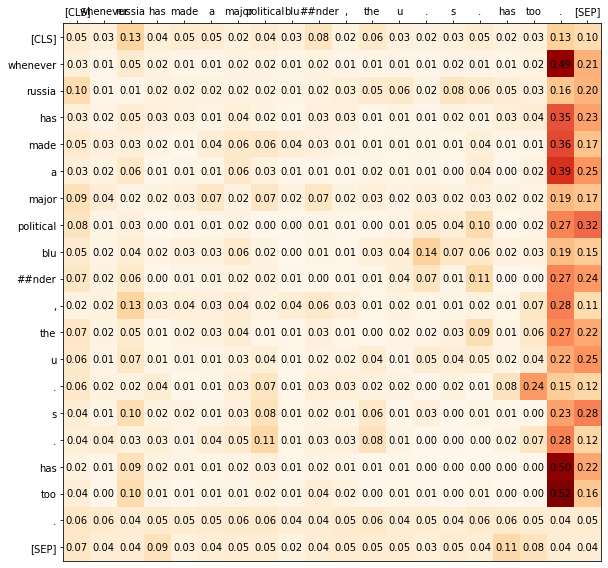

torch.Size([1, 1, 36, 36])
['vertical']
SST-2 seed_1337 layer 1 head 0
Original Attention Across heads meaned


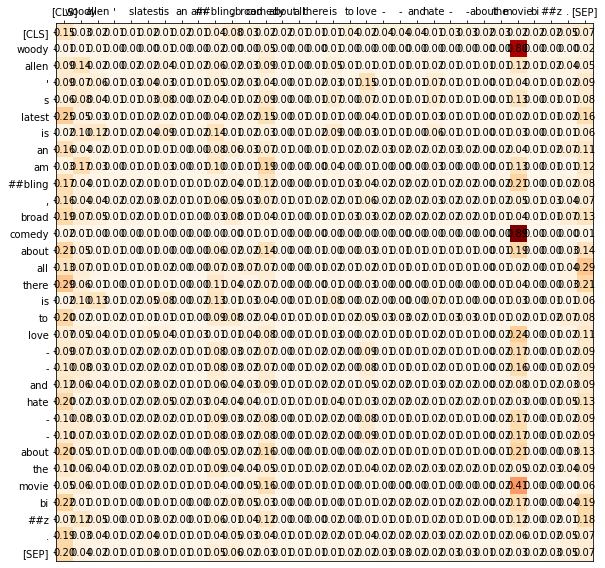

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_1337 layer 1 head 1
Original Attention Across heads meaned


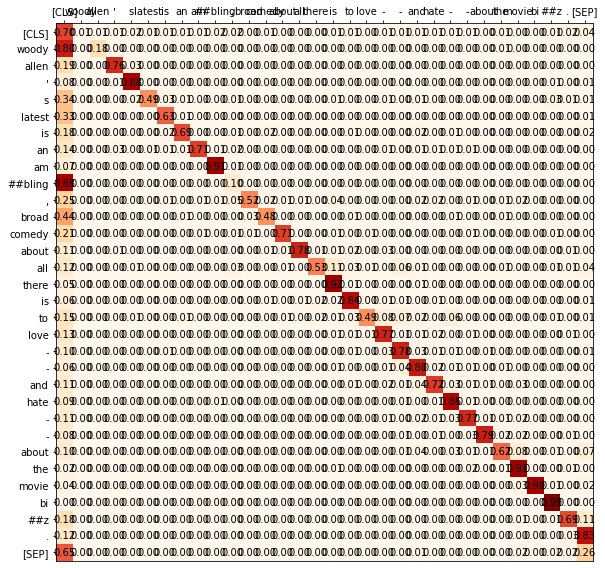

torch.Size([1, 1, 36, 36])
['diagonal']
SST-2 seed_1337 layer 2 head 0
Original Attention Across heads meaned


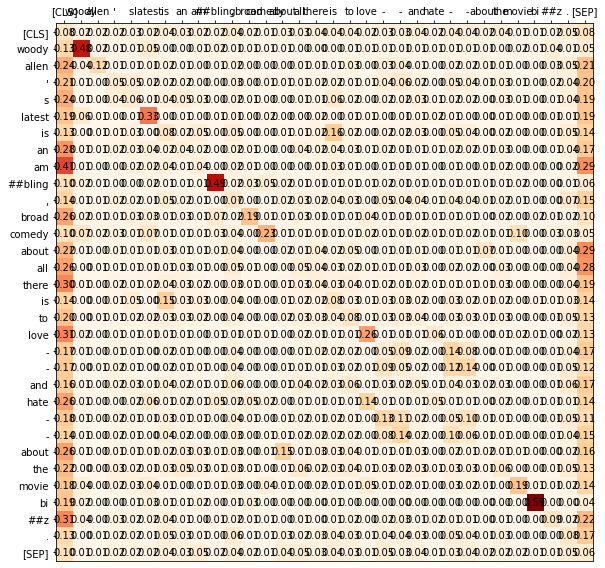

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_1337 layer 3 head 0
Original Attention Across heads meaned


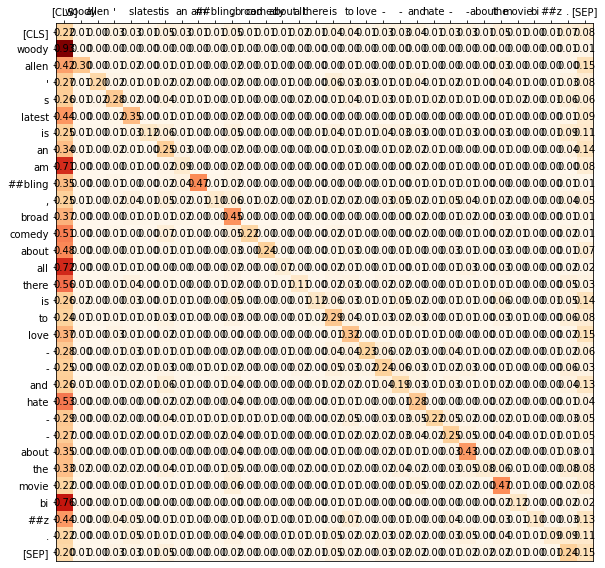

torch.Size([1, 1, 36, 36])
['diagonal']
SST-2 seed_1337 layer 4 head 0
Original Attention Across heads meaned


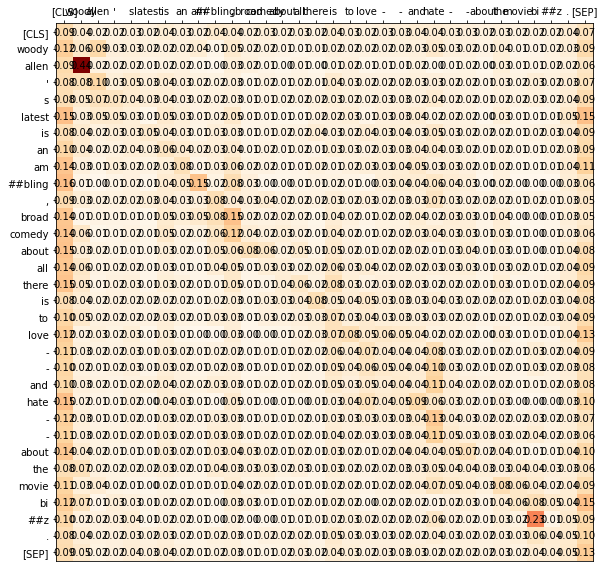

torch.Size([1, 1, 36, 36])
['block']
SST-2 seed_1337 layer 5 head 0
Original Attention Across heads meaned


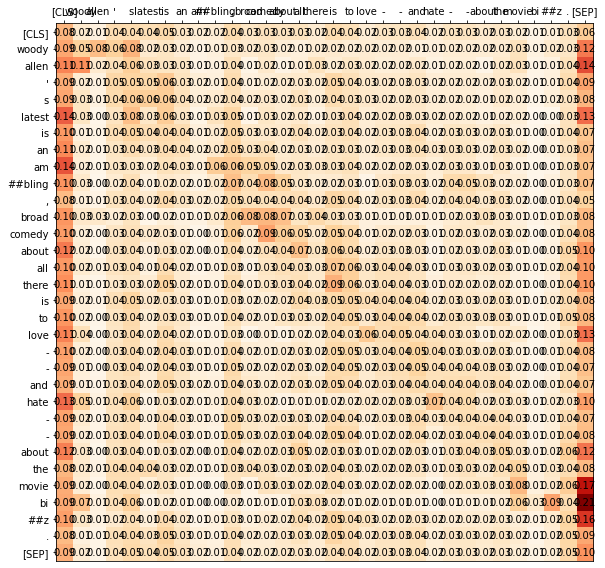

torch.Size([1, 1, 36, 36])
['block']
SST-2 seed_1337 layer 5 head 1
Original Attention Across heads meaned


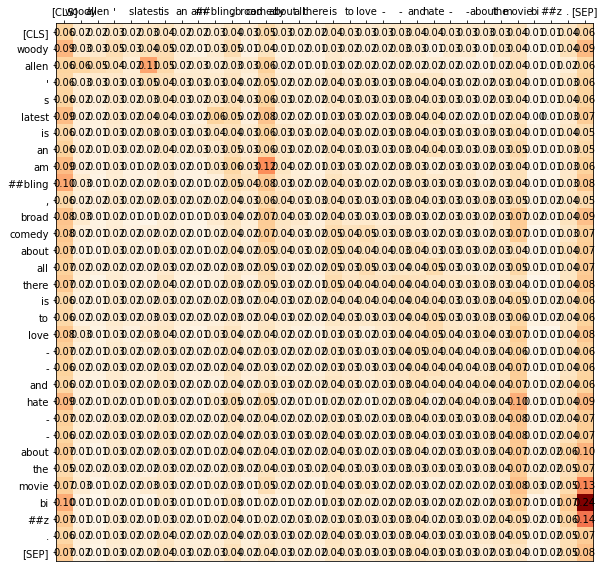

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_1337 layer 6 head 0
Original Attention Across heads meaned


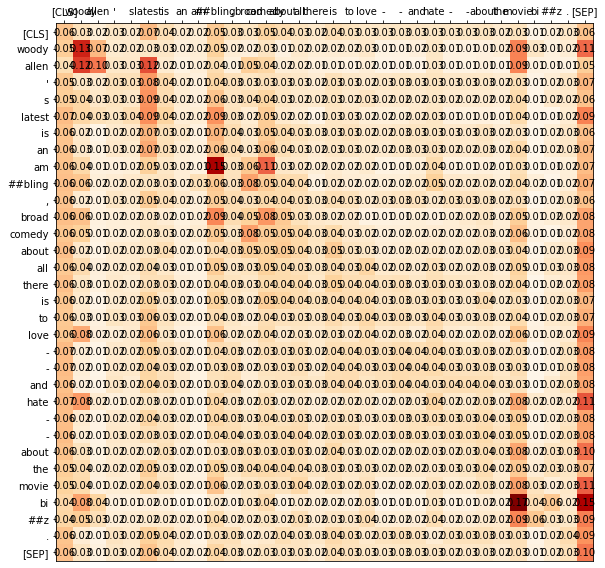

torch.Size([1, 1, 36, 36])
['block']
SST-2 seed_1337 layer 7 head 0
Original Attention Across heads meaned


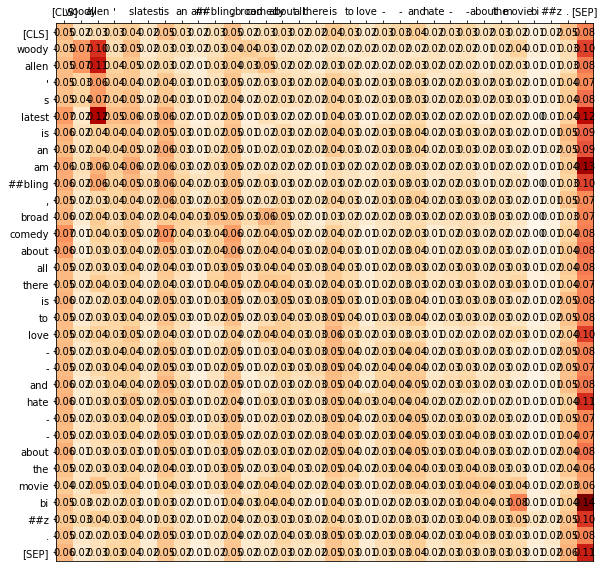

torch.Size([1, 1, 36, 36])
['block']
SST-2 seed_1337 layer 7 head 1
Original Attention Across heads meaned


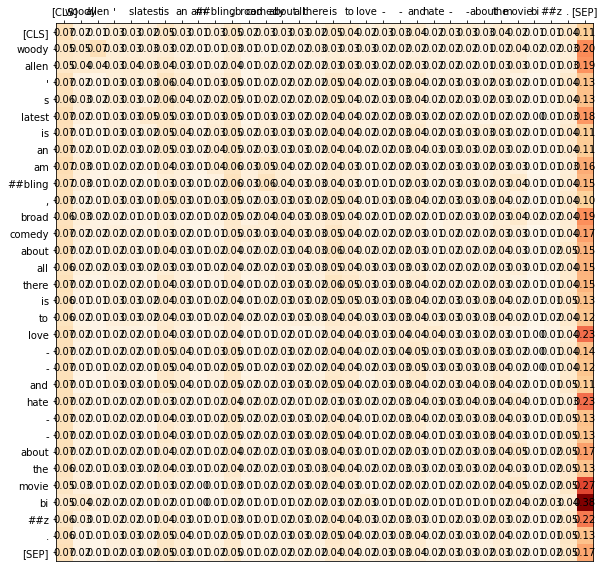

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_1337 layer 7 head 2
Original Attention Across heads meaned


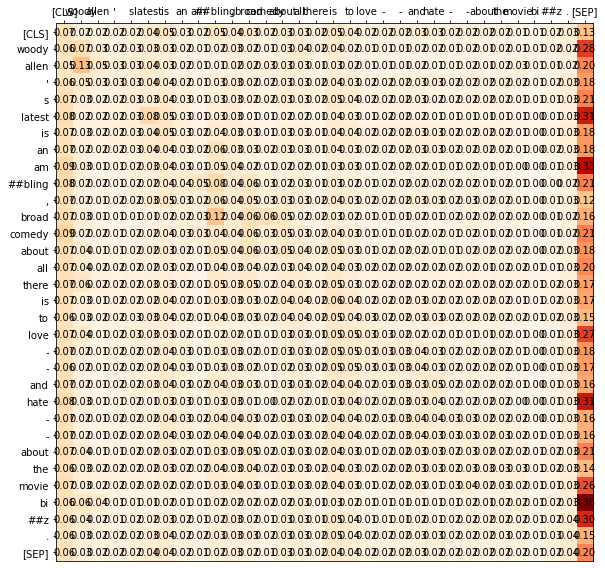

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_1337 layer 7 head 3
Original Attention Across heads meaned


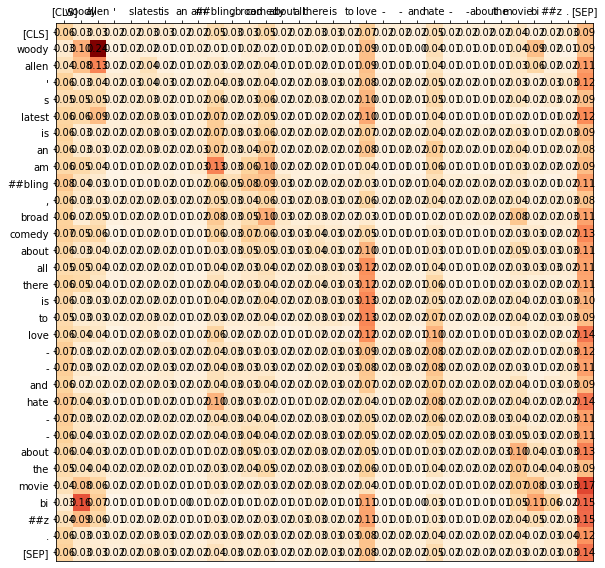

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_1337 layer 8 head 0
Original Attention Across heads meaned


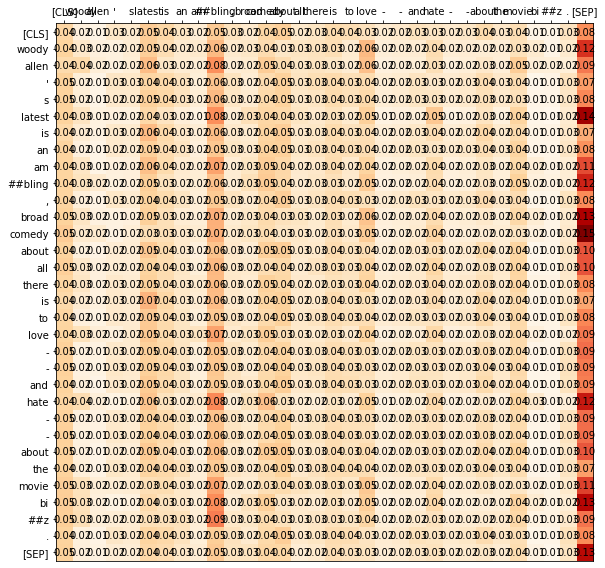

torch.Size([1, 1, 36, 36])
['block']
SST-2 seed_1337 layer 8 head 1
Original Attention Across heads meaned


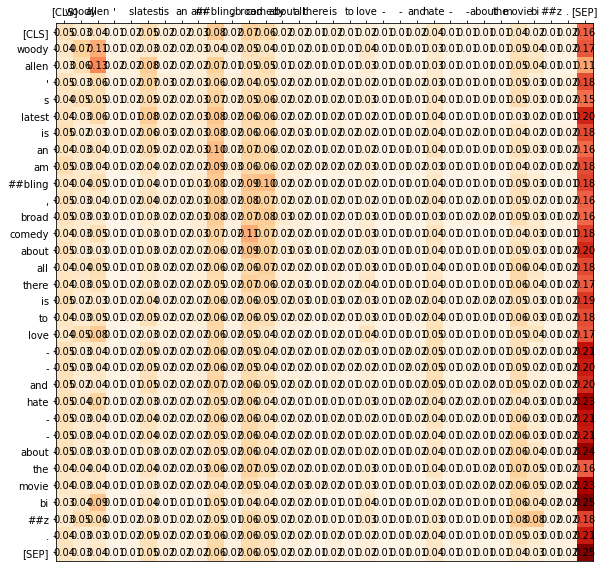

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_1337 layer 9 head 0
Original Attention Across heads meaned


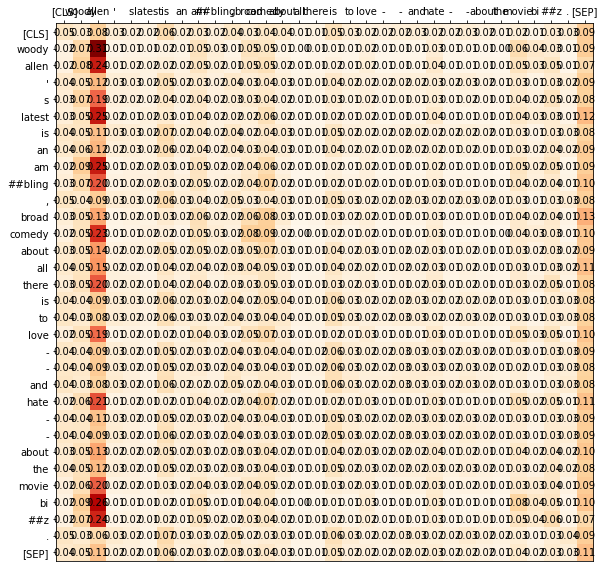

torch.Size([1, 1, 36, 36])
['block']
SST-2 seed_1337 layer 9 head 1
Original Attention Across heads meaned


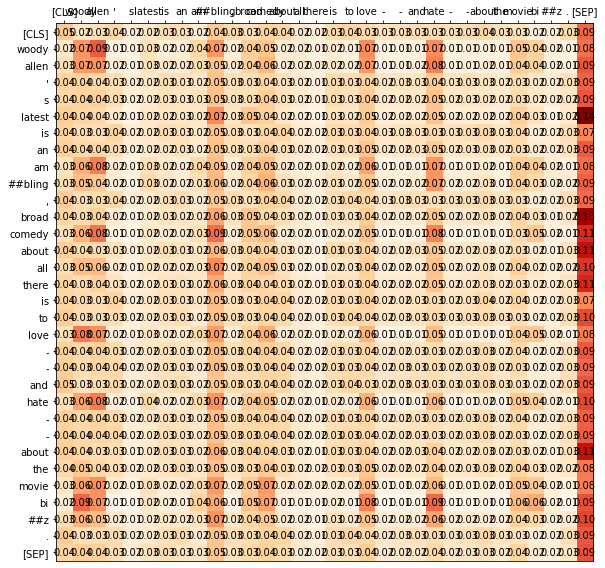

torch.Size([1, 1, 36, 36])
['block']
SST-2 seed_1337 layer 10 head 0
Original Attention Across heads meaned


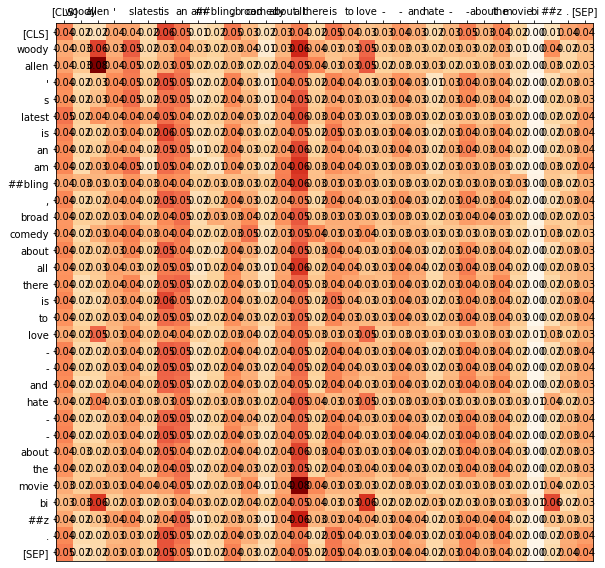

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_1337 layer 10 head 1
Original Attention Across heads meaned


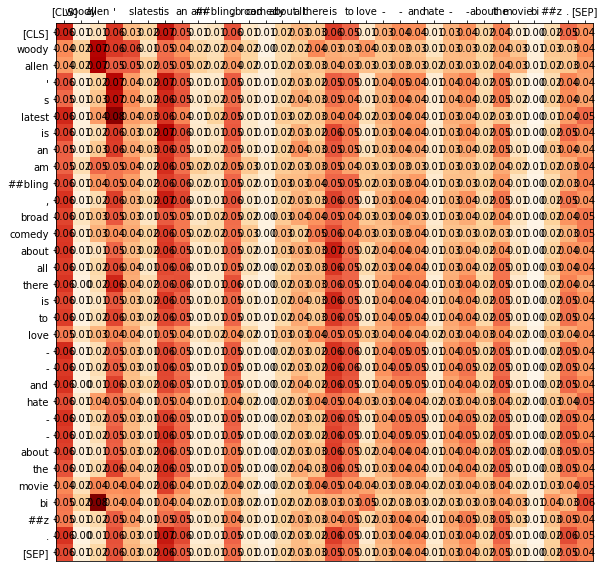

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_1337 layer 11 head 0
Original Attention Across heads meaned


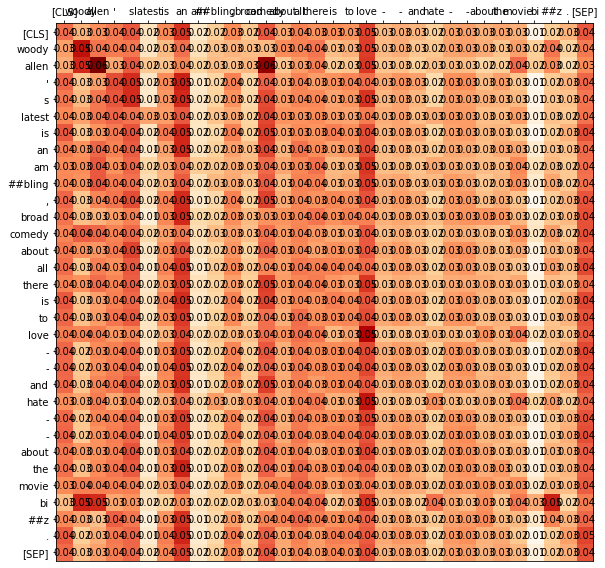

torch.Size([1, 1, 36, 36])
['block']
SST-2 seed_42 layer 1 head 0
Original Attention Across heads meaned


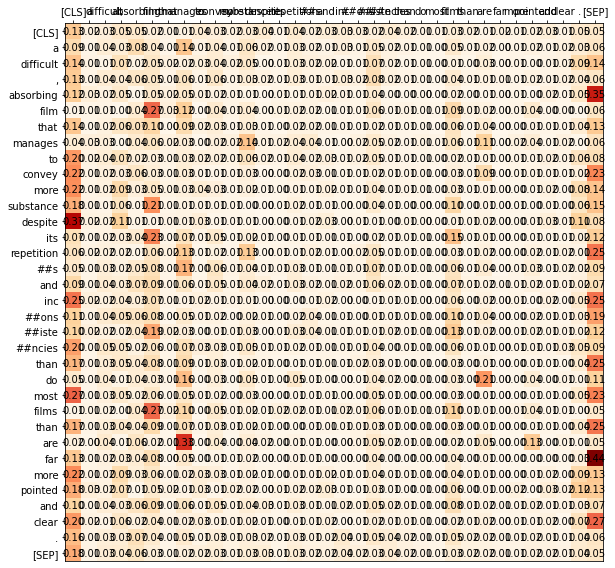

torch.Size([1, 1, 36, 36])
['block']
SST-2 seed_42 layer 1 head 1
Original Attention Across heads meaned


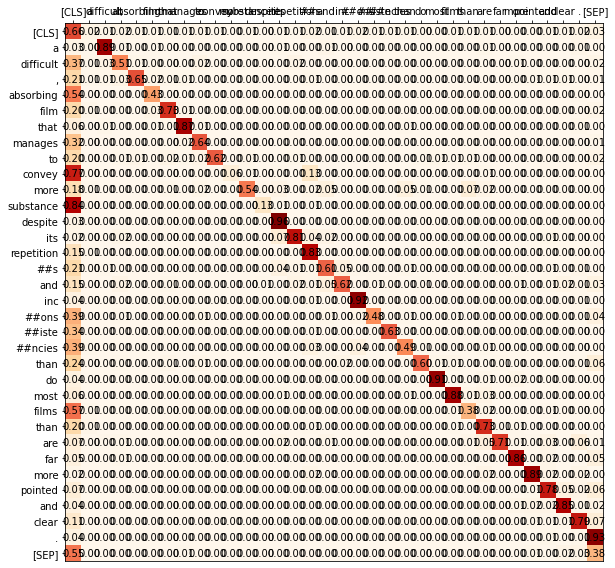

torch.Size([1, 1, 36, 36])
['diagonal']
SST-2 seed_42 layer 2 head 0
Original Attention Across heads meaned


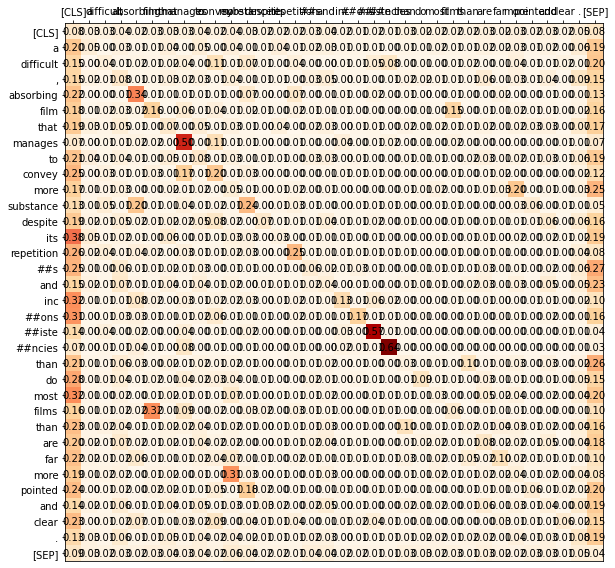

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_42 layer 3 head 0
Original Attention Across heads meaned


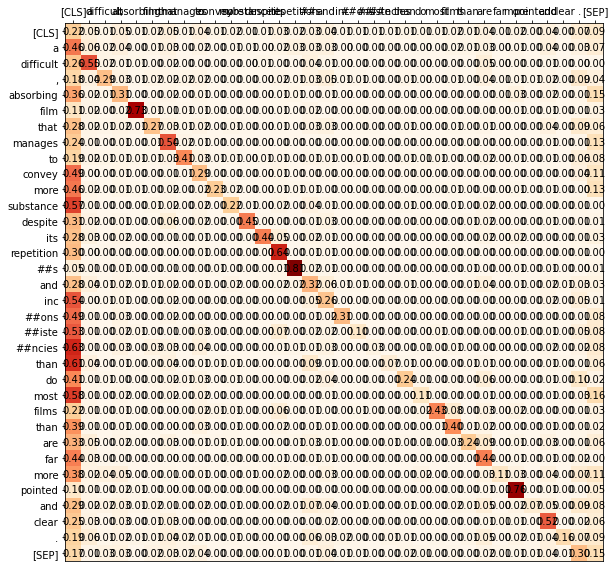

torch.Size([1, 1, 36, 36])
['diagonal']
SST-2 seed_42 layer 4 head 0
Original Attention Across heads meaned


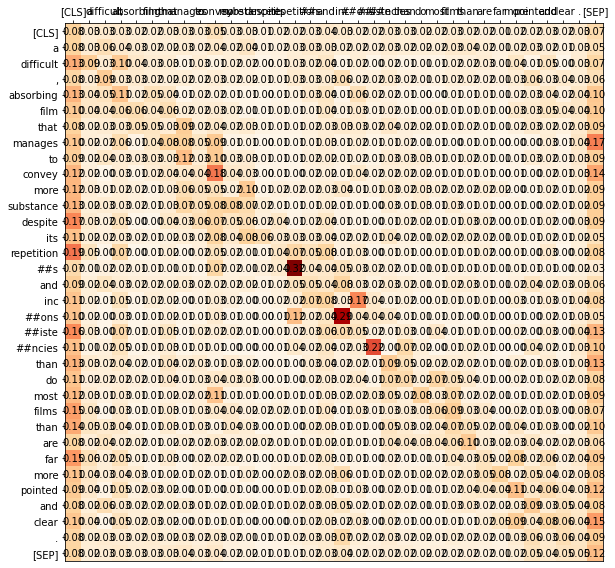

torch.Size([1, 1, 36, 36])
['diagonal']
SST-2 seed_42 layer 5 head 0
Original Attention Across heads meaned


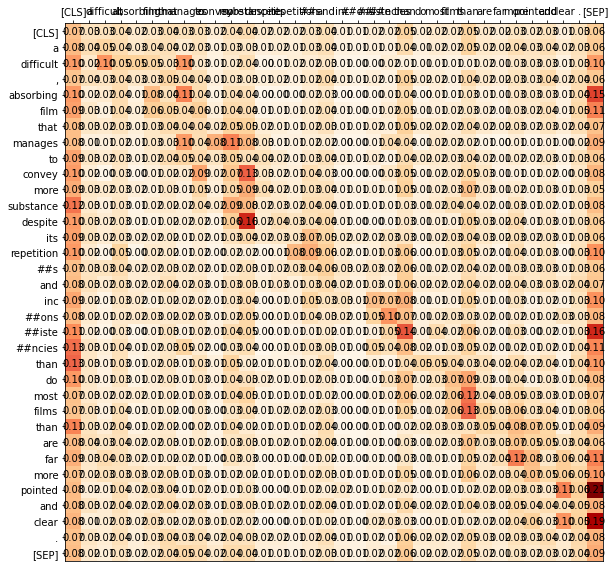

torch.Size([1, 1, 36, 36])
['diagonal']
SST-2 seed_42 layer 5 head 1
Original Attention Across heads meaned


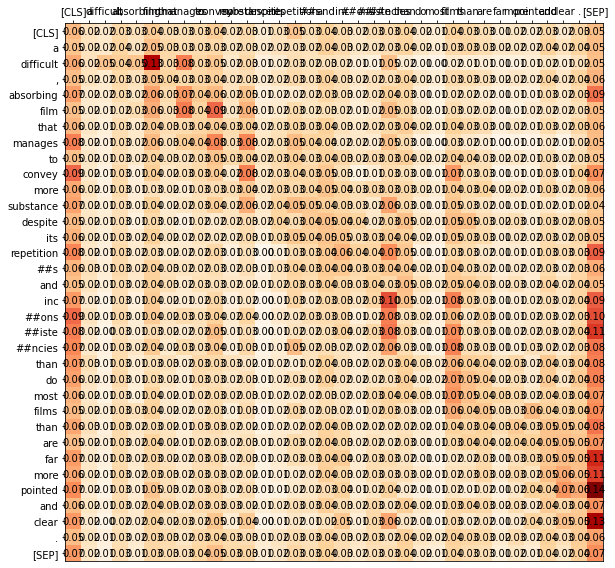

torch.Size([1, 1, 36, 36])
['block']
SST-2 seed_42 layer 6 head 0
Original Attention Across heads meaned


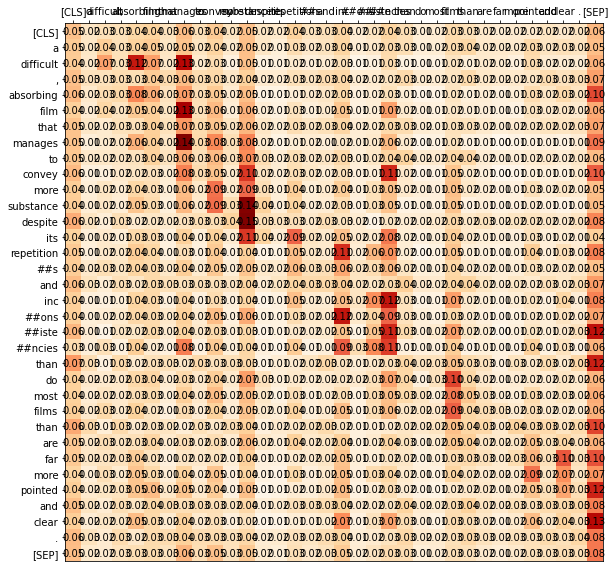

torch.Size([1, 1, 36, 36])
['block']
SST-2 seed_42 layer 7 head 0
Original Attention Across heads meaned


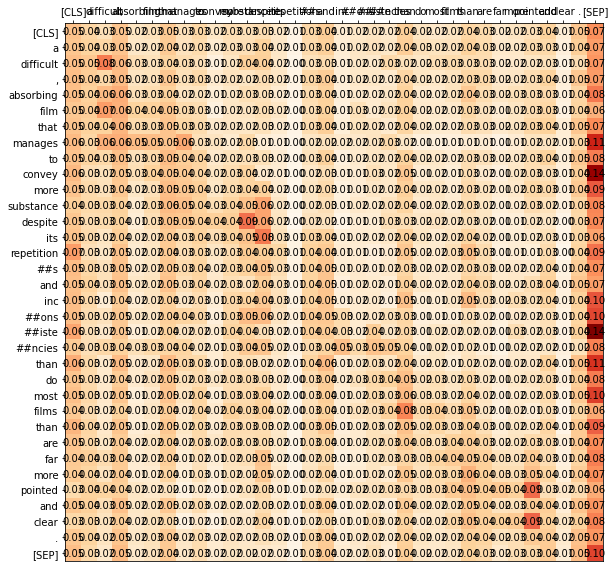

torch.Size([1, 1, 36, 36])
['block']
SST-2 seed_42 layer 7 head 1
Original Attention Across heads meaned


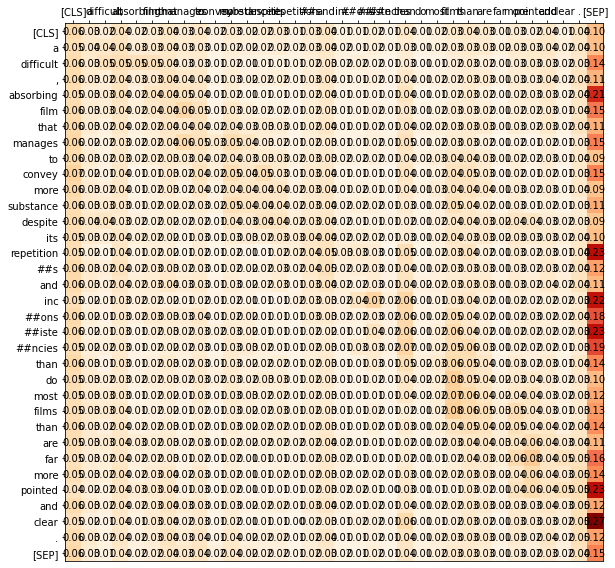

torch.Size([1, 1, 36, 36])
['block']
SST-2 seed_42 layer 7 head 2
Original Attention Across heads meaned


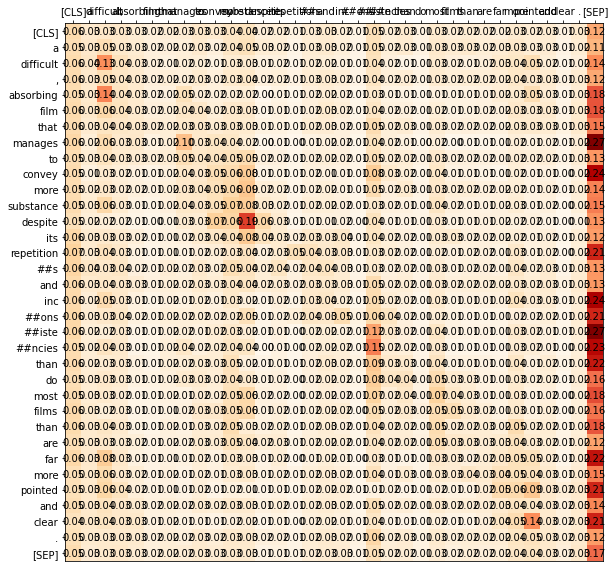

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_42 layer 7 head 3
Original Attention Across heads meaned


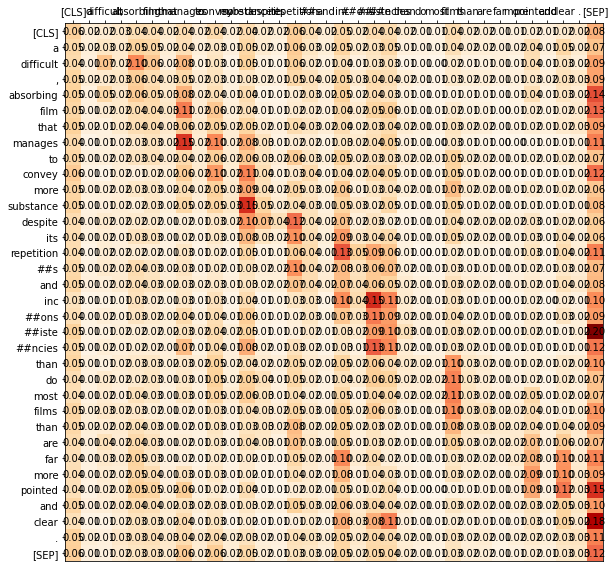

torch.Size([1, 1, 36, 36])
['block']
SST-2 seed_42 layer 8 head 0
Original Attention Across heads meaned


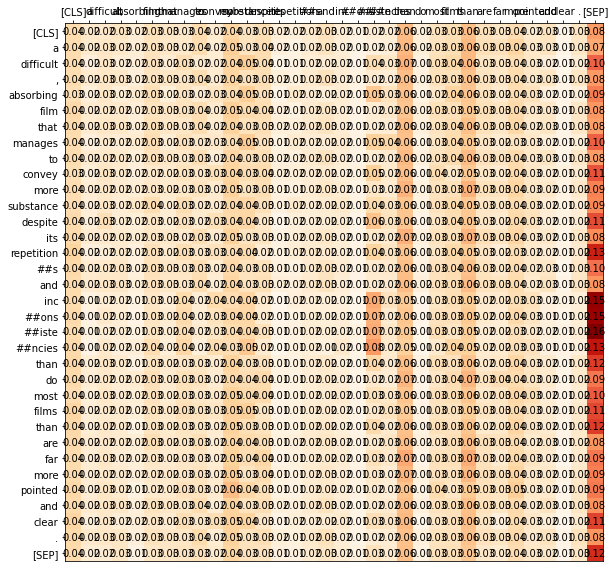

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_42 layer 8 head 1
Original Attention Across heads meaned


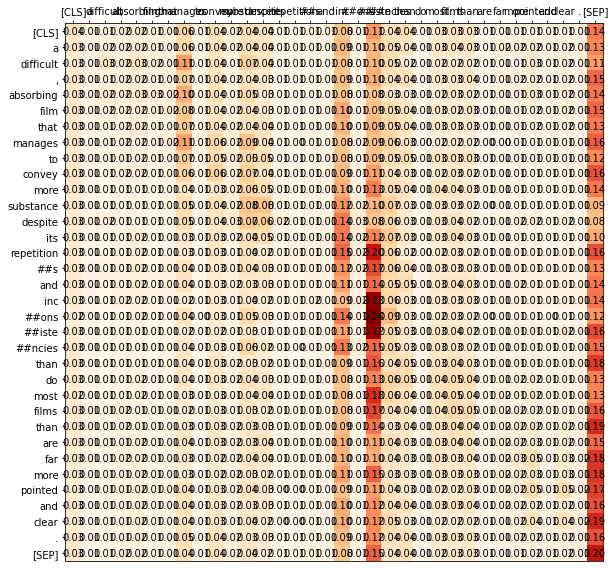

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_42 layer 9 head 0
Original Attention Across heads meaned


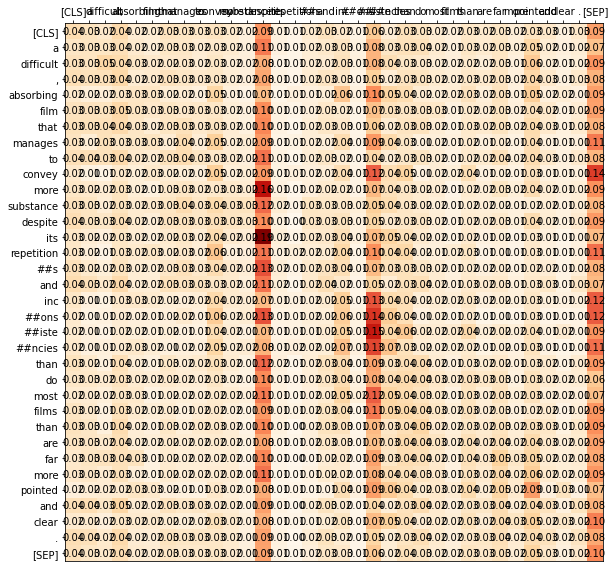

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_42 layer 9 head 1
Original Attention Across heads meaned


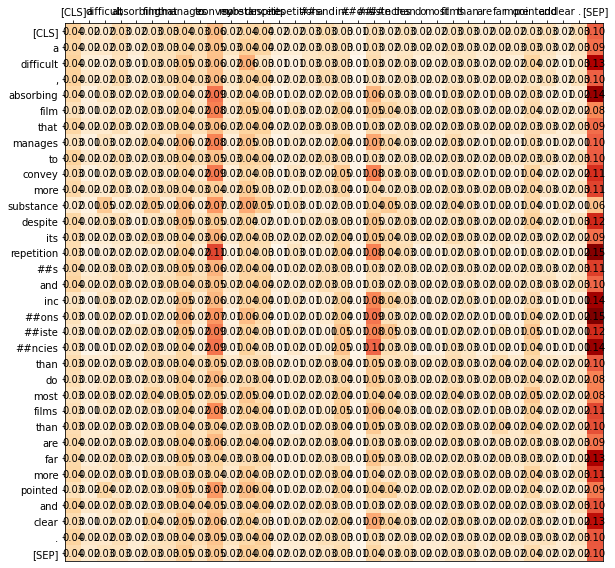

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_42 layer 10 head 0
Original Attention Across heads meaned


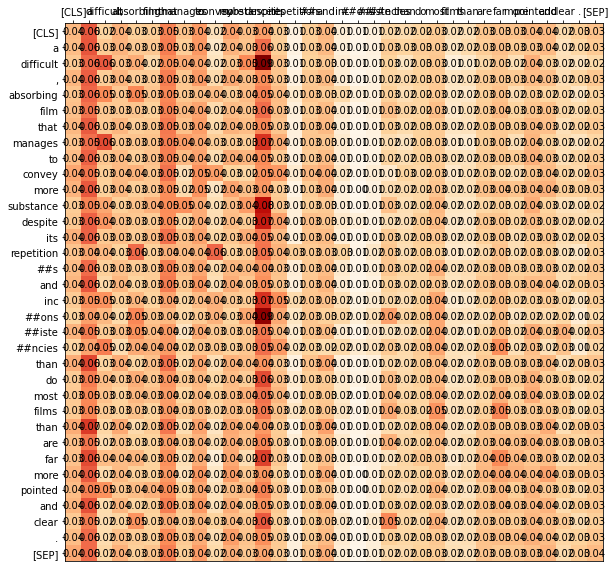

torch.Size([1, 1, 36, 36])
['block']
SST-2 seed_42 layer 10 head 1
Original Attention Across heads meaned


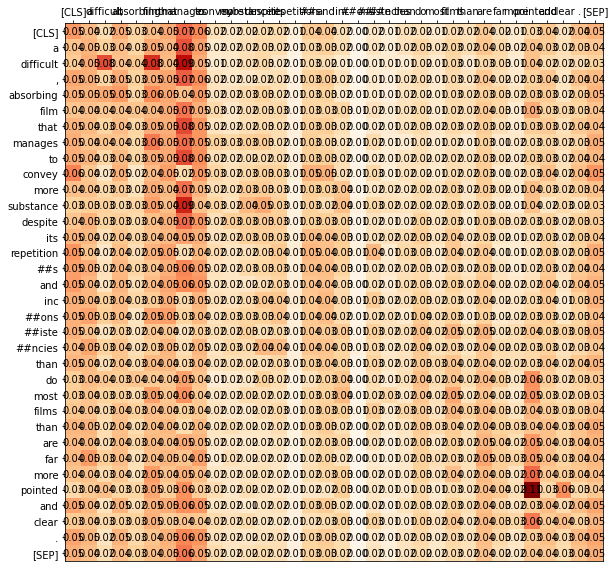

torch.Size([1, 1, 36, 36])
['block']
SST-2 seed_42 layer 11 head 0
Original Attention Across heads meaned


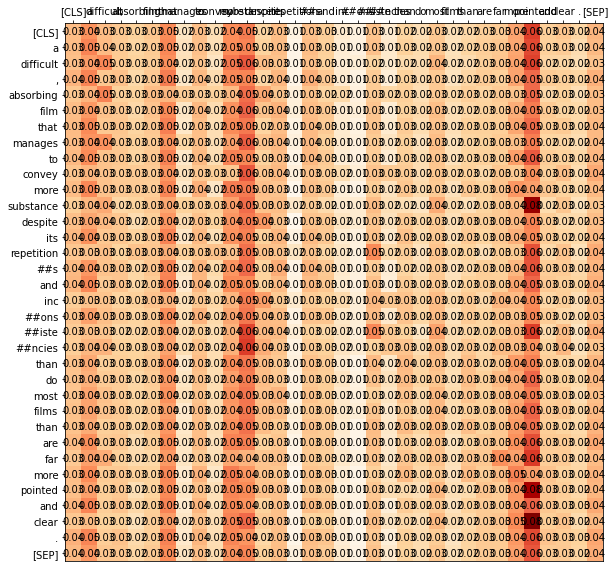

torch.Size([1, 1, 36, 36])
['block']
SST-2 seed_86 layer 1 head 0
Original Attention Across heads meaned


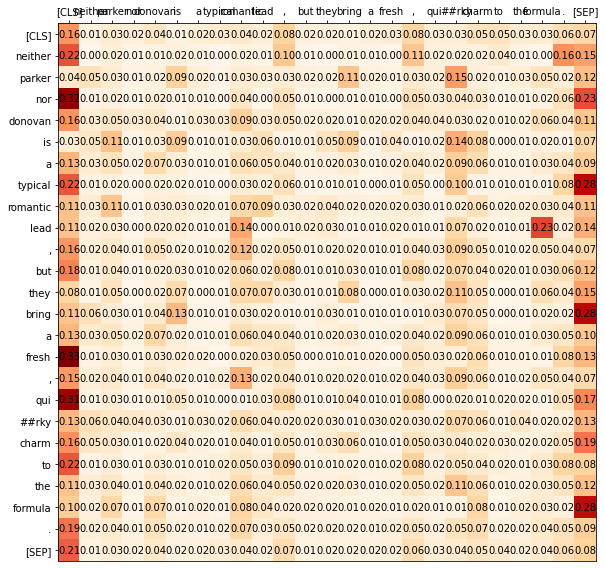

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_86 layer 1 head 1
Original Attention Across heads meaned


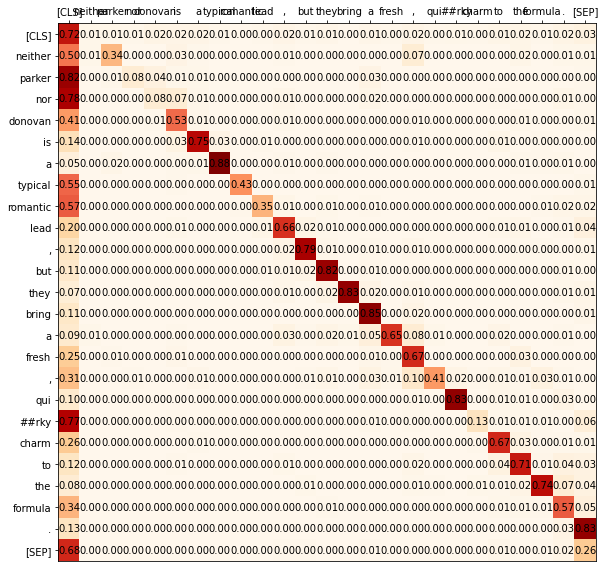

torch.Size([1, 1, 36, 36])
['diagonal']
SST-2 seed_86 layer 2 head 0
Original Attention Across heads meaned


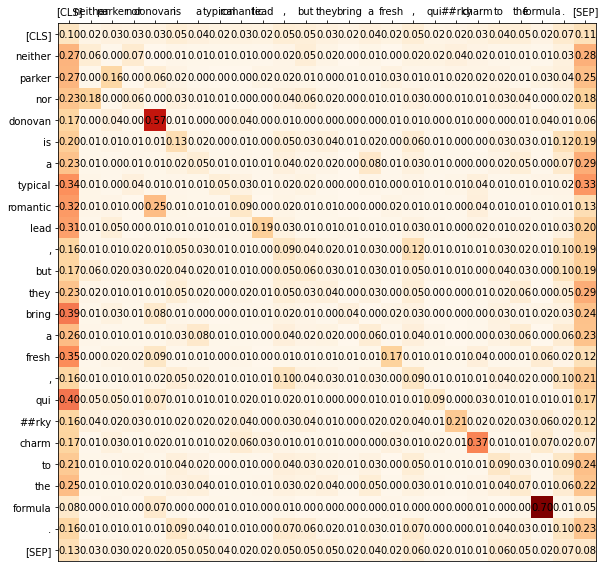

torch.Size([1, 1, 36, 36])
['mix']
SST-2 seed_86 layer 3 head 0
Original Attention Across heads meaned


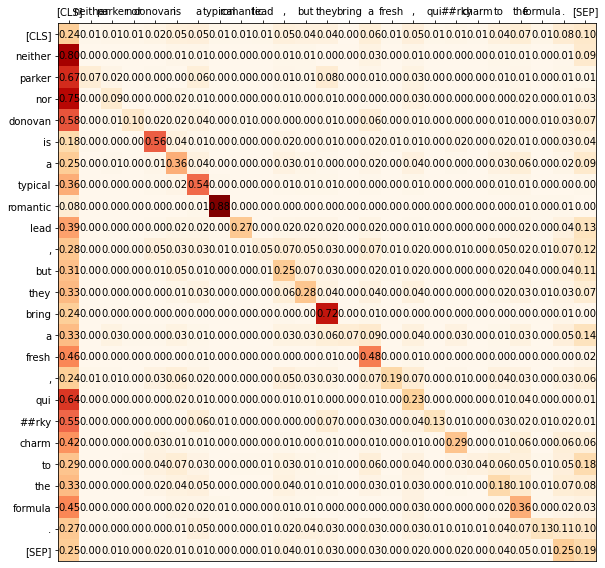

torch.Size([1, 1, 36, 36])
['diagonal']
SST-2 seed_86 layer 4 head 0
Original Attention Across heads meaned


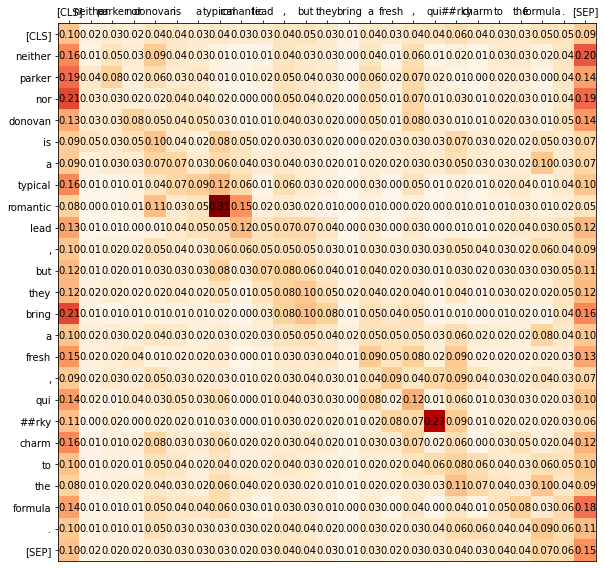

torch.Size([1, 1, 36, 36])
['mix']
SST-2 seed_86 layer 5 head 0
Original Attention Across heads meaned


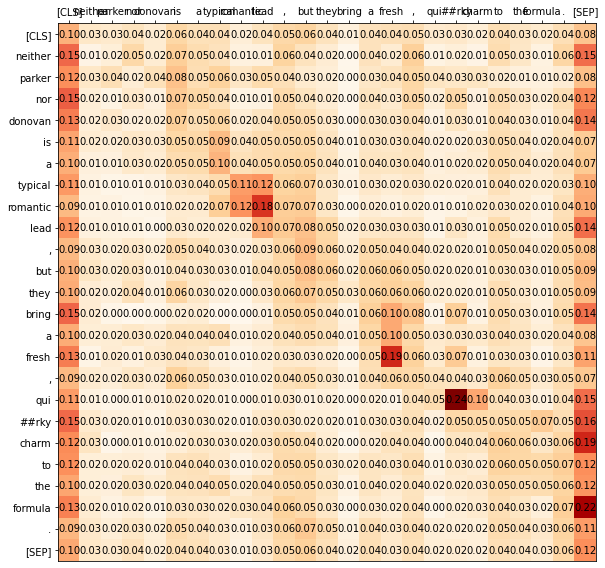

torch.Size([1, 1, 36, 36])
['mix']
SST-2 seed_86 layer 5 head 1
Original Attention Across heads meaned


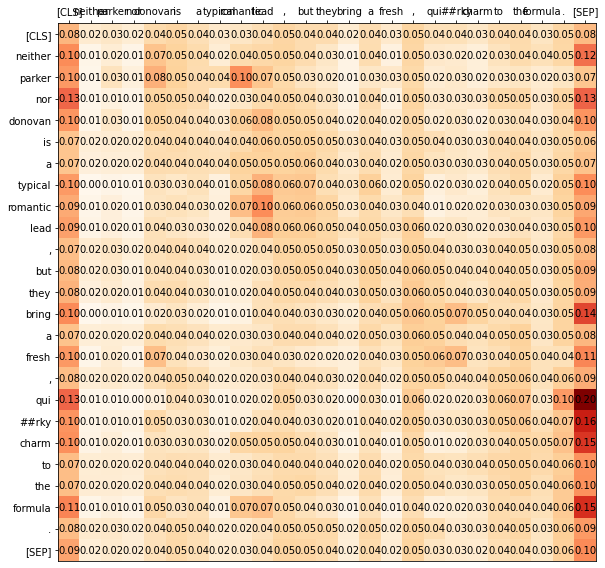

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_86 layer 6 head 0
Original Attention Across heads meaned


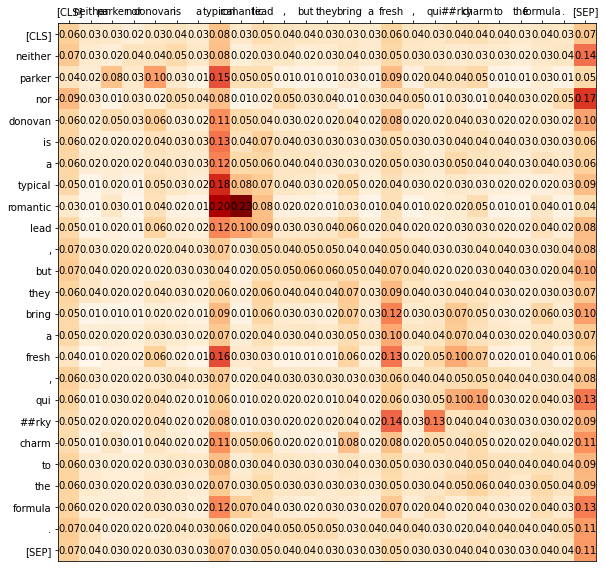

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_86 layer 7 head 0
Original Attention Across heads meaned


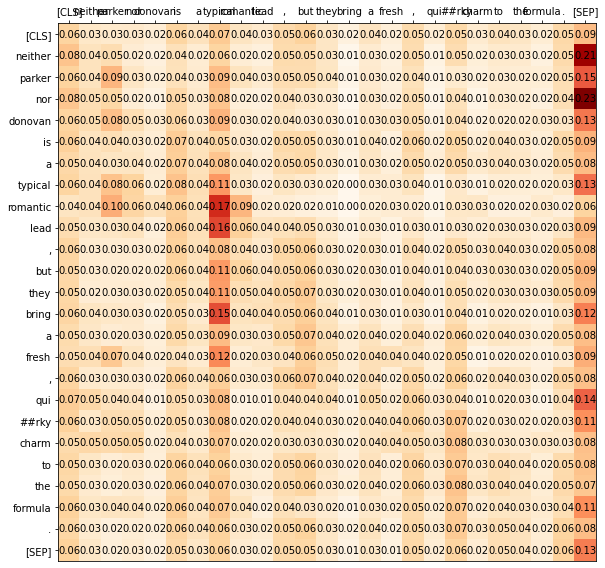

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_86 layer 7 head 1
Original Attention Across heads meaned


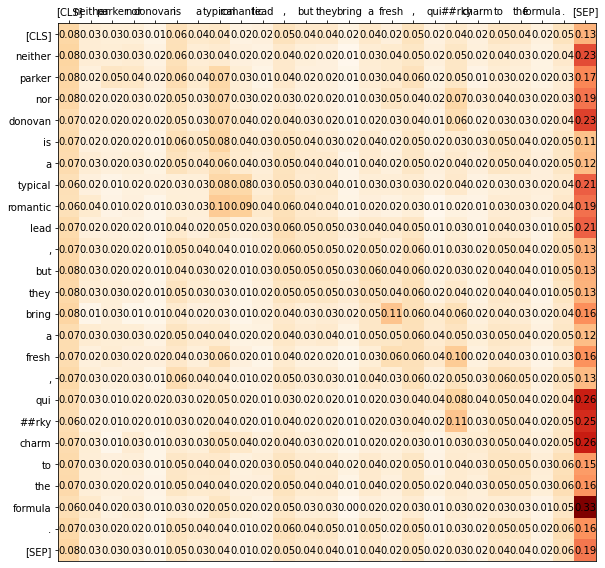

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_86 layer 7 head 2
Original Attention Across heads meaned


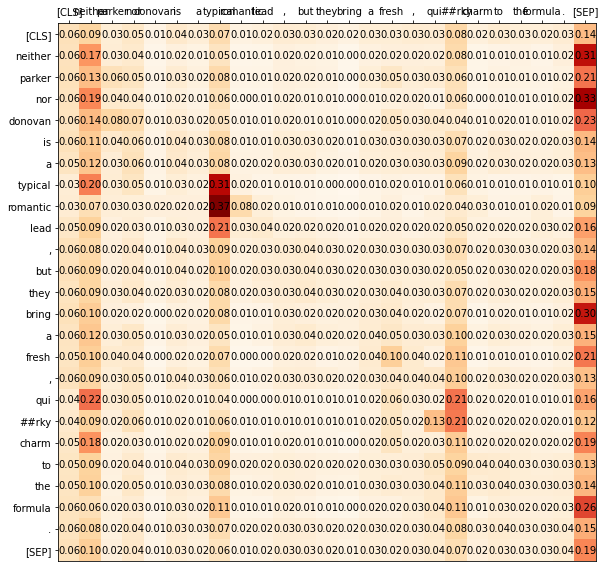

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_86 layer 7 head 3
Original Attention Across heads meaned


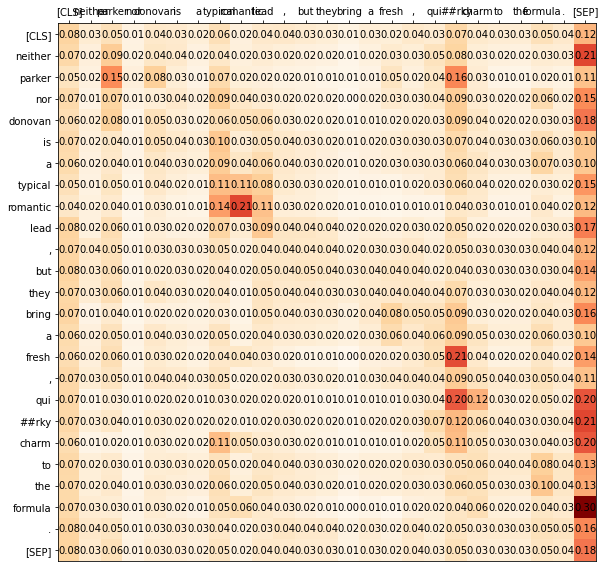

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_86 layer 8 head 0
Original Attention Across heads meaned


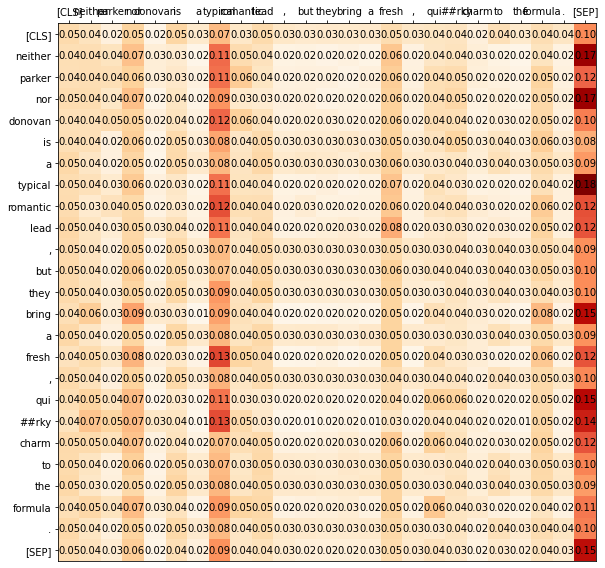

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_86 layer 8 head 1
Original Attention Across heads meaned


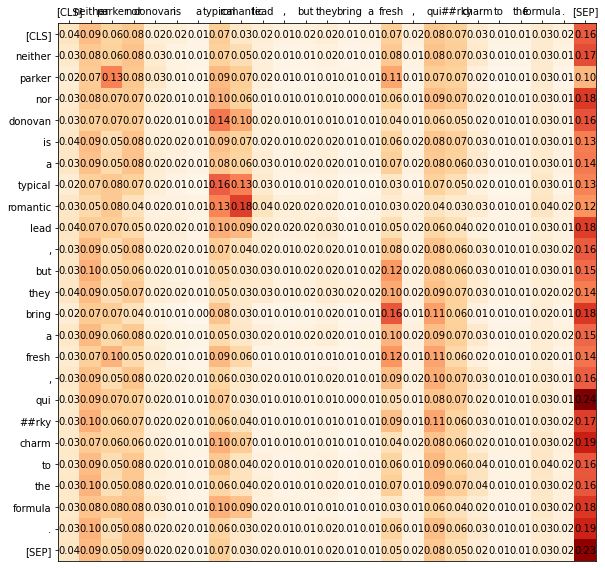

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_86 layer 9 head 0
Original Attention Across heads meaned


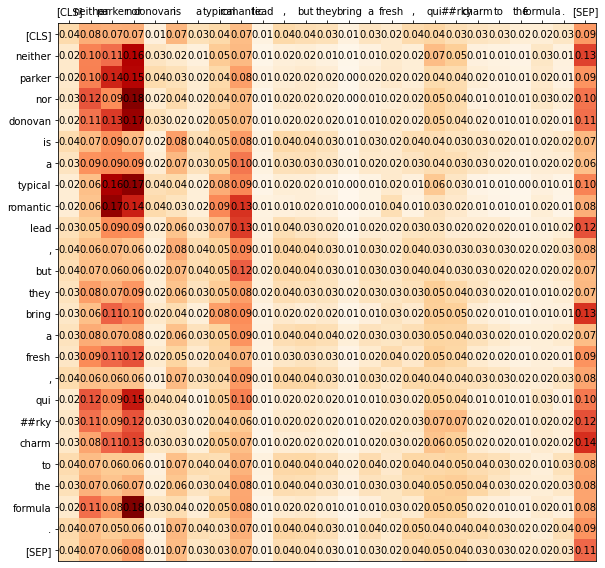

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_86 layer 9 head 1
Original Attention Across heads meaned


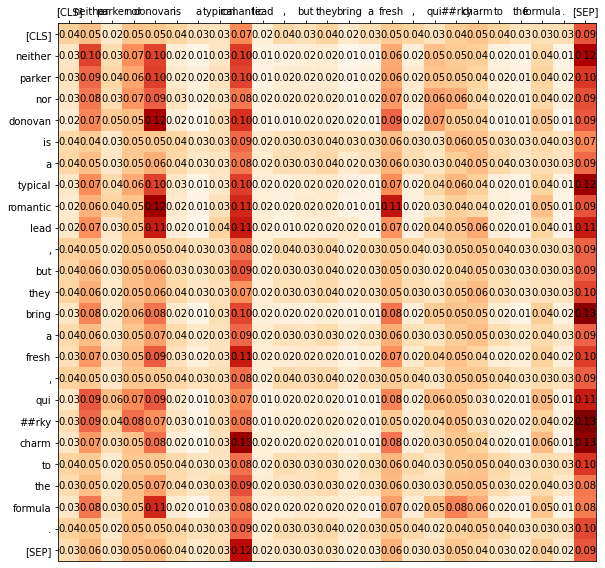

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_86 layer 10 head 0
Original Attention Across heads meaned


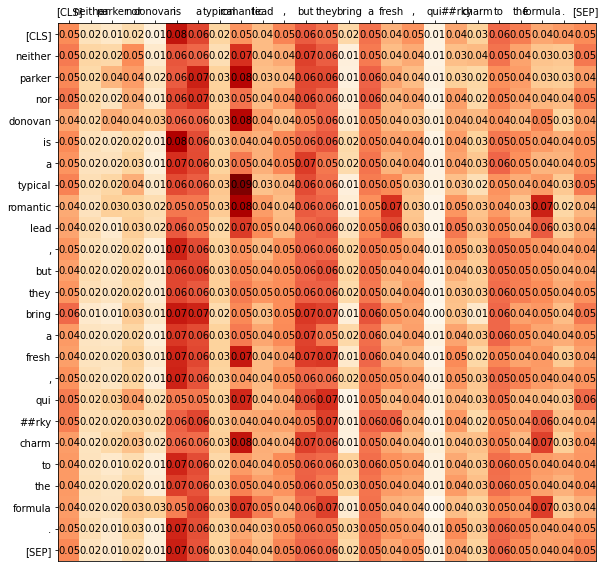

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_86 layer 10 head 1
Original Attention Across heads meaned


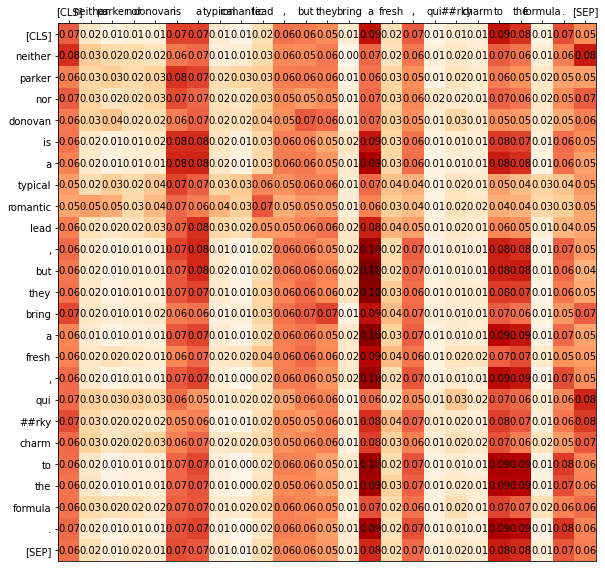

torch.Size([1, 1, 36, 36])
['other']
SST-2 seed_86 layer 11 head 0
Original Attention Across heads meaned


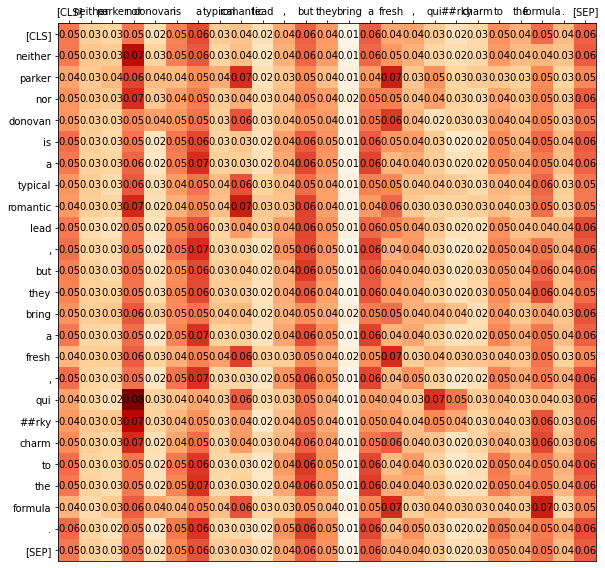

torch.Size([1, 1, 36, 36])
['other']


KeyboardInterrupt: 

In [13]:
set_seed(1337)
for task in ["CoLA", "SST-2", "MRPC", "STS-B", "QQP", "MNLI", "QNLI", "RTE"]:
    for seed in ["seed_1337", "seed_42", "seed_86", "seed_71", "seed_166"]:
        #Load Model
        model_path = f"../models/finetuned/{task}/{seed}/"
        tokenizer = BertTokenizer.from_pretrained(model_path)
        config = BertConfig.from_pretrained(model_path)
        config.output_attentions = True
        transformer_model = BertForSequenceClassification.from_pretrained(model_path,  config=config)
        # Prune
        mask_path = f"../masks/heads_mlps_super/{task}/{seed}/"
        head_mask = np.load(f"{mask_path}/head_mask.npy")
        mlp_mask = np.load(f"{mask_path}/mlp_mask.npy")
        head_mask = torch.from_numpy(head_mask)
        heads_to_prune = {} 
        for layer in range(len(head_mask)):
            heads_to_mask = [h[0] for h in (1 - head_mask[layer].long()).nonzero().tolist()]
            heads_to_prune[layer] = heads_to_mask
        mlps_to_prune = [h[0] for h in (1 - torch.from_numpy(mlp_mask).long()).nonzero().tolist()]

        transformer_model.prune_heads(heads_to_prune)
        transformer_model.prune_mlps(mlps_to_prune)
        transformer_model = transformer_model.eval()
        transformer_model.cuda()
        args = Namespace(data_dir=f"../data/glue/{task}/", local_rank=-1, 
                         model_name_or_path=model_path, 
                         overwrite_cache=False, model_type="bert", max_seq_length=128)
        eval_dataset = load_and_cache_examples(args, task.lower(), tokenizer, evaluate=True)
        eval_sampler = RandomSampler(eval_dataset)
        eval_dataloader = DataLoader(eval_dataset, sampler=eval_sampler, batch_size=1)

        k = 0
        for batch in eval_dataloader:
            batch = tuple(t.to("cuda:0") for t in batch)
            input_data =  {"input_ids": batch[0], "attention_mask": batch[1], "labels": batch[3]}
            n_tokens = batch[1].sum()
            if n_tokens < min_max_size[0]:
                continue
            subwords = tokenizer.convert_ids_to_tokens([int(t.item()) for t in batch[0][0]][:n_tokens])
            with torch.no_grad():
                _, _, attentions, allalpha_f, attention_mask = transformer_model(**input_data)
                head_attentions = None
                for layer in range(len(allalpha_f)):
                    if allalpha_f[layer] is None:
                        continue
                    for head in range(attentions[layer].size(1)):
#                         normed_alpha_f = allalpha_f[layer][:,head].norm(dim=-1)
#                         weight_normed_atttention = (normed_alpha_f+attention_mask).softmax(dim=-1)
                        print(task, seed, "layer", layer, "head", head)

                        print("Original Attention Across heads meaned")
                        attention = attentions[layer][:,head]
                        plot_matrix(attention[0, :n_tokens, :n_tokens].cpu().numpy(), subwords, subwords, None)
                        head_attentions = attention.unsqueeze(0)

#                         print("Weight Normed Attention")
#                         attention = weight_normed_atttention[0, 0, :n_tokens, :n_tokens].cpu().numpy()
#                         plot_matrix(attention, subwords, subwords, None)
#                         head_attentions = weight_normed_atttention.transpose(0, 1)


                        num_classifier_tokens = max(n_tokens, min_max_size[0]+20)
                        head_attentions = head_attentions[:, :, :num_classifier_tokens,:num_classifier_tokens].contiguous()
                        print(head_attentions.shape)
                        logits = head_classifier_model(head_attentions)
                        label_ids = torch.argmax(logits, dim=-1)
                        labels = [id2label[int(label_id.item())] for label_id in label_ids]
                        print(labels)
                    
                    
#                     if head_attentions == None:
#                         head_attentions = weight_normed_atttention
#                     else:
#                         head_attentions += weight_normed_atttention
#             head_attentions /= 12
            
            k += 1
            if k == 1:
                break

In [13]:
attention_mask.shape

torch.Size([1, 1, 1, 128])